<a href="https://colab.research.google.com/github/SalazarC42/Gatitosbonitos55/blob/main/MonthlyAnalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Index** 📑
1. Introduction & abbreviation meanings (Including variables)
2. Libraries
3. Customer Data analysis
4. Order analysis
5. Products & gender
6. Customer segmentation and classification
7. Maps & location insights from clients.
8. Checkout data

# **1. Introduction & abbreviation meanings (Including variables)**



*   **Data frame of Orders** = df_orders
*  **Data frame of Customers** = df_cx
*  **Data frame of Checkouts** = df_checkouts


# **2. Libraries**


In [ ]:
pip install gender-guesser

In [ ]:
pip install requests

In [ ]:
!pip install gender-guesser

In [ ]:
pip install pgeocode

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import copy

from scipy.stats import chisquare
import gender_guesser.detector as gender
import requests
import nltk
from nltk.corpus import names
import random

from scipy.stats import skew
import missingno as msno # to get visualization on missing values
import gspread_dataframe as gd
import pgeocode
import plotly.graph_objects as go
import plotly.express as px


## 2.1 Import Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


df_orders = pd.read_csv('/content/drive/MyDrive/Tintarella Data/orders_export_1.csv')
df_cx = pd.read_csv('/content/drive/MyDrive/Tintarella Data/customers_export.csv')
df_checkouts =  pd.read_csv('/content/drive/MyDrive/Tintarella Data/checkouts_export_1.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df_cx2 = df_cx.copy()
df_orders2 = df_orders.copy()

# **3. Customer Data Analysis**

## **3.1 Add Gender**

In [ ]:
def add_gender_column(df, name_column='First Name', gender_column='Gender'):
    """
    Adds a gender column to the DataFrame based on the names provided.

    Parameters:
    - df (pd.DataFrame): The input DataFrame containing names.
    - name_column (str): The name of the column in df that contains the names. Default is 'name'.
    - gender_column (str): The name of the new column to be added with gender information. Default is 'gender'.

    Returns:
    - pd.DataFrame: The DataFrame with an added gender column.
    """
    # Initialize the gender detector
    d = gender.Detector(case_sensitive=False)

    # Define a helper function to get gender for a single name
    def get_gender(name):
        if isinstance(name, str):
            return d.get_gender(name.split()[0])  # Use first name in case of full names
        else:
            return 'unknown'

    # Apply the helper function to the name column to create the gender column
    df[gender_column] = df[name_column].apply(get_gender)

    return df

In [ ]:
add_gender_column(df_cx)

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Gender
0,'6237948444924,jimena,ruiz,jimenaruizallende@gmail.com,yes,NaN,colina 84b,l,lomas de bezares,DF,MX,11910,'55 3706 9200,NaN,no,0.00,0,NaN,no,NaN,female
1,'6238253449468,Florencia,Bravo,ventas@tintarella.com.mx,no,NaN,Avenida Stim,"79, piso 3",Lomas del Chamizal,DF,MX,'05120,'+525535531203,NaN,no,0.00,0,NaN,no,NaN,female
2,'6241975927036,melissa,aguirre,sm_aguirre@hotmail.com,no,NaN,san luis 40,la primavera,culiacan,SIN,MX,80199,'667 751 4078,NaN,no,1563.00,1,NaN,no,NaN,female
3,'6242017050876,Maria,Ballesteros,ballesterosm96@gmail.com,yes,NaN,"305 Webster Ave, unit 407",unit 407,Cambridge,MA,US,'02141,'7735016690,NaN,no,0.00,0,NaN,no,NaN,female
4,'6242280276220,Paula,Puron,paulappt18@gmail.com,no,NaN,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,Puebla,PUE,MX,72813,'222 435 6943,NaN,no,693.60,1,NaN,no,NaN,female
5,'6242430648572,Paola,Medrano,paolamedranot@gmail.com,yes,NaN,"Bellavista,",bellavista,México,MEX,MX,54710,'55 2129 0514,NaN,no,0.00,0,NaN,no,NaN,female
6,'6243215474940,Roger,Jimenez,rogerjimro@hotmail.com,yes,NaN,Privada de la Cañada 30,402C,Huixquilucan,MEX,MX,52774,'55 1353 1995,NaN,no,653.60,1,NaN,no,NaN,male
7,'6247756857596,Gonzalo,Rodríguez,gonzalorz1985@gmail.com,yes,NaN,Damas 110,701,cdmx,DF,MX,'03900,'55 2899 8530,NaN,no,1265.20,1,NaN,no,NaN,male
8,'6248412905724,Maximo,Budib Hurle,maximo.1996@hotmail.com,yes,NaN,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,Puebla,PUE,MX,72130,'222 455 9706,NaN,no,1563.00,1,NaN,no,NaN,unknown
9,'6248970420476,Damian,Benfatto,damianbenfatto@gmail.com,no,NaN,Arquimedes 214,802,CDMX,DF,MX,11550,'+52 444 130 8931,'+524441308931,no,2563.30,1,NaN,no,NaN,male


In [ ]:
#Drop useless columns
df_cx.drop(columns=['Default Address Company'], inplace=True)
df_cx.drop(columns=['Default Address Phone'], inplace=True)
df_cx.drop(columns=['Phone'], inplace=True)
df_cx.drop(columns=['Accepts SMS Marketing'], inplace=True)
df_cx.drop(columns=['Note'], inplace=True)
df_cx.drop(columns=['Tax Exempt'], inplace=True)
df_cx.drop(columns=['Tags'], inplace=True)

In [ ]:
df_cx['Gender'].value_counts()

,count
Gender,
female,3031
male,2291
unknown,555
mostly_female,83
mostly_male,70
andy,15


In [ ]:
def gender_api_guess(name, api_key):
    url = f"https://gender-api.com/get?key={api_key}&name={name}"
    response = requests.get(url)
    data = response.json()
    return data.get('gender', 'Unknown')

# Example usage
api_key = 'ceaf7b036bb4878c78647362ba14c4176204856db095808c03160350f95ca9dc'
df_cx['Gender'] = df_cx.apply(
    lambda row: gender_api_guess(row['First Name'], api_key) if row['Gender'] == 'Unknown' else row['Gender'],
    axis=1
)


In [ ]:
df_cx['Gender'].value_counts()

,count
Gender,
female,3031
male,2291
unknown,555
mostly_female,83
mostly_male,70
andy,15


In [ ]:
# Filter the DataFrame to include only rows where the 'Gender' is 'andy'
andy_df = df_cx[df_cx['Gender'] == 'unknown']

# Display the filtered DataFrame
andy_df.head(40)

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Total Spent,Total Orders,Gender
8,'6248412905724,Maximo,Budib Hurle,maximo.1996@hotmail.com,yes,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,Puebla,PUE,MX,72130,1563.0,1,unknown
10,'6249060663548,Nacif,letayf Karen,karennacifl@hotmail.com,no,Carretera A La Flor 602 Torres Toscana,Departamento,Durango,DGO,MX,34185,2278.0,1,unknown
23,'6255806415100,Ethson,Hernández,bladimeneses25@hotmail.com,yes,Alfredo Mtz G Mz 2 LT 81,Casa,Ciudad de México,DF,MX,'09578,0.0,0,unknown
24,'6255818866940,Ethson,Hernández,NaN,no,Alfredo MTZ G MZ2 LT81,Casa,Ciudad de México,DF,MX,'09578,0.0,0,unknown
34,'6268180005116,zianya,martinez,zianya@tintarella.com.mx,yes,Lago andromaco 53,701c,Mexico,DF,MX,11529,0.0,0,unknown
45,'6272161939708,Perezanta,", Fernanda",fernanda.perezanta@gmail.com,no,Bosque de Abedules 54,Casa,Ciudad de México,DF,MX,11700,521.6,1,unknown
70,'6286326694140,Dennise,Crespo Smith,decres@gmail.com,yes,Cerrada de Sierra Vertientes 11,Lomas de Chapultepec,Ciudad de Mexico,DF,MX,11000,2328.0,1,unknown
76,'6293925691644,Marene,Huerta,marenehuerta@yahoo.com,yes,Fernando Alencastre 115,Departamemto 9,Ciudad de Mexico,DF,MX,11000,2005.2,1,unknown
84,'6295845765372,Dhehe,HeheeH,h@gmail.com,no,Boulevard Luis Donaldo Colosio 414,Nevado,Hermosillo,AGS,MX,83250,0.0,0,unknown
100,'6306563752188,Sevilla,Renee,rensevi@gmail.com,yes,Avenida Explanada 1175,Lomas de chapultepec,Ciudad De MÉxico,DF,MX,11000,0.0,0,unknown


In [ ]:
# Function to plot a boxplot and a histogram along the same scale

def histogram_boxplot(data, feature, figsize = (12, 7), kde = False, bins = None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows = 2,      # Number of rows of the subplot grid = 2
        sharex = True,  # x-axis will be shared among all subplots
        gridspec_kw = {"height_ratios": (0.25, 0.75)},
        figsize = figsize,
    )                   # Creating the 2 subplots
    sns.boxplot(
        data = data, x = feature, ax = ax_box2, showmeans = True, color = "violet"
    )                   # Boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data = data, x = feature, kde = kde, ax = ax_hist2, bins = bins, palette = "winter"
    ) if bins else sns.histplot(
        data = data, x = feature, kde = kde, ax = ax_hist2
    )                   # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color = "green", linestyle = "--"
    )                   # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color = "black", linestyle = "-"
    )                   # Add median to the histogram


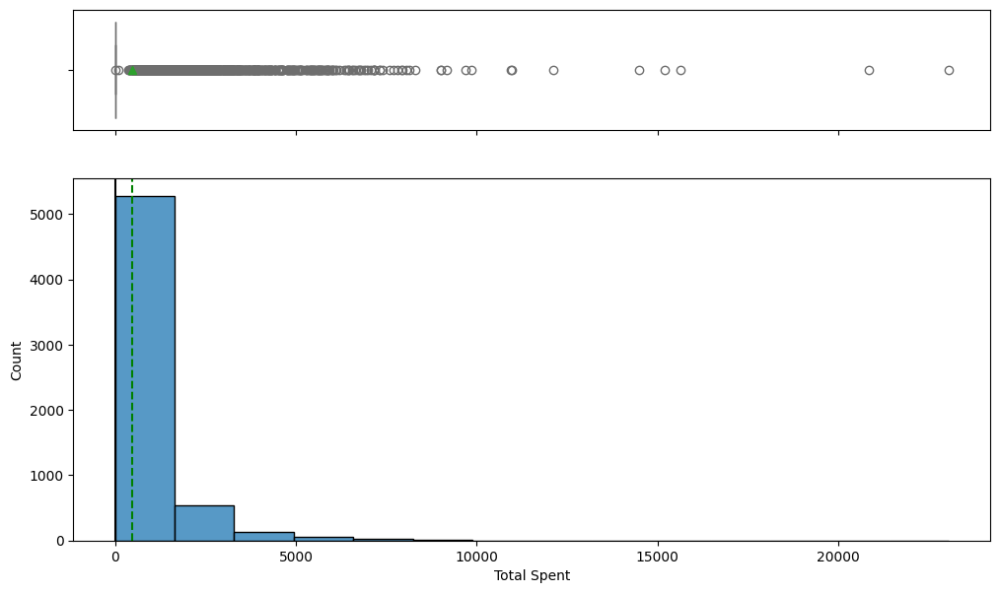

In [ ]:
histogram_boxplot(df_cx,'Total Spent')

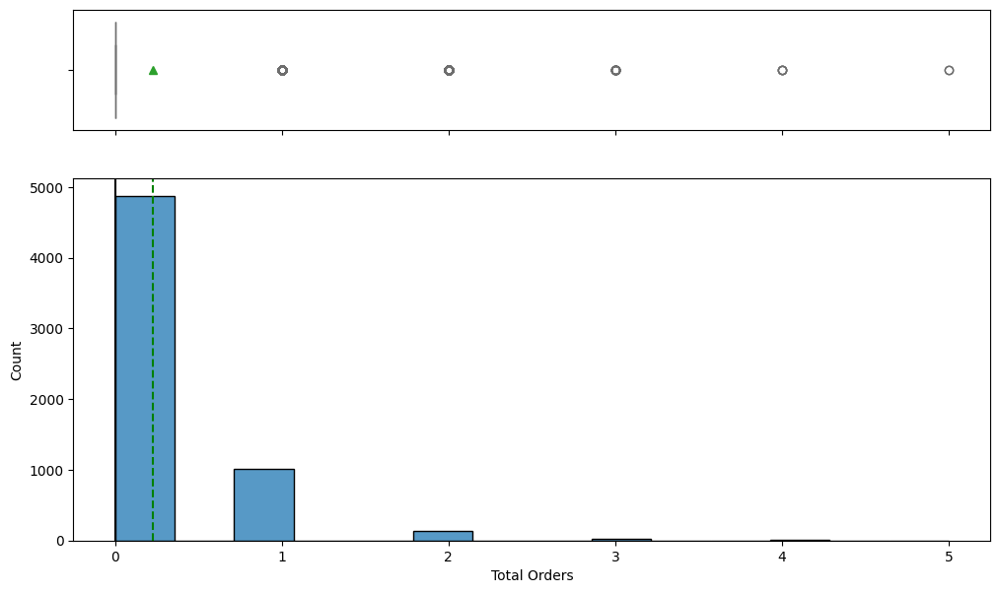

In [ ]:
histogram_boxplot(df_cx,'Total Orders')

In [ ]:
def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    Parameters:
    - data: DataFrame
    - feature: DataFrame column
    - perc: Whether to display percentages instead of count (default is False)
    - n: Displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # Total number of occurrences
    count = data[feature].nunique()  # Number of unique categories

    if n is None:
        n = count  # Default to show all categories if n is not specified
    order = data[feature].value_counts(ascending=False).index[:n]  # Top n categories

    fig, ax = plt.subplots(figsize=(max(n*1.5, 10), 8))  # Adjust figure size based on n
    sns.countplot(data=data, x=feature, palette="Paired", order=order, ax=ax)  # Plot

    for p in ax.patches:
        height = p.get_height()
        label = "{:.1f}%".format(100 * height / total) if perc else int(height)
        x = p.get_x() + p.get_width() / 2
        y = height + 0.01  # Slight offset above the bar

        ax.annotate(label, (x, y), ha='center', va='bottom', fontsize=12, color='black')

    plt.xticks(rotation=90, fontsize=15)
    plt.title(f'Distribution of {feature}')  # Optional title
    plt.show()

In [ ]:
def labeled_barplot_top10(data, feature, perc=False):
    """
    Barplot showing the top 5 most frequent categories with labels.

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of counts (default is False)
    """
    total = len(data[feature])  # Length of the column

    # Get the top 5 categories by count
    top_5 = data[feature].value_counts().nlargest(10)

    plt.figure(figsize=(6, 5))
    plt.xticks(rotation=90, fontsize=12)

    ax = sns.barplot(
        x=top_5.index,
        y=top_5.values,
        palette="Paired",
    )

    for p in ax.patches:
        if perc:
            label = "{:.1f}%".format(100 * p.get_height() / total)
        else:
            label = p.get_height()

        x = p.get_x() + p.get_width() / 2
        y = p.get_height()

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )

    plt.show()  # Show the plot

# This function will now always display the top 5 categories by count.

## **3.2 Total Orders**

<ipython-input-517-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




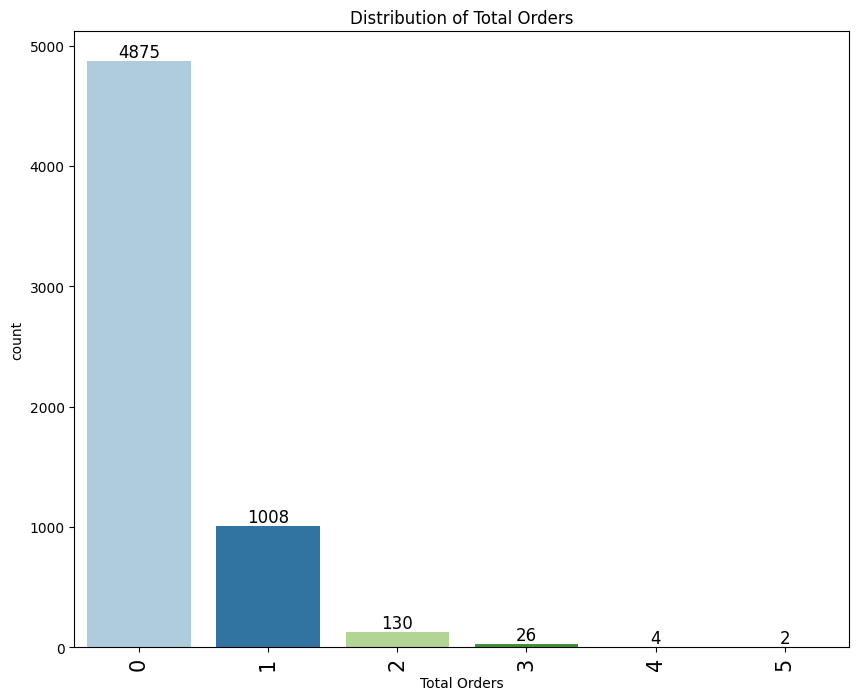

In [ ]:
labeled_barplot(df_cx, 'Total Orders')

## **Gender of customers with 1 or more orders**

<ipython-input-517-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




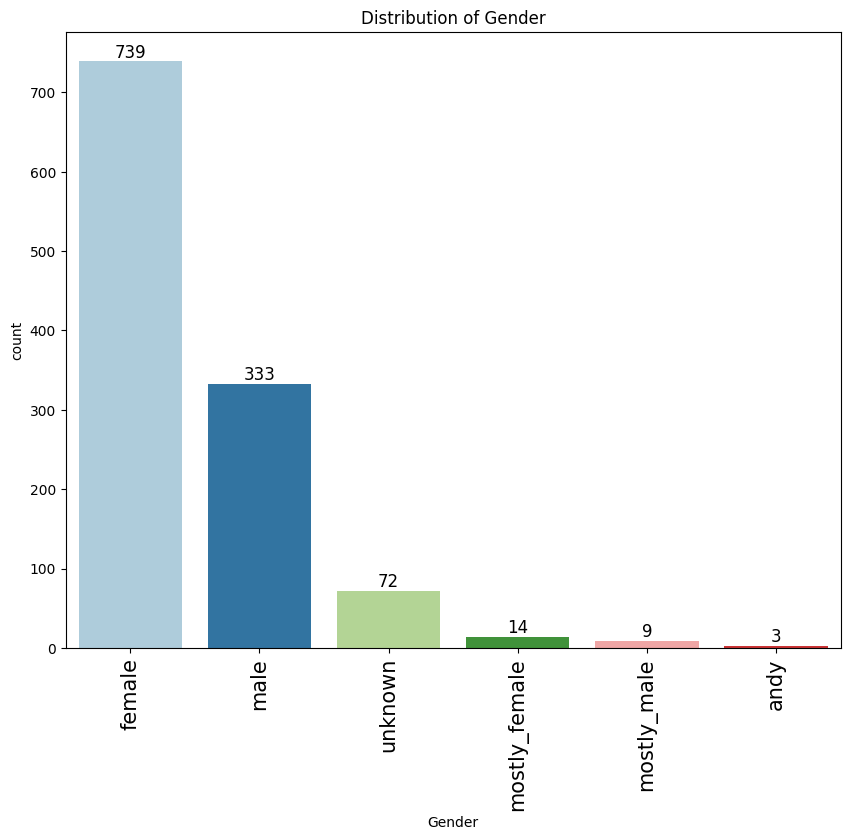

In [ ]:

ordersGender_df = df_cx[df_cx['Total Orders'] >= 1]

labeled_barplot(ordersGender_df, 'Gender')

## **Gender of customers with 0 orders**

<ipython-input-517-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




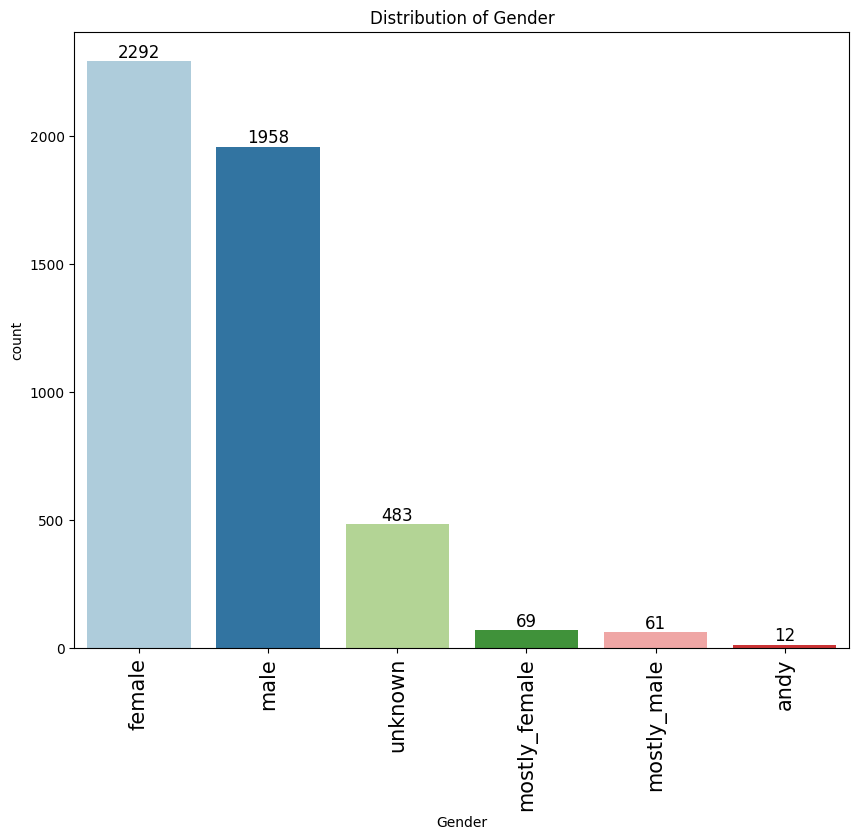

In [ ]:
ordersGender1_df = df_cx[df_cx['Total Orders'] == 0]

labeled_barplot(ordersGender1_df, 'Gender')

## **Gender of people who spent more than 5000 over time**

<ipython-input-517-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




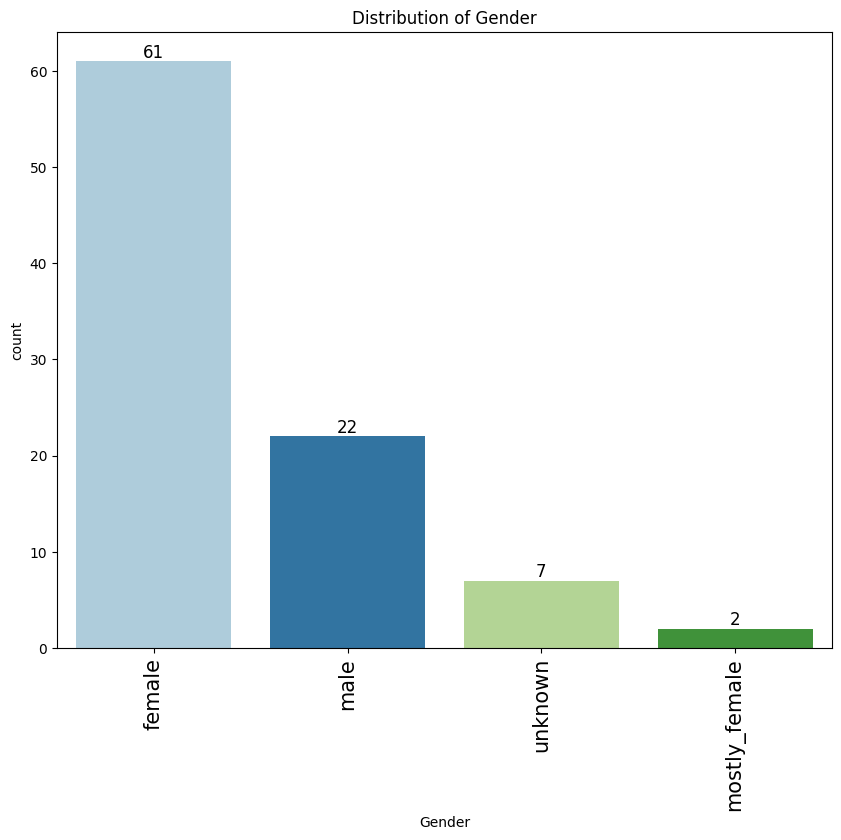

In [ ]:
ordersGender2_df = df_cx[df_cx['Total Spent'] >= 5000]

labeled_barplot(ordersGender2_df, 'Gender')

## **Top 10 Default Adress Province Code with at least 1 order**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




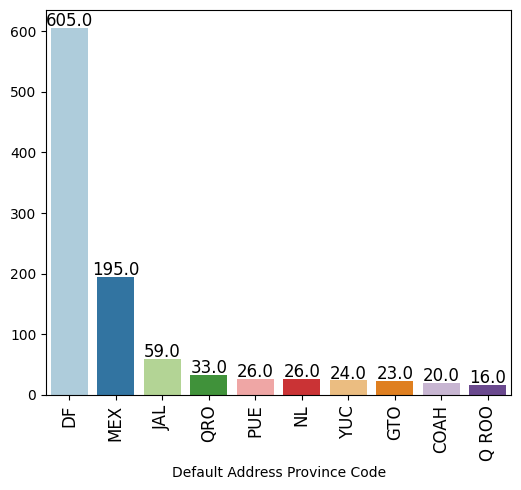

In [ ]:
ordersGender3_df = df_cx[df_cx['Total Orders'] >= 1]
labeled_barplot_top10(ordersGender3_df, 'Default Address Province Code')

## **Top 10 cities were the customers have spent the most**

<ipython-input-524-96f14ec3770b>:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-524-96f14ec3770b>:10: UserWarning:

FixedFormatter should only be used together with FixedLocator



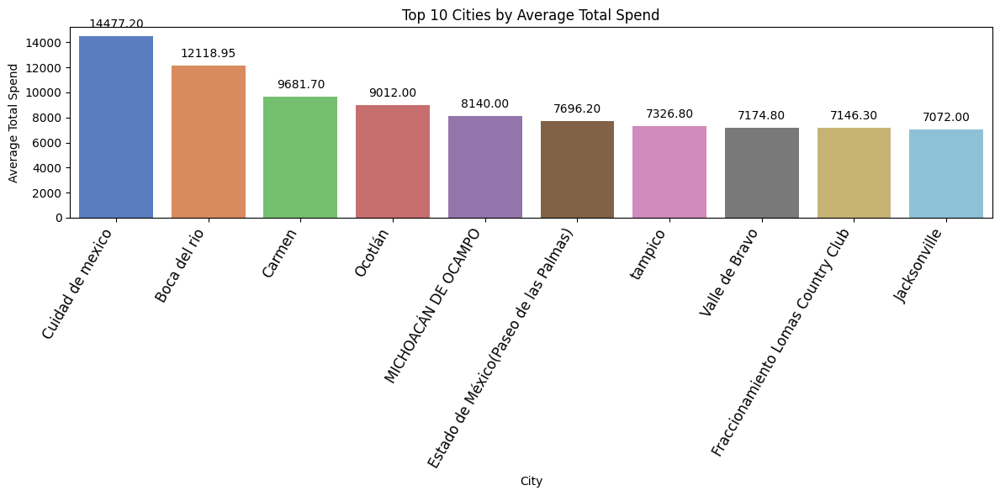

In [ ]:
# Step 1: Aggregate data and select top 10 cities
top_10_cities = df_cx.groupby('Default Address City')['Total Spent'].mean().reset_index()
top_10_cities = top_10_cities.nlargest(10, 'Total Spent')  # Select top 10 cities based on average spend

# Step 2: Plotting
fig, ax = plt.subplots(figsize=(12, 6))  # Increased figure width
sns.barplot(x='Default Address City', y='Total Spent', data=top_10_cities, palette='muted', ax=ax)

# Increase font size of city names and rotate further
ax.set_xticklabels(ax.get_xticklabels(), fontsize=12, rotation=60, horizontalalignment='right')

# Add value labels on the bars
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.2f'),  # Format the value label
                (p.get_x() + p.get_width() / 2, p.get_height()),
                ha = 'center',
                va = 'bottom',
                xytext = (0, 5),  # Offset text
                textcoords = 'offset points'
               )

plt.title('Top 10 Cities by Average Total Spend')
plt.xlabel('City')
plt.ylabel('Average Total Spend')
plt.tight_layout()  # Adjust layout to prevent labels from being cut off
plt.show()

## **Default Address Country Code**

<ipython-input-517-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




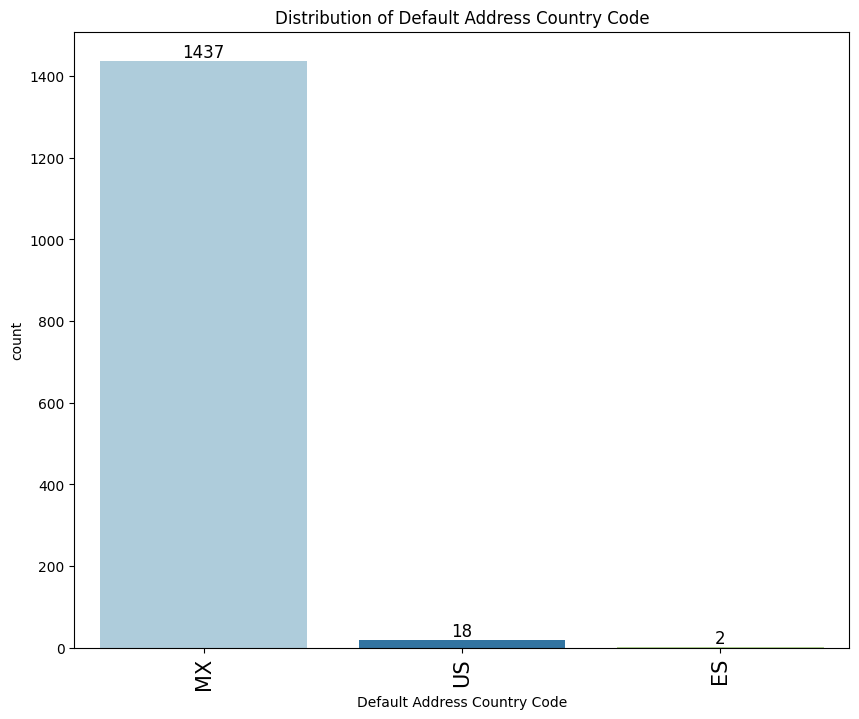

In [ ]:
labeled_barplot(df_cx, 'Default Address Country Code')

## **Default Address City**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




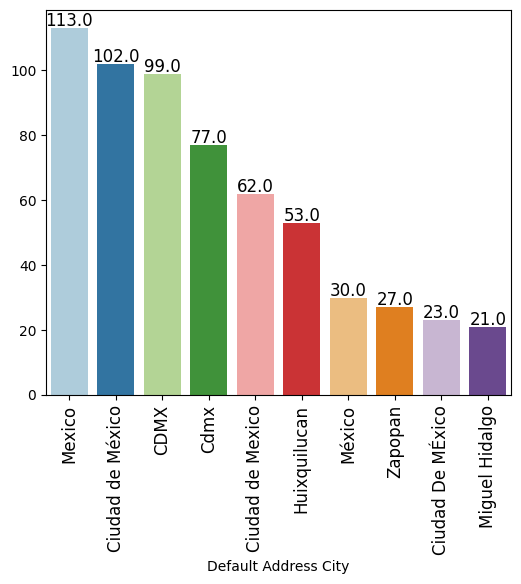

In [ ]:
labeled_barplot_top10(df_cx, 'Default Address City')

##Customer Deep Analysis

#### Duplicates

In [ ]:
# Checking for duplicated rows
df_cx2.duplicated().sum()

0

**Observations:** There seem to be no duplicated rows in the data. However since this is a filled out by customers, there is a chance that some customers created the same profile once or twice. This can be checked using

- Same First and Last name
- Default Address Phone
- Default Address Address1

since these need to be the same. EMail could also be used, however most customers may have 2 or more eMails to create multiple accounts

In [ ]:
# Importing library to remove special characters form names
import unicodedata

def normalize_text(text):
    # Normalize text by removing accents and special characters
    if isinstance(text, str):
        text = unicodedata.normalize('NFKD', text).encode('ASCII', 'ignore').decode('utf-8')
    return text

# Apply normalization to the 'First Name' and 'Last Name' columns
df_cx2['Normalized First Name'] = df_cx2['First Name'].apply(normalize_text)
df_cx2['Normalized Last Name'] = df_cx2['Last Name'].apply(normalize_text)


In [ ]:
# Filtering for duplicates where both 'First Name' and 'Last Name' are the same
duplicated_names = df_cx2[df_cx2.duplicated(subset=['Normalized First Name', 'Normalized Last Name'], keep=False) &
                                  df_cx2['Normalized First Name'].notna() &
                                  df_cx2['Normalized Last Name'].notna()]
duplicated_names.shape


(253, 22)

**Observations:** There are 263 duplicated names. The individual grouping was done on a seperate sheet for cleanliness: [click here](https://docs.google.com/document/d/1ve1A8s1pDZDoo2sg-Bue54-iw3MMvUgBgkVdqsa3mGQ/edit).

We can assume that these are the same customers. However, in many instances, the repetition of name may be a mere coincidence if no other information is present. In case both name and address match, we can assume that this is yet the same person. Yet there is also the possibility that the two live in the same household (perhaps mother and daughther, where the daughter used the mother's information to create another account). The likelihood of a match between name and address being the same person is very high, yet we will **keep all of these in the dataset during the analysis.**  

In [ ]:
# Filtering Duplicates for first and Last Name sorted by first name
pd.set_option('display.max_rows', None)
duplicated_names_sorted = duplicated_names.sort_values(by='Normalized First Name')
duplicated_names_sorted

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Normalized First Name,Normalized Last Name
1841,'7484332179708,ANDRES,MARTINEZ,anduve.090@gmail.coom,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,ANDRES,MARTINEZ
1840,'7484332114172,ANDRES,MARTINEZ,anduve.090@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,ANDRES,MARTINEZ
1405,'7484312813820,Abigail,Campos,abicj@hotmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Abigail,Campos
1058,'6951496745212,Abigail,Campos,abicj@hormail.com,yes,NaN,"Ejército nacional 225, Hares Polanco, Torre 1,...","Miguel Hidalgo, Anahuac","Polanco, Ciudad de México",DF,MX,11320,'55 8768 6737,NaN,no,3178.10,1,NaN,no,NaN,Abigail,Campos
1441,'7484314288380,Adriana,Marin,adriana.marin@senergyc.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Adriana,Marin
1455,'7484314976508,Adriana,Fernandez,adrifer81@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Adriana,Fernandez
1456,'7484315009276,Adriana,Fernandez,adrifercas@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Adriana,Fernandez
1440,'7484314255612,Adriana,Marin,adriana.marin@senergy.com,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Adriana,Marin
1939,'7484336931068,Alberto,Romero Ledezma,aromld@hotmai.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Alberto,Romero Ledezma
1940,'7484336963836,Alberto,Romero Ledezma,aromld@hotmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,no,0.00,0,NaN,no,NaN,Alberto,Romero Ledezma


In [ ]:
# Filtering for duplicates using Default Address Phone
duplicated_phone = df_cx2[df_cx2.duplicated(subset='Default Address Phone', keep=False)& df_cx2['Default Address Phone'].notna()]
duplicated_phone.shape

(41, 22)

**Observations:** Checking for duplicates using Address and Phone both indicate 41 duplicates. These will be visualized for further analysis below:

In [ ]:
# Sorting duplicated phones by phone for easier visualization
duplicated_phone_sorted = duplicated_phone.sort_values(by='Default Address Phone')
duplicated_phone_sorted

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Normalized First Name,Normalized Last Name
80,'6294860267772,Christine,Muldoon,christinemuldoon16@gmail.com,no,NaN,4611 Windsor Ridge Drive,0,Irving,TX,US,75038,'(972) 839-9261,NaN,no,4203.40,1,NaN,no,newsletter,Christine,Muldoon
823,'6820176822524,Christine,Muldoon,grisham.christine@gmail.com,yes,NaN,4611 Windsor Ridge Dr,no aplica,Irving,TX,US,75038,'(972) 839-9261,NaN,no,3821.10,1,NaN,no,NaN,Christine,Muldoon
78,'6294364455164,Mariana,Miranda,NaN,no,NaN,Fuente de las piramides 271,302,Naucalpan,MEX,MX,53950,'+52 55 3734 0065,'+525537340065,no,0.00,0,NaN,no,NaN,Mariana,Miranda
79,'6294370975996,Mariana,Miranda,mariana.mirandam@hotmail.com,no,NaN,Fuente de las piramides 271,302,Naucalpan,MEX,MX,53950,'+52 55 3734 0065,NaN,no,2095.20,1,NaN,no,NaN,Mariana,Miranda
562,'6638269366524,laurent,plusquellec,anais_calderon@hotmail.com,no,NaN,Camino al alazan 346,San Martin del tajo,Tlajomulco de zuñiga,JAL,MX,45643,'33 3581 4083,NaN,no,3015.60,1,NaN,no,Loox - Post-purchase Advocate,laurent,plusquellec
662,'6718461706492,ANAIS,CALDERON,plusq.anais@gmail.com,yes,NaN,CAMINO AL ALAZAN 346,SAN MARTIN DEL TAJO,TLAJOMULCO DE ZUÑIGA,JAL,MX,45643,'33 3581 4083,NaN,no,1284.84,1,NaN,no,NaN,ANAIS,CALDERON
744,'6765852918012,Marcela,Bonilla,marcebonilla@gmail.com,yes,NaN,Av del Bosque 19,Col Del Valle,Querétaro,QRO,MX,76190,'442 263 3975,NaN,no,3395.75,1,NaN,no,NaN,Marcela,Bonilla
762,'6771554582780,Marcela,Bonilla,marcela_bonilla@hotmail.com,yes,NaN,Av del Bosque,19,Querétaro,QRO,MX,76190,'442 263 3975,NaN,no,99.00,1,NaN,no,Loox - Post-purchase Advocate,Marcela,Bonilla
1070,'6973001564412,Sergio,Ceja Avalos,serchoavalos@gmail.com,yes,NaN,Austria 91,Tres De Agosto,Morelia,MICH,MX,58128,'443 395 9215,NaN,no,3897.20,1,NaN,no,NaN,Sergio,Ceja Avalos
1044,'6900948959484,Sergio,Ceja Avalos,checovalosmx@gmail.com,no,NaN,Austria 91,Tres de Agosto,Morelia,MICH,MX,58128,'443 395 9215,NaN,no,0.00,0,NaN,no,NaN,Sergio,Ceja Avalos


**Observations:**

Index:
- 80+823 (both have order value - merge)
- 78+79 (only 79 has order value)
- 562+662 (Different Names, same address = Family,  both have order value)
- 744+762 (both have order value - merge)
- 1070+1044 (only 1070 has order value)
- 218+375 (both have order value - merge)
- 304+305 (only 304 has order value)
- 589+863 (both have order value - merge)
- 679+951 (both have order value - merge)
- 0 + 474 (owner - delete)
- 297+416 (both have order value - merge)
- 1091+424+1092 (three have order value - merge)
- 588 + 216 (both have order value - merge)
- 1179+399 (both have order value - merge)
- 311 + 459 (none have order value)
- 1316+1317 (Different Names, same address = Family,  both have order value)
- 223+222 (only 223 has order value)
- 727+726 (both have order value - merge)
- 977+976 (only 979 has order value, 977 seems to be typo in eMail)
- 1320+5929  (Different Names, same address = Family,  both have order value)


In [ ]:
# Filtering for duplicates using Default Address Address1
duplicated_address = df_cx2[df_cx2.duplicated(subset='Default Address Address1', keep=False)& df_cx2['Default Address Address1'].notna()]
duplicated_address.shape

(39, 22)

In [ ]:
# Sorting by same address for duplicates. There may be rows where the same address belongs to two differnt people of the same household
duplicated_address_sorted = duplicated_address.sort_values(by='Default Address Address1')
duplicated_address_sorted

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Normalized First Name,Normalized Last Name
1044,'6900948959484,Sergio,Ceja Avalos,checovalosmx@gmail.com,no,NaN,Austria 91,Tres de Agosto,Morelia,MICH,MX,58128,'443 395 9215,NaN,no,0.00,0,NaN,no,NaN,Sergio,Ceja Avalos
1070,'6973001564412,Sergio,Ceja Avalos,serchoavalos@gmail.com,yes,NaN,Austria 91,Tres De Agosto,Morelia,MICH,MX,58128,'443 395 9215,NaN,no,3897.20,1,NaN,no,NaN,Sergio,Ceja Avalos
679,'6725905514748,veronica,descamps,aesquivar@gmail.com,yes,NaN,"Av Vasco de quiroga 3833 torre abetos 601, San...",Santa fe,Mexico,DF,MX,'01210,'55 3306 7488,NaN,no,897.00,1,NaN,no,Loox - Post-purchase Advocate,veronica,descamps
951,'6854173425916,veronica,descamps,veronica.descamps@gmail.com,yes,NaN,"Av Vasco de quiroga 3833 torre abetos 601, San...",Santa fe,Mexico,DF,MX,'01210,'55 3306 7488,NaN,no,2028.15,1,NaN,no,NaN,veronica,descamps
6030,'7612743123196,Priscila,Gómez,lilodomit@gmail.com,no,NaN,Av corregidores 1530,Int 1,CDMX,DF,MX,11000,'5518498889,NaN,no,2858.00,1,NaN,no,NaN,Priscila,Gomez
6025,'7611815395580,Priscila,Gomez Martínez del Río,pri.delrio@hotmail.com,yes,NaN,Av corregidores 1530,Depto 7,Miguel Hidalgo,DF,MX,11000,'+525566301252,NaN,no,1752.50,1,NaN,no,"Loox - Post purchase Advocate, Newmail, shopif...",Priscila,Gomez Martinez del Rio
1357,'7475334316284,Veronica,Licona,vlicona@hotmail.com,yes,NaN,Av de los Poetas 100,Cañada Depto PG03A Cumbres de Santa Fe,Cuajimalpa de Morelos,DF,MX,'05600,'+525552827049,NaN,no,2964.80,2,NaN,no,NaN,Veronica,Licona
208,'6381519241468,Florencia,Zorrilla,zorrillaflorencia@gmail.com,yes,NaN,Av de los Poetas 100,"Encinos 3 casa 16, San Mateo Tlalte",Mexico City,DF,MX,'05600,'55 5456 1277,NaN,no,1732.40,1,NaN,no,NaN,Florencia,Zorrilla
740,'6765030047996,Alejandra,San Roman,alesanroman7@gmail.com,yes,NaN,Bosque de Canelos 73,Colonia Bosque de las Lomas,Ciudad de México,DF,MX,'05120,'55 5508 3490,NaN,no,0.00,0,NaN,no,NaN,Alejandra,San Roman
1139,'7078328860924,Daniela,Rivera Rio,danyrrandrade@hotmail.com,yes,NaN,Bosque de Canelos 73,701,Mexico,DF,MX,'05120,'5541357170,NaN,no,813.50,1,NaN,no,NaN,Daniela,Rivera Rio


In [ ]:
# Filtering for duplicates using eMails
duplicated_email = df_cx2[df_cx2.duplicated(subset='Email', keep=False)& df_cx2['Email'].notna()]
duplicated_email.shape

(0, 22)

**Observations:** There are no duplicated eMails in the dataset

#### Missing Values


In [ ]:
# Extracting an exact count of the missing values observed above
df_cx2.isnull().sum()

,0
Customer ID,0
First Name,54
Last Name,170
Email,18
Accepts Email Marketing,0
Default Address Company,6036
Default Address Address1,4652
Default Address Address2,4664
Default Address City,4653
Default Address Province Code,4655


In [ ]:
# Obtaining percentage of missing values
perc_missing_values = (df_cx2.isnull().sum() / len(df_cx2)) * 100
perc_missing_values

,0
Customer ID,0.000000
First Name,0.893300
Last Name,2.812242
Email,0.297767
Accepts Email Marketing,0.000000
Default Address Company,99.851117
Default Address Address1,76.956162
Default Address Address2,77.154673
Default Address City,76.972705
Default Address Province Code,77.005790


**Observations:**

There are 75 - 99% missing values for Addresses of customers. This is due to the creating of the file. Many customer profiles were imported without this information, the rows that do have this information were directly generated on Shopify. It may be considere to seperate the data file into two different dataframes, customers with and without address information.

In [ ]:
# Visualizing rows with no First names
no_first_name = df_cx2[df_cx2['First Name'].isnull()]
no_first_name

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Normalized First Name,Normalized Last Name
162,'6346333880572,NaN,NaN,ivbb24@hotmail.com,no,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
163,'6348230557948,NaN,NaN,akarras79@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
254,'6403656581372,NaN,NaN,asrclientes@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
275,'6429185736956,NaN,NaN,victoriagarcia@putlook.com.ar,no,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
276,'6429186097404,NaN,NaN,victoriagarcia@outlook.com.ar,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
282,'6434582692092,NaN,NaN,astra-cornelio@hotmail.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
306,'6456292737276,NaN,NaN,info@procesosprehormados.com,no,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
334,'6495189827836,NaN,NaN,nut.berenicegongut@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
335,'6495613878524,NaN,NaN,vivibn@hotmail.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN
339,'6498408562940,NaN,NaN,eleny_roblesdeltoro@outlook.com,yes,NaN,NaN,NaN,NaN,NaN,MX,NaN,NaN,NaN,no,0.0,0,NaN,no,newsletter,NaN,NaN


**Observations:** Besides the eMail 54 rows of customer data do not have any additional data. These may be considered to be dropped

In [ ]:
df_cx2.nunique()

,0
Customer ID,6045
First Name,2151
Last Name,3946
Email,6027
Accepts Email Marketing,2
Default Address Company,9
Default Address Address1,1373
Default Address Address2,1064
Default Address City,372
Default Address Province Code,44


**Observations:**

- First Name: Though there are over 6000 customer profiles, only 2137 unique names are present. This information can thus be used to proximate the customer's Gender
- Accepts Email Marketing and Accepts SMS Marketing: Though shown as an objecta, these are columns with boolean variable as it only has two options (yes/no)
- Customers for which address data is present:
  - are located in 44 Province Codes and across 3 Counties

## Exploratory Data Analysis

### Dropping irrelevant columns & rows before initating EDA

In [ ]:
# Creating a security copy

df = df_cx2.copy()

In [ ]:
df.head()

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Company,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Phone,Accepts SMS Marketing,Total Spent,Total Orders,Note,Tax Exempt,Tags,Normalized First Name,Normalized Last Name
0,'6237948444924,jimena,ruiz,jimenaruizallende@gmail.com,yes,NaN,colina 84b,l,lomas de bezares,DF,MX,11910,'55 3706 9200,NaN,no,0.0,0,NaN,no,NaN,jimena,ruiz
1,'6238253449468,Florencia,Bravo,ventas@tintarella.com.mx,no,NaN,Avenida Stim,"79, piso 3",Lomas del Chamizal,DF,MX,'05120,'+525535531203,NaN,no,0.0,0,NaN,no,NaN,Florencia,Bravo
2,'6241975927036,melissa,aguirre,sm_aguirre@hotmail.com,no,NaN,san luis 40,la primavera,culiacan,SIN,MX,80199,'667 751 4078,NaN,no,1563.0,1,NaN,no,NaN,melissa,aguirre
3,'6242017050876,Maria,Ballesteros,ballesterosm96@gmail.com,yes,NaN,"305 Webster Ave, unit 407",unit 407,Cambridge,MA,US,'02141,'7735016690,NaN,no,0.0,0,NaN,no,NaN,Maria,Ballesteros
4,'6242280276220,Paula,Puron,paulappt18@gmail.com,no,NaN,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,Puebla,PUE,MX,72813,'222 435 6943,NaN,no,693.6,1,NaN,no,NaN,Paula,Puron


In [ ]:
#Dropping First Name, Last Name, Default Address Company, Accepts SMS Marketing, Phone, Note, Tax Exempt as these are irrelevant to target audience analysis #address company, address phone

df = df.drop(columns=['First Name', 'Last Name','Default Address Company', 'Accepts SMS Marketing','Phone', 'Note', 'Tax Exempt'])

In [ ]:
# Dropping no_first_name dataframe since it has no relevance

df = df.drop(no_first_name.index)

In [ ]:
# Filter rows where the 'Email' column contains 'tintarella' or 'lollipops'
employees = df[df['Email'].str.contains('tintarella|lollipops', case=False, na=False)]

employees


,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name
1,'6238253449468,ventas@tintarella.com.mx,no,Avenida Stim,"79, piso 3",Lomas del Chamizal,DF,MX,'05120,'+525535531203,0.0,0,NaN,Florencia,Bravo
34,'6268180005116,zianya@tintarella.com.mx,yes,Lago andromaco 53,701c,Mexico,DF,MX,11529,'55 8619 0697,0.0,0,NaN,zianya,martinez
474,'6590609228028,jimena@tintarella.com.mx,no,Miguel de Cervantes Saavedra 459 int 1,Irrigacion,Ciudad de México,DF,MX,11500,'55 3706 9200,0.0,0,NaN,jimena,ruiz
1102,'7058300961020,go@lollipopsagency.com,yes,Av huayacan calle abedul,16,Cancun,Q ROO,MX,77560,'998 398 3277,20.0,1,Loox - Post purchase Advocate,Fernando,Naime
4132,'7484427436284,mabel@tintarella.com.mx,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,MABEL,ESPINOSA
4276,'7484433400060,mariana@tintarella.com.mx,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,MARIANA,PRUEBA
5548,'7484483666172,tintarella@maxholzheu.com,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,MAX,HOLZHEU MINONDO
5549,'7484483698940,tintarellaartz@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,S/N,S/N
5807,'7499980144892,info@lollipops.mx,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Guest,Customer


In [ ]:
# Dropping employee eMails as they have no relevance for the target audience analysis

df = df.drop(employees.index)

In [ ]:
# Checking new shape of data

df.shape

(5982, 15)

**Observations:** The dataframe was reduced from 6045 rows 20 columns to 5982 rows and 15 columns

### Adding 'Gender' column for effective EDA

Though we have most customer's first names (with only 0.89%) missing, there is no column that indicates the gender of the customer. This information is essential to understanding the target audience. The next steps will try to create this information based on the customer's first name.

In [ ]:
# Using gender-guesser library to guess names

!pip install gender-guesser

In [ ]:
df.head(1)

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name
0,'6237948444924,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910,'55 3706 9200,0.0,0,NaN,jimena,ruiz


In [ ]:
# Importing library to guess gender based on first name
import gender_guesser.detector as gender

def add_gender_column(df, name_column='Normalized First Name', gender_column='Predicted Gender'):
    """
    Adds a gender column to the DataFrame based on the names provided.

    Parameters:
    - df (pd.DataFrame): The input DataFrame containing names.
    - name_column (str): The name of the column in df that contains the names. Default is 'name'.
    - gender_column (str): The name of the new column to be added with gender information. Default is 'gender'.

    Returns:
    - pd.DataFrame: The DataFrame with an added gender column.
    """
    # Initialize the gender detector
    d = gender.Detector(case_sensitive=False)

    # Define a helper function to get gender for a single name
    def get_gender(name):
        if isinstance(name, str):
            gender_result = d.get_gender(name.split()[0])  # Use first name in case of full names
            print(f"Name: {name}, Predicted Gender: {gender_result}")  # Debugging line
            return gender_result
        else:
            return 'unknown'

    # Apply the helper function to the name column to create the gender column
    df[gender_column] = df[name_column].apply(get_gender)

    return df

# Apply the function to your DataFrame
df = add_gender_column(df)



Se han truncado las últimas 5000 líneas del flujo de salida.
Name: Karina, Predicted Gender: female
Name: Veronica, Predicted Gender: female
Name: VERONICA, Predicted Gender: female
Name: perla, Predicted Gender: female
Name: Victor, Predicted Gender: male
Name: Alejandro, Predicted Gender: male
Name: Rafael, Predicted Gender: male
Name: Estefania, Predicted Gender: female
Name: Joaquin, Predicted Gender: unknown
Name: Carla, Predicted Gender: female
Name: Paulina, Predicted Gender: female
Name: laura, Predicted Gender: female
Name: David, Predicted Gender: male
Name: Enrique, Predicted Gender: male
Name: ana, Predicted Gender: female
Name: Mariana, Predicted Gender: female
Name: Miranda, Predicted Gender: female
Name: Sergio, Predicted Gender: male
Name: Ana, Predicted Gender: female
Name: Melisa, Predicted Gender: female
Name: Paul, Predicted Gender: male
Name: Berenice, Predicted Gender: female
Name: Iker, Predicted Gender: male
Name: Ana paula, Predicted Gender: female
Name: Ana pa

In [ ]:
# Check to see if the new Gender Column was added
df.head()

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender
0,'6237948444924,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910,'55 3706 9200,0.0,0,NaN,jimena,ruiz,female
2,'6241975927036,sm_aguirre@hotmail.com,no,san luis 40,la primavera,culiacan,SIN,MX,80199,'667 751 4078,1563.0,1,NaN,melissa,aguirre,female
3,'6242017050876,ballesterosm96@gmail.com,yes,"305 Webster Ave, unit 407",unit 407,Cambridge,MA,US,'02141,'7735016690,0.0,0,NaN,Maria,Ballesteros,female
4,'6242280276220,paulappt18@gmail.com,no,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,Puebla,PUE,MX,72813,'222 435 6943,693.6,1,NaN,Paula,Puron,female
5,'6242430648572,paolamedranot@gmail.com,yes,"Bellavista,",bellavista,México,MEX,MX,54710,'55 2129 0514,0.0,0,NaN,Paola,Medrano,female


In [ ]:
# Visualizing results of predicted Gender

df.value_counts('Predicted Gender')

,count
Predicted Gender,
female,3091
male,2291
unknown,494
mostly_male,70
mostly_female,21
andy,15


In [ ]:
# Visualizing the mostly male names

mostly_male = df[df['Predicted Gender'] == 'mostly_male']
mostly_male

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender
16,'6251379294460,pulidojavier@hotmail.com,yes,Santo domingo 9238,Real del mar,Tijuana,BC,MX,22565,'55 3420 6600,0.0,0,NaN,Javier,Pulido,mostly_male
49,'6274729312508,jga095@hotmail.com,yes,Avenida Tamaulipas 257 Edificio 2 Depto 201,Univesal INFONAVIT enfrente del colegio william,Ciudad de México,DF,MX,'01357,'55 4044 6302,1530.8,1,NaN,JAVIER,GARCIA AVILES,mostly_male
51,'6275057025276,javier_ceballos@hotmail.com,no,Ometusco #100,201,Cdmx,DF,MX,'06100,'55 5507 5735,0.0,0,NaN,Javier,Ceballos,mostly_male
256,'6404425318652,jcb2110@hotmail.com,yes,Teodosio Lares 4 202A,"Residencial Lomas Verdes, 6ta seccion",Naucalpan de Juárez,MEX,MX,53126,'55 1015 2171,1217.9,1,NaN,Javier,Castro,mostly_male
274,'6428443640060,elpadreweis312@gmail.com,no,Calle gigantes 3061,San Andrés,Guadalajara,JAL,MX,44810,'55 1310 3101,0.0,0,NaN,Jesus,Lopez,mostly_male
289,'6439157760252,jvazquezmr@gmail.com,yes,Carretera México-Toluca 5804 Dept. 1705 Torre 1,Contadero,Ciudad de México,DF,MX,'05500,'5580485045,1429.0,1,NaN,Javier Eduardo,Vazquez Mora,mostly_male
333,'6494921785596,jarv1967@hotmail.com,yes,MADERO SUR 403 int 300,centro,ZAMORA,MICH,MX,59600,'351 548 1034,1286.1,1,NaN,JESUS,RAMIREZ,mostly_male
346,'6516685996284,lhaiat@gmail.com,yes,NaN,NaN,NaN,NaN,MX,NaN,NaN,0.0,0,NaN,Loren,Haiat,mostly_male
447,'6576214507772,arq.jesusquevedo@gmail.com,yes,Hacienda del Ciervo 7,Huixquilucan,Estado de México,MEX,MX,52763,'5525111320,0.0,0,NaN,Jesus Javier,Quevedo Quintana,mostly_male
672,'6723644653820,pardojf10@gmail.com,no,Juarez 1207,Santa Amalia,Comalcalco,TAB,MX,86370,'933,0.0,0,NaN,Jesus Fernando,Pardo Ramos,mostly_male


In [ ]:
# Visualizing the mostly female names

mostly_female = df[df['Predicted Gender'] == 'mostly_female']
mostly_female

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender
462,'6585770770684,leslie.alpizar@gmail.com,yes,Fragonard 11 interior 103,"Insurgentes Mixcoac, Benito Juárez",Ciudad de México,DF,MX,'03920,'55 5457 8123,0.0,0,NaN,Leslie,Alpizar,mostly_female
496,'6604673384700,val.alanhi19@gmail.com,no,prueva,5 misiones,Durango,DGO,MX,34000,'618 152 1022,0.0,0,NaN,val,hola,mostly_female
643,'6712246960380,carolgonzalezb@hotmail.com,yes,Hacienda del Ciervo #1-804,"Hacienda de las Palmas, Huixquilucan",Estado de México,MEX,MX,52763,'55 5435 7447,1610.8,1,NaN,Carol,Gonzalez Brille,mostly_female
1105,'7064089002236,gabrielasuarezm@hotmail.com,yes,405 avenida bernardo quintana,A-701,CDMX,DF,MX,'01210,'55 5337 6698,1429.0,1,Loox - Post purchase Advocate,LUZ,SUAREZ,mostly_female
1641,'7484322676988,alix.mahiex@gmail.com,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Alix,Mahiex,mostly_female
1958,'7484337717500,as_gabyer@outlook.com,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Leslie,Perea,mostly_female
1964,'7484337946876,ashsilberstein@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Ashley Silberstein,Silberstein,mostly_female
2076,'7484342468860,bluzma82@gmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Luz Maria,Bautista,mostly_female
2190,'7484347056380,carol19piron_g@hotmail.com,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,Carol,Piron,mostly_female
2367,'7484354429180,contacto@lebump.mx,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,LE BUMB,LE BUMP,mostly_female


**Observations:** After reviewing the 70 values of mostly_male & 21 values of mostly_female in the predicted Gender column, it can be concluded that these are indeed female and male, as such these entries will be changed:

In [ ]:
# Replace 'mostly_male' with 'male' and 'mostly_female' with 'female' in the 'Predicted Gender' column
df['Predicted Gender'] = df['Predicted Gender'].replace({
    'mostly_male': 'male',
    'mostly_female': 'female'
})


In [ ]:
# Visualizing results of predicted Gender

df.value_counts('Predicted Gender')

,count
Predicted Gender,
female,3112
male,2361
unknown,494
andy,15


**Observations:** The easiest way to add classify the remaining names as either male or female would be manually. Thus the df dataframe will be downloaded, completed and then uploaded again:

In [ ]:
# Save the DataFrame to a CSV file
df.to_csv('updated_dataframe_tintarella.csv', index=False)


In [ ]:
# Uploading formated Data frame
df = pd.read_csv('/content/drive/MyDrive/Tintarella Montly Analysis/updated_gender.csv')

In [ ]:
df.head(1)

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender
0,6237948444924,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910.0,55 3706 9200,0.0,0,NaN,jimena,ruiz,female


In [ ]:
# Reviewing counts of predicted Gender
df.value_counts('Predicted Gender')

,count
Predicted Gender,
female,3320
male,2426
unknown,232
business,4


**Observations:** There are still 232 unknown genders. This may be due to a lack of information such as only the first initial being added to it (M instead of Maria), or unisex names which could be either female or male. There are also 4 business accounts based on the fact that they include 'de CV' in their name, which in Mexico (Tintarella's target audience) is a business entity.

### Statistical Summaries

In [ ]:
# Obtaining a statistical summary of numeric values
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Customer ID,5982.0,7.324554e+12,3.430230e+11,6.237948e+12,7.484319e+12,7.484385e+12,7.484444e+12,7.623317e+12
Default Address Zip,1390.0,3.194679e+04,2.901122e+04,8.100000e+02,5.500000e+03,1.432150e+04,5.278800e+04,9.734500e+04
Total Spent,5982.0,4.800338e+02,1.279390e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.305420e+04
Total Orders,5982.0,2.291876e-01,5.108395e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000e+00


In [ ]:
# Convert the 'Default Address Zip'  column to object (string) type
df['Default Address Zip'] = df['Default Address Zip'].astype('object')

# Verify the change
print(df['Default Address Zip'].dtype)


object


**Observations:**

- Customer ID is irrelevant to to target audience analysis
- Default Address Zip is a catagorical value more than numeric and needs to be tranformed as such
- Total Spent and Total Orders is highly diluted in this statitical summary as many custmers have not yet purchased. This information is better validaded with the dataframe on orders

In [ ]:
# Obtaining a statistical summary of catagorical values
df.describe(include='object').T

,count,unique,top,freq
Email,5964,5964,jimenaruizallende@gmail.com,1
Accepts Email Marketing,5982,2,yes,5219
Default Address Address1,1389,1368,Julian Adame 91,3
Default Address Address2,1377,1052,Casa,63
Default Address City,1388,371,Mexico,112
Default Address Province Code,1386,44,DF,714
Default Address Country Code,1416,3,MX,1397
Default Address Zip,1390.0,536.0,11000.0,52.0
Default Address Phone,1370,1350,55 5401 8779,3
Tags,365,10,"Newmail, shopify-forms-116909",163


**Observations:**

- Personal Information such as Normalized Names, Email, Default Address Address 1 & 2, Default Address Phone and Tags have little information about the target audience.

- Dominant Gender of customers is female

- Most common country of purchase is Mexico with the most frequent state being Distrito Federal (DF)

- Most customers are subscribed to eMail marketing (5219)

### Univariate Analysis

In [ ]:
# Function to create labeled barplots

def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # Length of the column
    count = data[feature].nunique()

    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)

    # Order the values by count in descending order
    order = data[feature].value_counts(ascending=False).index[:n]

    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=order
    )

    for p in ax.patches:
        if perc:
            label = "{:.1f}%".format(100 * p.get_height() / total)
        else:
            label = p.get_height()

        x = p.get_x() + p.get_width() / 2
        y = p.get_height()

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )

    plt.show()


#### Location

In [ ]:
df_cx2['Default Address Country Code'].value_counts()

,count
Default Address Country Code,
MX,1437
US,18
ES,2


**Observations:** Customers are located in Mexico (1437), United States (18) and Spain (2)

In [ ]:
df_cx2['Default Address Province Code'].value_counts()

,count
Default Address Province Code,
DF,717
MEX,227
JAL,66
QRO,37
PUE,37
NL,30
YUC,28
GTO,26
COAH,23


<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




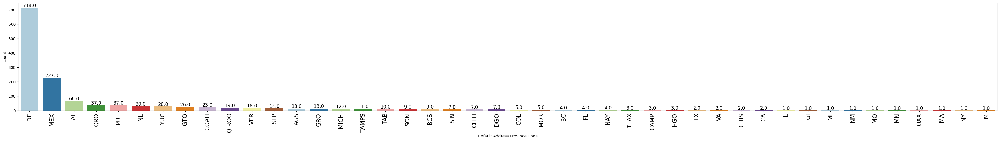

In [ ]:
# Plotting the labeled barplot for Location

labeled_barplot(df, 'Default Address Province Code')

**Observations:**

- Most customers are located in:
  - Distrito Federal (DF) with 714 customer profiles
  - Estado de Mexico (MEX) with 227 customer profiles
  - Jalisco (JAL) with 66 customer profiles

- States with less customer profile yet notable:
  - Queretaro (QRO) with 37 customer porfiles
  - Puebla (PUE) with 37 customer profiles
  - Nuevo Leon (NL) with 30 custmer profiles
  - Yucatan (YUC) with 26 customer profiles
  - Guanajuato (GTO) with 26 customer profiles
  - Coahuila (COAH) with 23 customer pfofiles
  - Quintana Roo (QROO) with 19 customer profiles
  - Veracruz (VER) with 18 customer profiles



<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




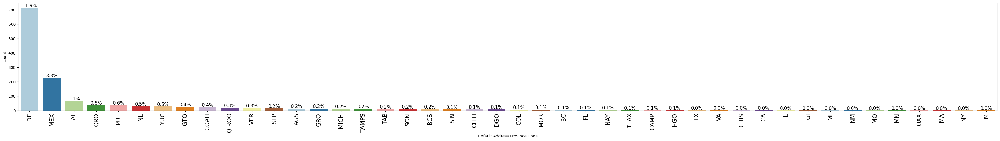

In [ ]:
# Plotting the labeled barplot for Location

labeled_barplot(df, 'Default Address Province Code', perc=True)

To understand where exactly in the state the customers are located, these will be cross referenced with the top 10 Zip codes per state (for the most common states):  

In [ ]:
# List of specific provinces to include
provinces_to_include = ['DF', 'MEX', 'JAL', 'QRO', 'PUE', 'NL', 'YUC', 'GTO', 'COAH', 'QROO', 'VER', 'SLP']

# Filter the DataFrame for these provinces
filtered_df = df[df['Default Address Province Code'].isin(provinces_to_include)]


In [ ]:
# Group by 'Default Address Province Code' and 'Default Address Zip'
grouped = filtered_df.groupby(['Default Address Province Code', 'Default Address Zip']).size().reset_index(name='counts')

# Sort by province and counts in descending order
grouped_sorted = grouped.sort_values(['Default Address Province Code', 'counts'], ascending=[True, False])

# Get the top 10 most frequent zip codes for each province
top_10_zip_per_province = grouped_sorted.groupby('Default Address Province Code').head(10)

# Display the result
print(top_10_zip_per_province)


    Default Address Province Code  Default Address Zip  counts
12                           COAH              27105.0       3
0                            COAH              25200.0       2
1                            COAH              25204.0       2
2                            COAH              25205.0       2
8                            COAH              26020.0       2
3                            COAH              25209.0       1
4                            COAH              25210.0       1
5                            COAH              25253.0       1
6                            COAH              25280.0       1
7                            COAH              25298.0       1
140                            DF              11000.0      51
89                             DF               5100.0      30
153                            DF              11560.0      29
91                             DF               5120.0      28
24                             DF               1210.0 

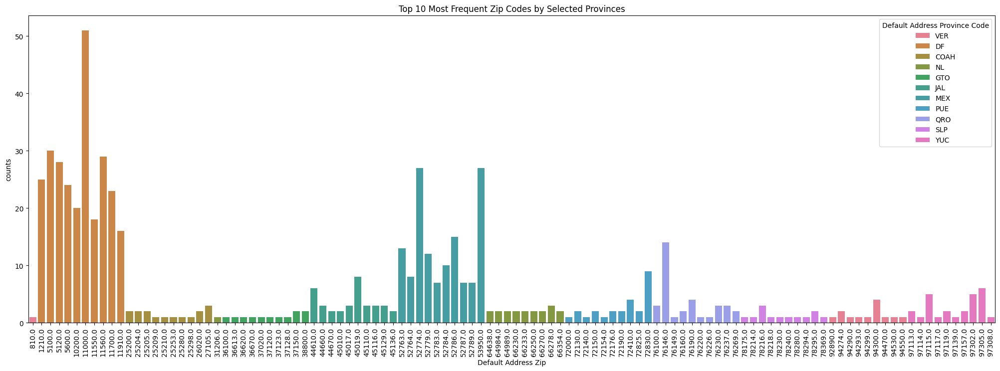

In [ ]:
plt.figure(figsize=(25, 8))
sns.barplot(data=top_10_zip_per_province, x='Default Address Zip', y='counts', hue='Default Address Province Code', dodge=False)
plt.xticks(rotation=90)
plt.title('Top 10 Most Frequent Zip Codes by Selected Provinces')
plt.show()

**Observations:** While this is a good overview, notabely Quintana Roo is not on the list, as such we will filter these rows to verify why

In [ ]:
# Check if there are any entries for QROO in the original DataFrame
qroo_data = df[df['Default Address Province Code'] == 'QROO']
qroo_data


,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender


**Observations:** There is no ZIP code data for customers located in Quintana Roo

#### Gender

In [ ]:
df.value_counts('Predicted Gender')

,count
Predicted Gender,
female,3320
male,2426
unknown,232
business,4


<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




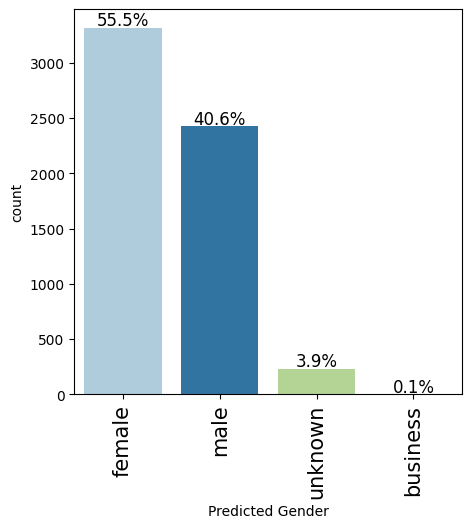

In [ ]:
labeled_barplot(df, 'Predicted Gender', perc=True)

**Observations:**

- Most customer profiles are female with 55.5%
- Male customer profiles are 40.6%
- Unknown gender accounts for only 3.9%
- Businesses have 0.1%

#### Accepts eMail Marketing

<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




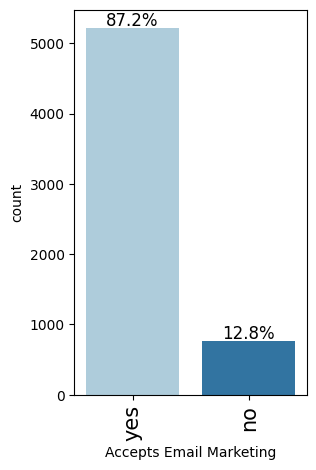

In [ ]:
labeled_barplot(df, 'Accepts Email Marketing', perc=True)

**Observations:** The majority of customer profiles accept eMail Marketing with 87.2%

#### Total Orders

<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




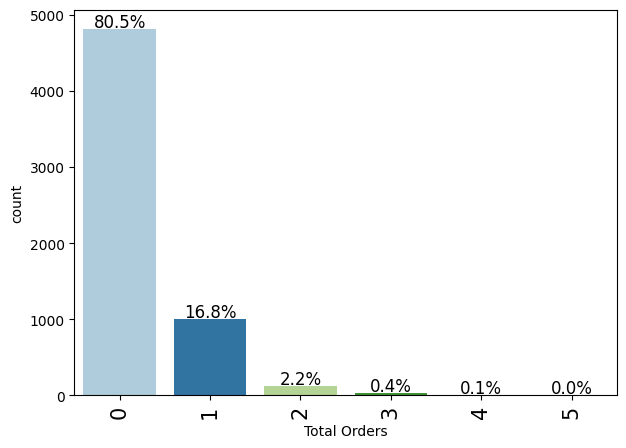

In [ ]:
labeled_barplot(df, 'Total Orders', perc=True)

**Observations:** The majority of customer profiles have no order (80.5%).

However, it is important to note that there are around 100 profiles that are doubled where some customers have:

  1. No orders on both profiles
  2. Orders on both profiles
  3. Orders on just one profile

As such this metric is to take as an **estimate only**

### Bivariate Analysis

In [ ]:
# Defining a function for stacked barplot, including the visualization of crosstab tabels for easier interpretation

# Predictor and target are columns of the catagorical variables
def stacked_barplot(data, perdictor, target):
  count = df[perdictor].nunique() #calculating the unique values for our predictor column
  sorter = df[target].value_counts().index[-1] #using the target variable as sorter, (most frequent to least frequent

  # creating a crosstab called tab1
  tab1 = pd.crosstab(df[perdictor], df[target]).sort_values(by = sorter, ascending = False) # use the sorter previousle definde in descending order
  print(tab1)
   # creating another crosstab called tab, where we normalize the results based on the index. So instead of the counts here, we see proprotions
  tab = pd.crosstab(df[perdictor], df[target], normalize = 'index').sort_values(by = sorter, ascending = False)

  tab.plot(kind='bar', stacked = True, figsize = (count +1, 5)) #figsize = (count +1 using the number of predictor +1. If the number of values in predictor increases, so will the plot automatically

  #adding a legend if we use loc='upper left'
  #frameon = True will set a frame around the legend
  plt.legend(loc='upper left', bbox_to_anchor = (1,1), frameon = True)

In [ ]:
df.head(1)

,Customer ID,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Default Address Phone,Total Spent,Total Orders,Tags,Normalized First Name,Normalized Last Name,Predicted Gender
0,6237948444924,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910.0,55 3706 9200,0.0,0,NaN,jimena,ruiz,female


Predicted Gender               business  female  male  unknown
Default Address Province Code                                 
QRO                                   1      27     9        0
BC                                    0       1     3        0
MO                                    0       0     1        0
MOR                                   0       2     3        0
NAY                                   0       2     2        0
NL                                    0      15    14        1
NM                                    0       0     1        0
NY                                    0       1     0        0
OAX                                   0       0     1        0
PUE                                   0      17    18        2
Q ROO                                 0      14     4        1
AGS                                   0       9     2        2
SIN                                   0       5     2        0
SLP                                   0       9     5  

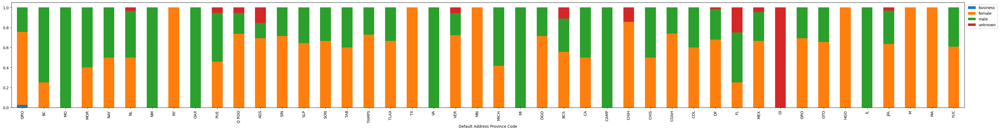

In [ ]:
# Reviewing Gender & Location

stacked_barplot(df, 'Default Address Province Code', 'Predicted Gender')

Predicted Gender  business  female  male  unknown
Total Orders                                     
0                        3    2521  2078      211
1                        1     678   312       16
2                        0      96    30        4
3                        0      20     5        1
4                        0       4     0        0
5                        0       1     1        0


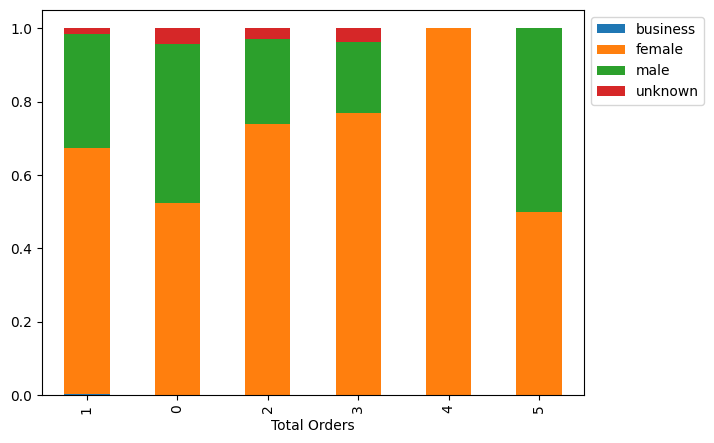

In [ ]:
# Reviewing Gender & Location

stacked_barplot(df, 'Total Orders', 'Predicted Gender')

# **4. Order analysis**

### Basic info


In [ ]:
df_orders2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3774 entries, 0 to 3773
Data columns (total 79 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         3774 non-null   object 
 1   Email                        3767 non-null   object 
 2   Financial Status             1372 non-null   object 
 3   Paid at                      1372 non-null   object 
 4   Fulfillment Status           1372 non-null   object 
 5   Fulfilled at                 1370 non-null   object 
 6   Accepts Marketing            1372 non-null   object 
 7   Currency                     1372 non-null   object 
 8   Subtotal                     1372 non-null   float64
 9   Shipping                     1372 non-null   float64
 10  Taxes                        1372 non-null   float64
 11  Total                        1372 non-null   float64
 12  Discount Code                221 non-null    object 
 13  Discount Amount   

In [ ]:
# Set the option to display all rows
pd.set_option('display.max_rows', None)

# Now when you call isnull().sum(), it will display all columns
df_orders2.isnull().sum()

,0
Name,0
Email,7
Financial Status,2402
Paid at,2402
Fulfillment Status,2402
Fulfilled at,2404
Accepts Marketing,2402
Currency,2402
Subtotal,2402
Shipping,2402


###**Dropping variables that are not usefull**

In [ ]:
# Set the option to display all columns
pd.set_option('display.max_columns', None)

#Drop useless columns
df_orders2.drop(columns=['Tax 1 Name'], inplace=True)
df_orders2.drop(columns=['Tax 1 Value'], inplace=True)
df_orders2.drop(columns=['Tax 2 Name'], inplace=True)
df_orders2.drop(columns=['Tax 2 Value'], inplace=True)
df_orders2.drop(columns=['Tax 3 Name'], inplace=True)
df_orders2.drop(columns=['Tax 3 Value'], inplace=True)
df_orders2.drop(columns=['Tax 4 Name'], inplace=True)
df_orders2.drop(columns=['Tax 4 Value'], inplace=True)
df_orders2.drop(columns=['Tax 5 Name'], inplace=True)
df_orders2.drop(columns=['Tax 5 Value'], inplace=True)
df_orders2.drop(columns=['Phone'], inplace=True)
df_orders2.drop(columns=['Receipt Number'], inplace=True)
df_orders2.drop(columns=['Duties'], inplace=True)
df_orders2.drop(columns=['Payment Terms Name'], inplace=True)
df_orders2.drop(columns=['Next Payment Due At'], inplace=True)

# Now when you call df_orders2.head(), it will display all columns
df_orders2.head(5)




,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
0,#2372SP,gvelazquezu@gmail.com,paid,2024-08-09 14:55:37 -0600,fulfilled,2024-08-09 17:52:38 -0600,yes,MXN,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,NaN,NaN,Mercado Pago Tarjetas,r6suOBchcjGb4URPmCDw0ic6u,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793806e+12,NaN,Low,web,714.5,Ciudad de México,Ciudad de México,r6suOBchcjGb4URPmCDw0ic6u,r6suOBchcjGb4URPmCDw0ic6u
1,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
2,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
3,#2371SP,maggie_parra@hotmail.com,paid,2024-08-09 13:26:47 -0600,fulfilled,2024-08-09 17:50:23 -0600,yes,MXN,1698.0,149.0,0.0,1847.0,NaN,1698.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,NaN,NaN,NaN,PayPal Express Checkout,rTWSCiV6l5SVs5YdJovKThMkK,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793713e+12,NaN,Low,web,424.5,Ciudad de México,Ciudad de México,rTWSCiV6l5SVs5YdJovKThMkK,rTWSCiV6l5SVs5YdJovKThMkK
4,#2371SP,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,424.5,NaN,NaN,NaN,NaN


###**Treating missing values in orders**

In [ ]:
#We create a new Dataset called df_grouped where we use the aggregation and concat to either sum the values or replace the missing values
# Sample aggregation functions based on the column types
aggregation_functions = {
    'Subtotal': 'sum',
    'Total': 'sum',
    'Discount Amount': 'sum',
    'Lineitem quantity': 'sum',
    'Lineitem name': lambda x: list(x.dropna().unique()),
    'Lineitem price': lambda x: list(x.dropna().unique()),
    'Lineitem sku': lambda x: list(x.dropna().unique())
}

# Define a function to concatenate non-null unique values in a column
def concat_unique(series):
    return ', '.join(map(str, series.dropna().unique()))

# Default aggregation for all other columns: concatenate unique values
default_agg = {col: concat_unique for col in df_orders2.columns if col not in aggregation_functions}

# Combine the specific aggregation rules with the default
agg_funcs = {**default_agg, **aggregation_functions}

# Group by the "Name" (or ID) column and apply the appropriate aggregation function
df_grouped = df_orders2.groupby('Name', as_index=False).agg(agg_funcs)



In [ ]:
# Display the resulting DataFrame
df_grouped.head(20)

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku
0,#1001SP,sm_aguirre@hotmail.com,paid,2022-05-06 13:08:18 -0500,fulfilled,2022-05-09 10:28:25 -0500,yes,MXN,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-06 13:08:18 -0500,,True,True,fulfilled,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,,,,Pago con tarjeta de crédito y débito,c32828237971708.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4787932758268.0,ENTREGADO,Low,web,0.0,Sinaloa,Sinaloa,a640aca3d19588451313981eedcba33b,a640aca3d19588451313981eedcba33b,1429.00,1563.00,0.00,1,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[1429.0],[7506382416321.0]
1,#1002SP,paulappt18@gmail.com,paid,2022-05-07 13:25:52 -0500,fulfilled,2022-05-09 10:39:06 -0500,no,MXN,122.0,0.0,,Estándar (3 - 5 Días Hábiles),2022-05-07 13:25:51 -0500,1429.0,True,True,fulfilled,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,,,,Pago con tarjeta de crédito y débito,c32829180346620.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4788941652220.0,ENTREGADO,Low,580111,0.0,Puebla,Puebla,b38177fe6289c88a2a25ead8e208dc64,b38177fe6289c88a2a25ead8e208dc64,571.60,693.60,0.00,1,[TRAJE DE BAÑO HOMBRE DRAGON FLY - S],[571.6],[7506382409064.0]
2,#1003SP,rogerjimro@hotmail.com,paid,2022-05-07 15:09:30 -0500,fulfilled,2022-05-09 10:48:15 -0500,yes,MXN,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-07 15:09:30 -0500,1299.0,True,True,fulfilled,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,,,,Pago con tarjeta de crédito y débito,c32832270336252.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4789060731132.0,ENTREGADO,Low,web,0.0,Estado de México,Estado de México,5b6bc0740d8be4a6a71b7a06e7852a05,5b6bc0740d8be4a6a71b7a06e7852a05,519.60,653.60,0.00,1,[TRAJE DE BAÑO HOMBRE LOBSTERS - XL],[519.6],[7506382406391.0]
3,#1004SP,gonzalorz1985@gmail.com,paid,2022-05-10 12:23:23 -0500,fulfilled,2022-05-10 13:30:39 -0500,yes,MXN,122.0,0.0,TEQUESMAYO22,Estándar (3 - 5 Días Hábiles),2022-05-10 12:23:22 -0500,,True,True,fulfilled,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,,,,Pago con tarjeta de crédito y débito,c32842140680444.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4791490576636.0,ENTREGADO,Low,web,0.0,Ciudad de México,Ciudad de México,6e44c69b9b34d52e6aed6a0da7f40882,6e44c69b9b34d52e6aed6a0da7f40882,1143.20,1265.20,285.80,1,[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS - L],[1429.0],[7506382416086.0]
4,#1005SP,maximo.1996@hotmail.com,paid,2022-05-10 20:54:59 -0500,fulfilled,2022-05-11 10:51:34 -0500

In [ ]:
df_grouped.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1372 entries, 0 to 1371
Data columns (total 64 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         1372 non-null   object 
 1   Email                        1372 non-null   object 
 2   Financial Status             1372 non-null   object 
 3   Paid at                      1372 non-null   object 
 4   Fulfillment Status           1372 non-null   object 
 5   Fulfilled at                 1372 non-null   object 
 6   Accepts Marketing            1372 non-null   object 
 7   Currency                     1372 non-null   object 
 8   Shipping                     1372 non-null   object 
 9   Taxes                        1372 non-null   object 
 10  Discount Code                1372 non-null   object 
 11  Shipping Method              1372 non-null   object 
 12  Created at                   1372 non-null   object 
 13  Lineitem compare a

In [ ]:
# Merge the datasets df_cx and df_checkouts so we can have the gender acording to the email
df_grouped = df_grouped.merge(df_cx[['Email', 'Gender']], on='Email', how='left')
# Replace 'mostly_female' with 'female' and 'mostly_male' with 'male'
df_grouped['Gender'] = df_grouped['Gender'].replace({'mostly_female': 'female', 'mostly_male': 'male'})
# Group by Gender and calculate the average order price
df_avg_price = df_grouped.groupby('Gender')['Total'].mean().reset_index()

### Date & Time of Orders

In [ ]:
# Check the data type of the 'Paid at' column
print(df_grouped['Paid at'].dtype)


object


**Observation:** The column 'Paid at' is currently an object, in order for future analysis, this needs to be converted to a date-time data type.


In [ ]:
# Convert 'Paid at' to datetime with UTC
df_grouped['Paid at'] = pd.to_datetime(df_grouped['Paid at'], utc=True)

# Check the data type again to confirm
print(df_grouped['Paid at'].dtype)



datetime64[ns, UTC]


**Observation:** The 'Paid at' column is now in a datetime format

In [ ]:
# Extract year and month from the 'Paid at' column
df_grouped['Year'] = df_grouped['Paid at'].dt.year
df_grouped['Month'] = df_grouped['Paid at'].dt.month


In [ ]:
orders_by_year = df_grouped.groupby('Year').size().reset_index(name='Order Count')
orders_by_year

,Year,Order Count
0,2022,387
1,2023,655
2,2024,330


In [ ]:
df_grouped.head()

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Gender,Year,Month
0,#1001SP,sm_aguirre@hotmail.com,paid,2022-05-06 18:08:18+00:00,fulfilled,2022-05-09 10:28:25 -0500,yes,MXN,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-06 13:08:18 -0500,,True,True,fulfilled,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,,,,Pago con tarjeta de crédito y débito,c32828237971708.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4787932758268.0,ENTREGADO,Low,web,0.0,Sinaloa,Sinaloa,a640aca3d19588451313981eedcba33b,a640aca3d19588451313981eedcba33b,1429.0,1563.0,0.0,1,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[1429.0],[7506382416321.0],female,2022,5
1,#1002SP,paulappt18@gmail.com,paid,2022-05-07 18:25:52+00:00,fulfilled,2022-05-09 10:39:06 -0500,no,MXN,122.0,0.0,,Estándar (3 - 5 Días Hábiles),2022-05-07 13:25:51 -0500,1429.0,True,True,fulfilled,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,,,,Pago con tarjeta de crédito y débito,c32829180346620.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4788941652220.0,ENTREGADO,Low,580111,0.0,Puebla,Puebla,b38177fe6289c88a2a25ead8e208dc64,b38177fe6289c88a2a25ead8e208dc64,571.6,693.6,0.0,1,[TRAJE DE BAÑO HOMBRE DRAGON FLY - S],[571.6],[7506382409064.0],female,2022,5
2,#1003SP,rogerjimro@hotmail.com,paid,2022-05-07 20:09:30+00:00,fulfilled,2022-05-09 10:48:15 -0500,yes,MXN,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-07 15:09:30 -0500,1299.0,True,True,fulfilled,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,,,,Pago con tarjeta de crédito y débito,c32832270336252.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4789060731132.0,ENTREGADO,Low,web,0.0,Estado de México,Estado de México,5b6bc0740d8be4a6a71b7a06e7852a05,5b6bc0740d8be4a6a71b7a06e7852a05,519.6,653.6,0.0,1,[TRAJE DE BAÑO HOMBRE LOBSTERS - XL],[519.6],[7506382406391.0],male,2022,5
3,#1004SP,gonzalorz1985@gmail.com,paid,2022-05-10 17:23:23+00:00,fulfilled,2022-05-10 13:30:39 -0500,yes,MXN,122.0,0.0,TEQUESMAYO22,Estándar (3 - 5 Días Hábiles),2022-05-10 12:23:22 -0500,,True,True,fulfilled,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,,,,Pago con tarjeta de crédito y débito,c32842140680444.1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,4791490576636.0,ENTREGADO,Low,web,0.0,Ciudad de México,Ciudad de México,6e44c69b9b34d52e6aed6a0da7f40882,6e44c69b9b34d52e6aed6a0da7f40882,1143.2,1265.2,285.8,1,[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS - L],[1429.0],[7506382416086.0],male,2022,5
4,#1005SP,maximo.1996@hotmail.com,paid,202

### **Top 10 most ordered items**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




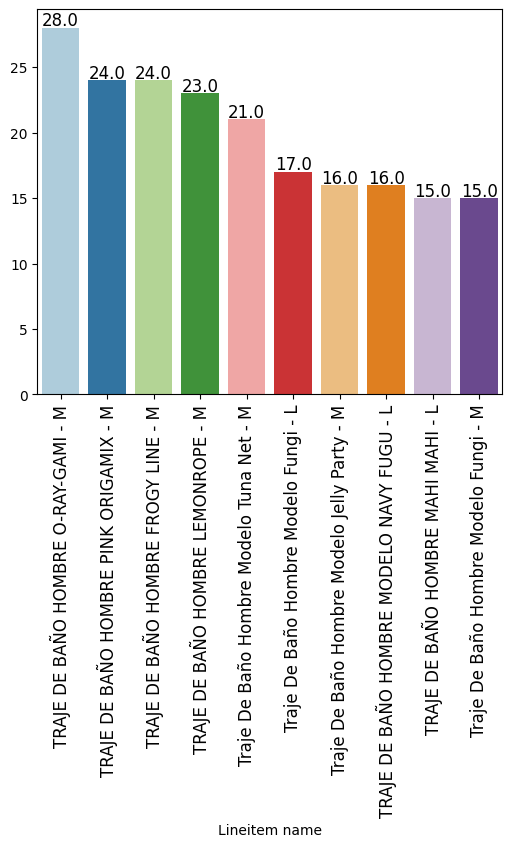

In [ ]:
# Explode the list values in the 'lineitem name' column before passing it to the function
df_grouped_exploded = df_grouped.explode('Lineitem name')

# Now call the function with the exploded DataFrame
labeled_barplot_top10(df_grouped_exploded, 'Lineitem name')

### **Most ordered items over the years**

#### 2022

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




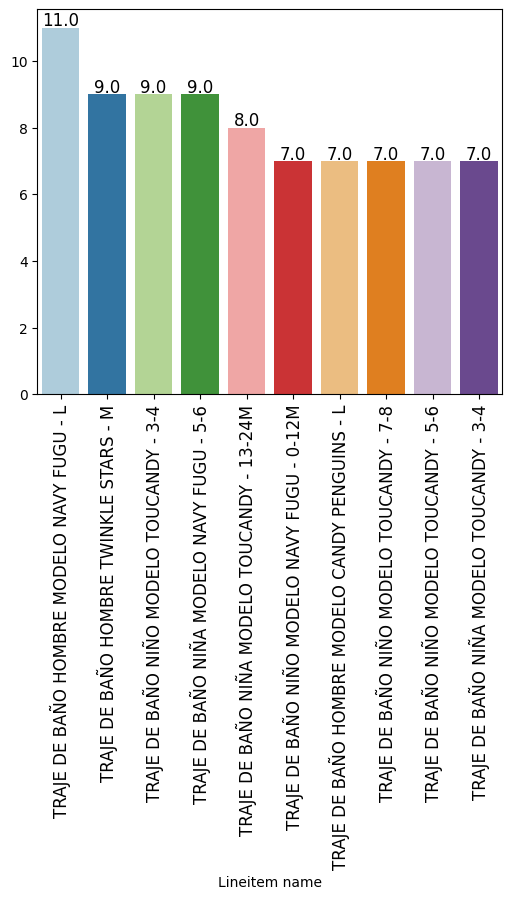

In [ ]:
df_grouped2022 = df_grouped[df_grouped['Year'] == 2022]

# Explode the list values in the 'lineitem name' column before passing it to the function
df_grouped_exploded = df_grouped2022.explode('Lineitem name')

labeled_barplot_top10(df_grouped_exploded, 'Lineitem name')

#### 2023

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




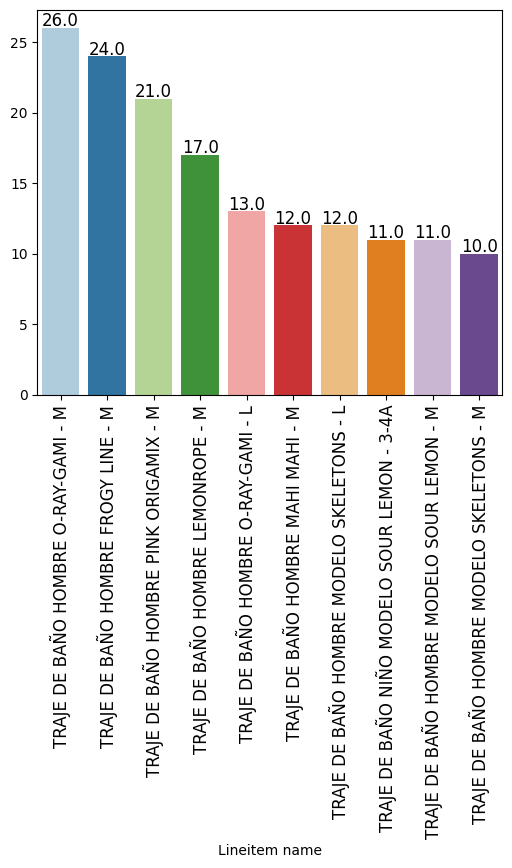

In [ ]:
df_grouped2023 = df_grouped[df_grouped['Year'] == 2023]

# Explode the list values in the 'lineitem name' column before passing it to the function
df_grouped_exploded = df_grouped2023.explode('Lineitem name')

labeled_barplot_top10(df_grouped_exploded, 'Lineitem name')

#### 2024

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




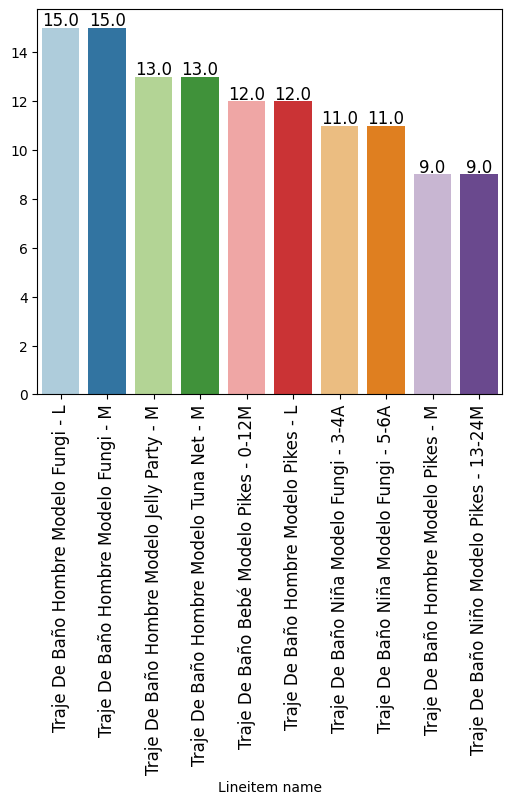

In [ ]:
df_grouped2024 = df_grouped[df_grouped['Year'] == 2024]

# Explode the list values in the 'lineitem name' column before passing it to the function
df_grouped_exploded = df_grouped2024.explode('Lineitem name')

labeled_barplot_top10(df_grouped_exploded, 'Lineitem name')

### **Most ordered items by year without the size**

In [ ]:
# List of columns to include in the Product DataFrame
columns_to_include = ['Name', 'Paid at', 'Lineitem quantity', 'Lineitem name', 'Lineitem price', 'Lineitem compare at price', 'Lineitem sku', 'Shipping City', 'Shipping Zip', 'Shipping Province', 'Payment Method','Year','Gender']

# Create the new DataFrame with the specified columns
products_data = df_grouped[columns_to_include].copy()

# Convert the 'Lineitem sku' column to object (string) type
products_data['Lineitem sku'] = products_data['Lineitem sku'].astype('object')
# Display the new DataFrame
products_data.head()

,Name,Paid at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Shipping City,Shipping Zip,Shipping Province,Payment Method,Year,Gender
0,#1001SP,2022-05-06 18:08:18+00:00,1,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[1429.0],,[7506382416321.0],culiacan,'80199,SIN,Pago con tarjeta de crédito y débito,2022,female
1,#1002SP,2022-05-07 18:25:52+00:00,1,[TRAJE DE BAÑO HOMBRE DRAGON FLY - S],[571.6],1429.0,[7506382409064.0],Puebla,'72813,PUE,Pago con tarjeta de crédito y débito,2022,female
2,#1003SP,2022-05-07 20:09:30+00:00,1,[TRAJE DE BAÑO HOMBRE LOBSTERS - XL],[519.6],1299.0,[7506382406391.0],Huixquilucan,'52774,MEX,Pago con tarjeta de crédito y débito,2022,male
3,#1004SP,2022-05-10 17:23:23+00:00,1,[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS - L],[1429.0],,[7506382416086.0],cdmx,'03900,DF,Pago con tarjeta de crédito y débito,2022,male
4,#1005SP,2022-05-11 01:54:59+00:00,1,[TRAJE DE BAÑO HOMBRE O-RAY-GAMI - S],[1429.0],,[7506382412040.0],Puebla,'72130,PUE,PayPal Express Checkout,2022,unknown


In [ ]:
def clean_lineitem_name(name):
    return name.split('-')[0].strip()

def clean_lineitem_list(lineitem_list):
    return [clean_lineitem_name(item) for item in lineitem_list]

# Apply the function to clean the 'Lineitem name' column
products_data['Clean Lineitem name'] = products_data['Lineitem name'].apply(clean_lineitem_list)
# Display the cleaned column
products_data[['Lineitem name', 'Clean Lineitem name']].head()

,Lineitem name,Clean Lineitem name
0,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[TRAJE DE BAÑO HOMBRE MODELO LIME LINE]
1,[TRAJE DE BAÑO HOMBRE DRAGON FLY - S],[TRAJE DE BAÑO HOMBRE DRAGON FLY]
2,[TRAJE DE BAÑO HOMBRE LOBSTERS - XL],[TRAJE DE BAÑO HOMBRE LOBSTERS]
3,[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS - L],[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS]
4,[TRAJE DE BAÑO HOMBRE O-RAY-GAMI - S],[TRAJE DE BAÑO HOMBRE O]


<ipython-input-598-e8cbc8527a54>:16: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




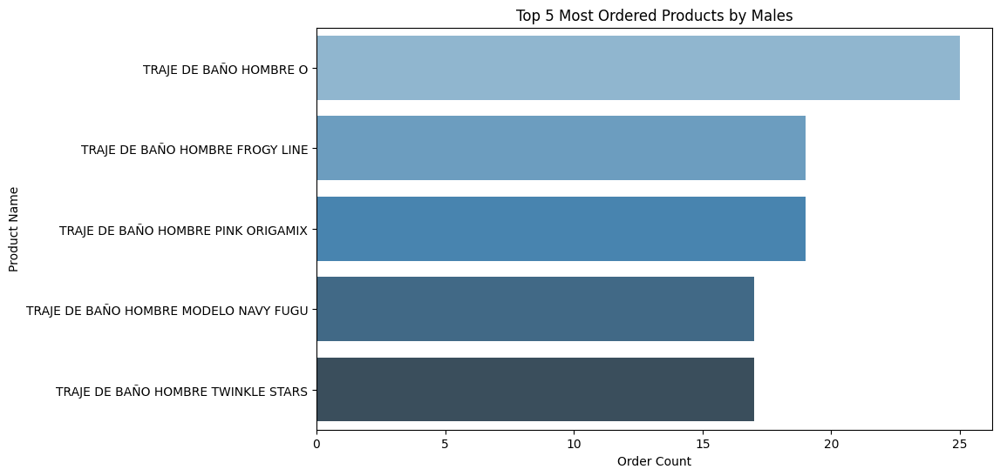

In [ ]:
# Explode the 'Lineitem name' column to turn lists into separate rows
df_exploded = products_data.explode('Clean Lineitem name')

# Group by Gender and Lineitem name, then count the occurrences
df_top_products = df_exploded.groupby(['Gender', 'Clean Lineitem name']).size().reset_index(name='Order Count')

# Sort by Gender and Order Count to get the top products per gender
df_top_products = df_top_products.sort_values(['Gender', 'Order Count'], ascending=[True, False])

# Separate data for males and females
df_top_male = df_top_products[df_top_products['Gender'] == 'male'].head(5)
df_top_female = df_top_products[df_top_products['Gender'] == 'female'].head(5)

# Plotting the data for males
plt.figure(figsize=(10, 6))
sns.barplot(x='Order Count', y='Clean Lineitem name', data=df_top_male, palette='Blues_d')
plt.xlabel('Order Count')
plt.ylabel('Product Name')
plt.title('Top 5 Most Ordered Products by Males')
plt.show()

#### ***2022***

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




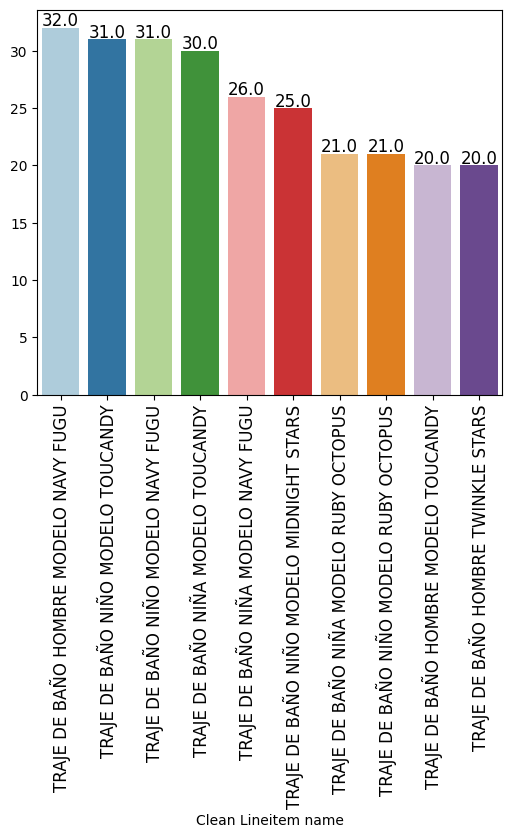

In [ ]:
df_grouped2022 = products_data[products_data['Year'] == 2022]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2022.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

#### **2023**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




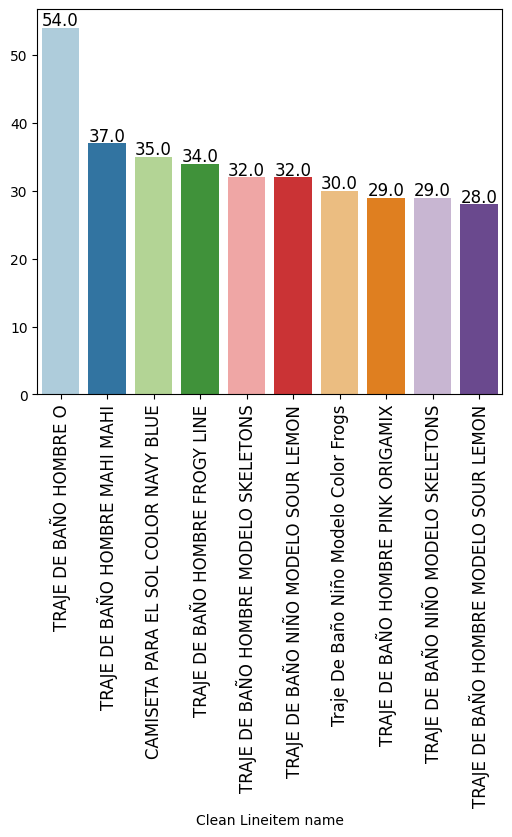

In [ ]:
df_grouped2023 = products_data[products_data['Year'] == 2023]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2023.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

#### **2024**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




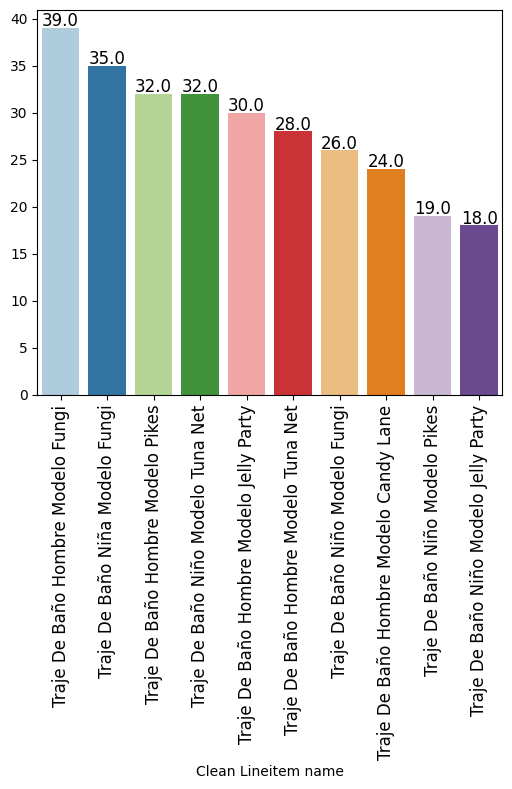

In [ ]:
df_grouped2024 = products_data[products_data['Year'] == 2024]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2024.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

In [ ]:
df_grouped2024.head(10)

,Name,Paid at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Shipping City,Shipping Zip,Shipping Province,Payment Method,Year,Gender,Clean Lineitem name
1042,#2043SP,2024-01-01 02:52:18+00:00,5,"[Limones Niño - 5-6A, Traje De Baño Niño Duckl...","[849.0, 1429.0]",,"[7506382403482.0, 7506382412514.0, 75063824131...",Álvaro Obregón,'01730,DF,Credit/Debit card by PayPal,2024,female,"[Limones Niño, Traje De Baño Niño Ducklings, T..."
1043,#2044SP,2024-01-01 23:55:54+00:00,2,"[Traje De Baño Niño Navy Clam - 13-24M, Traje ...","[849.0, 899.0]",,"[7506382412941.0, 7506382413429.0]",Cdmx,'11560,DF,PayPal Express Checkout,2024,female,"[Traje De Baño Niño Navy Clam, Traje De Bano N..."
1044,#2045SP,2024-01-02 02:05:05+00:00,2,"[Traje De Baño Mujer Modelo Sour Lemon - L, Tr...",[1699.0],,"[7506382422452.0, 7506382422537.0]",Leon,'37358,GTO,PayPal Express Checkout,2024,female,"[Traje De Baño Mujer Modelo Sour Lemon, Traje ..."
1045,#2046SP,2024-01-02 03:57:24+00:00,2,"[Traje De Baño Hombre Modelo Origanimal - S, T...",[1429.0],,"[7506382420168.0, 7506382420106.0]",Entre Mar Caribe y Mar Caspio,'44610,JAL,PayPal Express Checkout,2024,female,"[Traje De Baño Hombre Modelo Origanimal, Traje..."
1046,#2047SP,2024-01-02 13:16:19+00:00,2,[Traje De Baño Hombre Modelo Royal Chains - XS...,[1429.0],,"[7506382416659.0, 7506382420090.0]",Ciudad de México,'06500,DF,Credit/Debit card by PayPal,2024,male,"[Traje De Baño Hombre Modelo Royal Chains, Tra..."
1047,#2048SP,2024-01-03 00:42:07+00:00,2,"[Traje De Baño Mujer Modelo Origanimal - M, Tr...","[1699.0, 1429.0]",,"[7506382422520.0, 7506382420182.0]",Xochitepec,'62790,MOR,PayPal Express Checkout,2024,male,"[Traje De Baño Mujer Modelo Origanimal, Traje ..."
1048,#2049SP,2024-01-04 17:08:01+00:00,4,"[Traje De Baño Niño Modelo Navy Fugu - 3-4A, T...","[849.0, 899.0]",,"[7506382416932.0, 7506382423862.0, 75063824242...",Mexico,'01219,DF,PayPal Express Checkout,2024,female,"[Traje De Baño Niño Modelo Navy Fugu, Traje De..."
1049,#2050SP,2024-01-04 20:49:48+00:00,2,"[Traje De Baño Hombre Lemonrope - M, Traje De ...","[1429.0, 849.0]",,"[7506382411456.0, 7506382412668.0]",Atlixco,'74368,PUE,Credit/Debit card by PayPal,2024,female,"[Traje De Baño Hombre Lemonrope, Traje De Baño..."
1050,#2051SP,2024-01-05 05:18:28+00:00,4,"[Traje De Baño Hombre Mahi Mahi - L, TRAJE DE ...","[1429.0, 849.0, 899.0]",,"[7506382408968.0, 7506382421851.0, 75063824218...",Cdmx,'01330,DF,Credit/Debit card by PayPal,2024,female,"[Traje De Baño Hombre Mahi Mahi, TRAJE DE BAÑO..."
1051,#2052SP,2024-01-05 20:49:15+00:00,2,"[Traje De Baño Hombre Mahi Mahi - M, Traje De ...",[1429.0],,"[7506382408951.0, 7506382420052.0]",MEX,'53270,MEX,PayPal Express Checkout,2024,male,"[Traje De Baño Hombre Mahi Mahi, Traje De Baño..."


### **What did customers buy with the most ordered item in 2024**

In [ ]:
df_grouped['Clean Lineitem name'] = products_data['Clean Lineitem name']
df_pairing = df_grouped[
    (df_grouped['Year'] == 2024) &
    (df_grouped['Clean Lineitem name'].apply(lambda x: 'Traje De Baño Hombre Modelo Fungi' in x))
]
df_pairing.head()



,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Gender,Year,Month,Clean Lineitem name
1065,#2066SP,maupenagos93@gmail.com,paid,2024-01-18 22:11:44+00:00,fulfilled,2024-01-18 16:57:48 -0600,yes,MXN,0.0,0.0,,Envío gratis. *Estándar,2024-01-18 16:11:43 -0600,,True,True,fulfilled,Mauricio Penagos Meneses,"22 poniente sur #621, Penipak",22 poniente sur #621,Penipak,,Tuxtla Gutierrez,'29060,CHIS,MX,9611174758,Mauricio Penagos Meneses,"22 poniente sur #621, Penipak",22 poniente sur #621,Penipak,,Tuxtla Gutierrez,'29060,CHIS,MX,9611174758,,,,PayPal Express Checkout,rzo5WnMEnQJNmSzO4PnedSFHM,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5544777810172.0,,Low,web,0.0,Chiapas,Chiapas,rzo5WnMEnQJNmSzO4PnedSFHM,rzo5WnMEnQJNmSzO4PnedSFHM,3707.0,3707.0,0.0,3,"[Traje De Baño Hombre Modelo Fungi - XXL, Traj...","[1429.0, 849.0]","[7506382423398.0, 7506382423855.0]",male,2024,1,"[Traje De Baño Hombre Modelo Fungi, Traje De B..."
1098,#2099SP,sofiavaldes@me.com,paid,2024-02-28 14:59:28+00:00,fulfilled,2024-02-28 11:01:39 -0600,yes,MXN,0.0,0.0,,Envío gratis. *Estándar,2024-02-28 08:59:27 -0600,,True,True,fulfilled,Sofia Valdes,"Primer retorno sierra itambe, 59",Primer retorno sierra itambe,59,,Cuidad de mexico,'11920,DF,MX,5545400765,Sofia Valdes,"Primer retorno sierra itambe, 59",Primer retorno sierra itambe,59,,Cuidad de mexico,'11920,DF,MX,5545400765,,,,PayPal Express Checkout,rWEFDqC0gB9XW5Jwq0klnhyv5,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5610562650364.0,,Low,web,0.0,Ciudad de México,Ciudad de México,rWEFDqC0gB9XW5Jwq0klnhyv5,rWEFDqC0gB9XW5Jwq0klnhyv5,14477.2,14477.2,2554.8,18,[Traje De Baño Bebe Unisex Modelo Color Frogs ...,"[549.0, 1429.0, 849.0, 899.0]","[7506382420953.0, 7506382423374.0, 75063824233...",female,2024,2,"[Traje De Baño Bebe Unisex Modelo Color Frogs,..."
1101,#2102SP,edudiegof@hotmail.com,paid,2024-03-03 19:41:10+00:00,fulfilled,2024-03-04 09:40:47 -0600,yes,MXN,99.0,0.0,,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-03-03 13:41:10 -0600,,True,True,fulfilled,Eduardo Diego fernandez forseck,"LaMartine 231, colonia polanco, 201","LaMartine 231, colonia polanco",201,,Miguel Hidalgo,'11550,DF,MX,5543753680,Eduardo Diego fernandez forseck,"LaMartine 231, colonia polanco, 201","LaMartine 231, colonia polanco",201,,Miguel Hidalgo,'11550,DF,MX,5543753680,,,,Credit/Debit card by PayPal,rc4zWofxBwjlOHArE7VyPTSyk,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5615163212028.0,,Low,web,0.0,Ciudad de México,Ciudad de México,rc4zWofxBwjlOHArE7VyPTSyk,rc4zWofxBwjlOHArE7VyPTSyk,1286.1,1385.1,142.9,1,[Traje De Baño Hombre Modelo Fungi - L],[1429.0],[7506382423374.0],male,2024,3,[Traje De Baño Hombre Modelo Fungi]
1114,#2115SP,isadiaz818@hotmail.com,paid,2024-03-11 13:27:20+00:00,fulfilled,2024-03-11 16:20:45 -0600,yes,MXN,0.0,0.0,,Envío gratis. *Estándar,2024-03-11 07:27:19 -0600,,True,True,fulfilled,Isabel Diaz,"Temistocles 327, No",Temistocles 327,No,,Mexico,'11550,DF,MX,+525523003309,Isabel Diaz,"Temistocles 327, No",Temistocles 327,No,,Mexico,'11550,DF,MX,+525523003309,,,,Credit/Debit card by PayPal,r0i8hMyey0rtxT6I3mINkk3p1,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5623650222332.0,,Low,web,0.0,Ciudad de México,Ci

In [ ]:
df_funji_orders = df_grouped[(df_grouped['Year'] == 2024) & (df_grouped['Clean Lineitem name'].apply(lambda x: 'Traje De Baño Hombre Modelo Fungi' in x))]
df_exploded = df_funji_orders.explode('Clean Lineitem name')
df_paired_items = df_exploded[df_exploded['Clean Lineitem name'] != 'Traje De Baño Hombre Modelo Fungi']
common_paired_item = df_paired_items['Clean Lineitem name'].value_counts().idxmax()
paired_item_counts = df_paired_items['Clean Lineitem name'].value_counts()

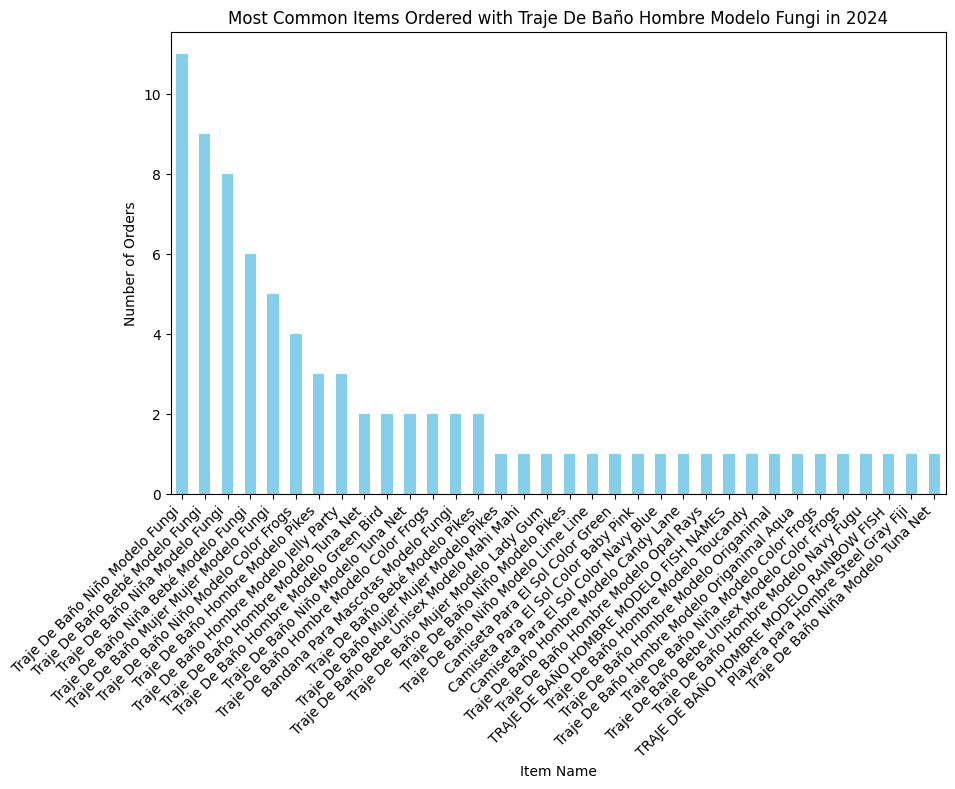

In [ ]:
plt.figure(figsize=(10, 6))
paired_item_counts.plot(kind='bar', color='skyblue')

plt.title('Most Common Items Ordered with Traje De Baño Hombre Modelo Fungi in 2024')
plt.xlabel('Item Name')
plt.ylabel('Number of Orders')
plt.xticks(rotation=45, ha='right')
plt.show()

### **Orders with more than 20 items**

In [ ]:
# Filter the dataset for rows where 'lineitem quantity' is greater than or equal to 10
filtered_df = df_grouped[df_grouped['Lineitem quantity'] >= 20]

# Display the filtered DataFrame
filtered_df.head(10)

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Gender,Year,Month,Clean Lineitem name
1153,#2154SP,patricio.kegel@gmail.com,paid,2024-04-09 22:31:02+00:00,fulfilled,2024-04-10 12:17:33 -0600,yes,MXN,0.0,0.0,PK40,Envío gratis. *Estándar,2024-04-09 16:31:01 -0600,,True,True,fulfilled,Roberta Saldaña,Fuente del Rey,Fuente del Rey,,,Naucalpan de Juárez,'52780,MEX,MX,5531908516,Roberta Saldaña,"Calle 56 Norte 5, Fracc. Selvanova; coto 5; de...",Calle 56 Norte 5,Fracc. Selvanova; coto 5; dept 515E,,Playa del Carmen,'77723,Q ROO,MX,5531908516,,,,Credit/Debit card by PayPal,rmeBCfH0EhMnwpmUSiXwKWV3w,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5655187718396.0,,Low,web,0.0,Estado de México,Quintana Roo,rmeBCfH0EhMnwpmUSiXwKWV3w,rmeBCfH0EhMnwpmUSiXwKWV3w,5203.4,5203.4,46830.6,66,[TRAJE DE BAÑO NIÑO MODELO RAINBOW FISH - 3-4A...,"[849.0, 599.0, 899.0, 549.0, 799.0]","[7506382425538.0, 7506382427969.0, 75063824192...",female,2024,4,"[TRAJE DE BAÑO NIÑO MODELO RAINBOW FISH, Camis..."
1158,#2159SP,magaliruizmarch@hotmail.com,paid,2024-04-11 01:04:38+00:00,fulfilled,2024-04-10 21:43:14 -0600,no,MXN,0.0,0.0,MR40,Envío gratis. *Estándar,2024-04-10 19:04:38 -0600,,True,True,fulfilled,MAGALI RUIZ MARCH,"hacienda del ciervo 8, 2003",hacienda del ciervo 8,2003,,CDMX,'52763,MEX,MX,5519164496,MAGALI RUIZ MARCH,"hacienda del ciervo 8, 2003",hacienda del ciervo 8,2003,,CDMX,'52763,MEX,MX,5519164496,,,,Credit/Debit card by PayPal,rxDKVdtLVssOtahwV94CxFhmL,0.0,TINTARELLA SWIMWEAR & CO,0.0,,,,5656345149692.0,,Low,web,0.0,Estado de México,Estado de México,rxDKVdtLVssOtahwV94CxFhmL,rxDKVdtLVssOtahwV94CxFhmL,4489.9,4489.9,40409.1,31,"[TRAJE DE BAÑO HOMBRE MODELO SOLID GREEN - S, ...","[1899.0, 1429.0, 549.0, 849.0, 1699.0, 799.0]","[7506382428195.0, 7506382428096.0, 75063824236...",female,2024,4,"[TRAJE DE BAÑO HOMBRE MODELO SOLID GREEN, TRAJ..."


### **Orders Total**

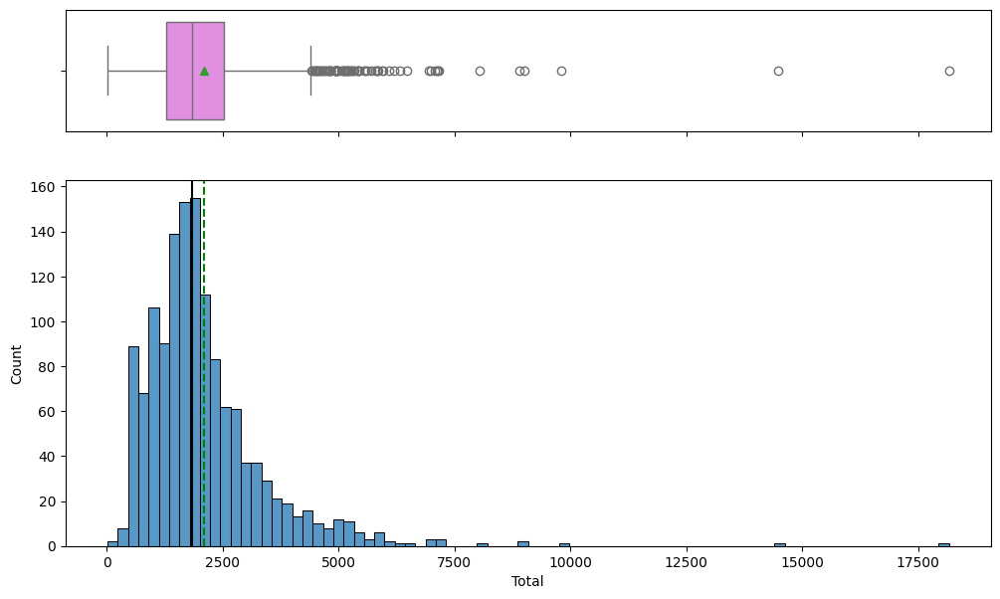

In [ ]:
histogram_boxplot(df_grouped,'Total')

### **Orders Subtotal**

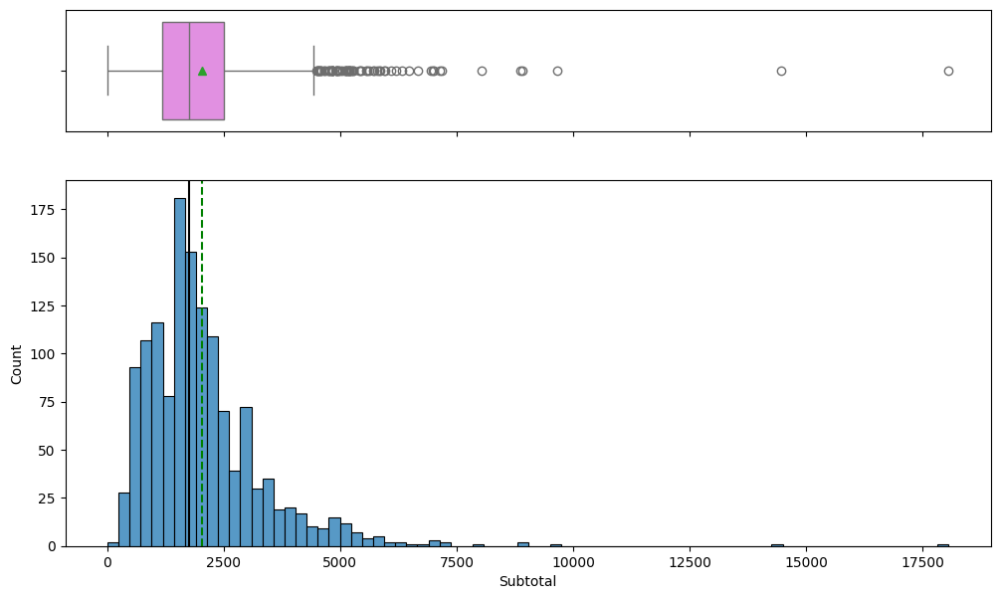

In [ ]:
histogram_boxplot(df_grouped,'Subtotal')

### **Orders Lineitem Quantity**

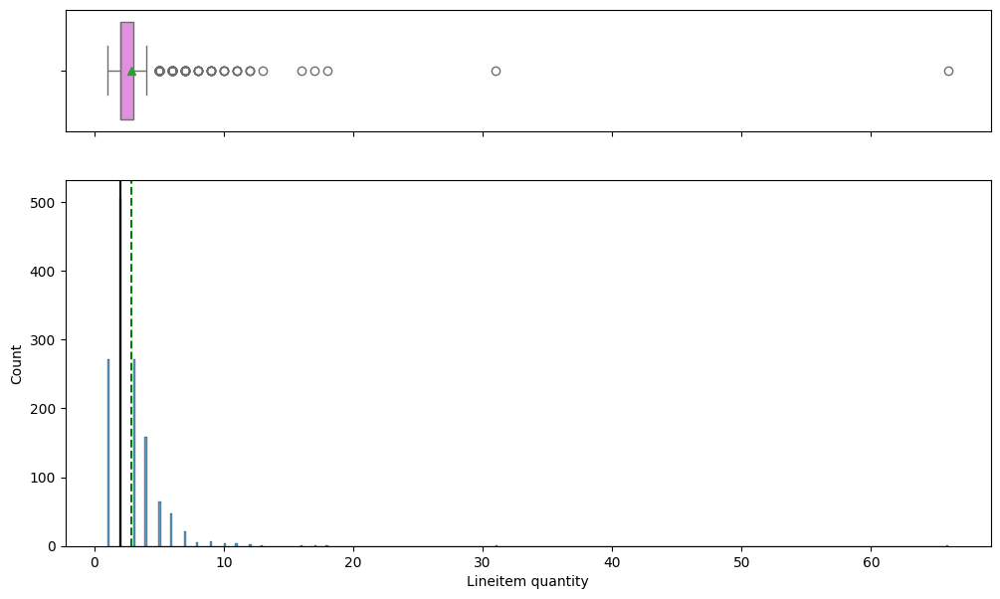

In [ ]:
histogram_boxplot(df_grouped,'Lineitem quantity')

### **Orders Payment Method**

<ipython-input-563-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




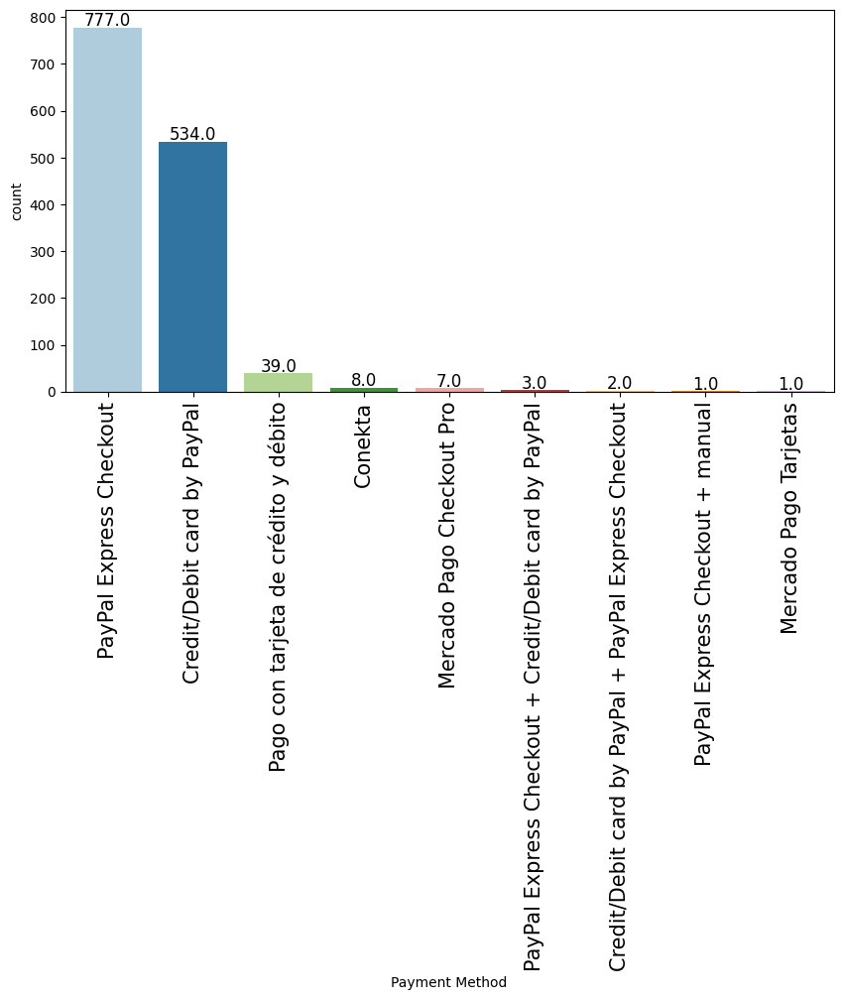

In [ ]:
labeled_barplot(df_grouped,'Payment Method')

##Deep Order Analysis

#### Overview

In [ ]:
df_orders2.head()

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
0,#2372SP,gvelazquezu@gmail.com,paid,2024-08-09 14:55:37 -0600,fulfilled,2024-08-09 17:52:38 -0600,yes,MXN,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,NaN,NaN,Mercado Pago Tarjetas,r6suOBchcjGb4URPmCDw0ic6u,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793806e+12,NaN,Low,web,714.5,Ciudad de México,Ciudad de México,r6suOBchcjGb4URPmCDw0ic6u,r6suOBchcjGb4URPmCDw0ic6u
1,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
2,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
3,#2371SP,maggie_parra@hotmail.com,paid,2024-08-09 13:26:47 -0600,fulfilled,2024-08-09 17:50:23 -0600,yes,MXN,1698.0,149.0,0.0,1847.0,NaN,1698.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,NaN,NaN,NaN,PayPal Express Checkout,rTWSCiV6l5SVs5YdJovKThMkK,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793713e+12,NaN,Low,web,424.5,Ciudad de México,Ciudad de México,rTWSCiV6l5SVs5YdJovKThMkK,rTWSCiV6l5SVs5YdJovKThMkK
4,#2371SP,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,424.5,NaN,NaN,NaN,NaN


In [ ]:
df_orders2.shape

(3774, 64)

**Observations:** There are 3774 rows and 79 columns in the orders data

In [ ]:
df_orders2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3774 entries, 0 to 3773
Data columns (total 64 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         3774 non-null   object 
 1   Email                        3767 non-null   object 
 2   Financial Status             1372 non-null   object 
 3   Paid at                      1372 non-null   object 
 4   Fulfillment Status           1372 non-null   object 
 5   Fulfilled at                 1370 non-null   object 
 6   Accepts Marketing            1372 non-null   object 
 7   Currency                     1372 non-null   object 
 8   Subtotal                     1372 non-null   float64
 9   Shipping                     1372 non-null   float64
 10  Taxes                        1372 non-null   float64
 11  Total                        1372 non-null   float64
 12  Discount Code                221 non-null    object 
 13  Discount Amount   

**Observations:**

- Most columns are objects and floats, there are 2 boolean columns and one integer column
- Many missing values for most columns
- The following columns seem at first glance irrelevant (due to nature, missing values or relevance to target audience) to the target audience analysis and may be considered to be dropped:
  - Financial Status
  - Paid at
  - Fullfillment Status
  - Fullfilled at
  - Currency
  - Lineitem requires shipping
  - Lineitem taxable
  - Lineitem fulfillment status
  - Billing Phone
  - Billing Company (only 11 entries)
  - Shipping Company (only 10 entries)
  - Shipping Phone
  - Notes
  - Note Attributes
  - Cancelled at (only 2 entries)
  - Payment Refernce
  - Vendor (is always Tintarella)
  - Oustanding Balance (many missing values)
  - Employee (there is no data in this column)
  - Location (there is no data in this column)
  - Devide ID (there is no data in this column)
  - Tax 1 Name (there is no data in this column)
  - Tax 1 Value (there is no data in this column)
  - Tax 2 Name (there is no data in this column)
  - Tax 2 Value (there is no data in this column)
  - Tax 3 Name (there is no data in this column)
  - Tax 3 Value (there is no data in this column)
  - Tax 4 Name (there is no data in this column)
  - Tax 4 Value (there is no data in this column)
  - Tax 5 Name (there is no data in this column)
  - Tax 5 Value (there is no data in this column)
  - Phone (only 108 entries)
  - Receipt Number (there is no data in this column)
  - Duties (there is no data in this column)
  - Billing Province Name
  - Shipping Province Name
  - Payment ID
  - Payment Terms Name (there is no data in this column)
  - Next Payment Due At (there is no data in this column)
  - Payment Referance


In [ ]:
df_orders2.duplicated().sum()

0

**Observation:** There are no duplicates in this dataset which is to be expected

#### Missing values & dropping unnecessary columns:

The client has shared a list of emails that are resellers - for a more acccurate analysis the following eMails will be dropped

- ralvarezruiz@gmail.com
- marichufm@gmail.com
- pato.fernandez.nales@gmail.com
- magaliruizmarch@hotmail.com
- patricio.kegel@gmail.com

In [ ]:
# Dropping reseller eMails
reseller_emails = [
    'ralvarezruiz@gmail.com',
    'marichufm@gmail.com',
    'pato.fernandez.nales@gmail.com',
    'magaliruizmarch@hotmail.com',
    'patricio.kegel@gmail.com'
]


In [ ]:
reseller_email_rows = df_orders2[df_orders2['Email'].isin(reseller_emails)]
reseller_email_rows.shape

(84, 64)

In [ ]:
# Correctly filter out reseller emails and reassign to df_orders2
df_orders2 = df_orders2[~df_orders2['Email'].isin(reseller_emails)]

# Display the result
df_orders2.shape


(3690, 64)

In [ ]:
# Extracting an exact count of the missing values observed above
df_orders2.isnull().sum()

,0
Name,0
Email,7
Financial Status,2321
Paid at,2321
Fulfillment Status,2321
Fulfilled at,2323
Accepts Marketing,2321
Currency,2321
Subtotal,2321
Shipping,2321


In [ ]:
# Obtaining percentage of missing values
perc_missing_values = (df_orders2.isnull().sum() / len(df_orders2)) * 100
perc_missing_values

,0
Name,0.000000
Email,0.189702
Financial Status,62.899729
Paid at,62.899729
Fulfillment Status,62.899729
Fulfilled at,62.953930
Accepts Marketing,62.899729
Currency,62.899729
Subtotal,62.899729
Shipping,62.899729


In [ ]:
df_orders2.head()

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Employee,Location,Device ID,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
0,#2372SP,gvelazquezu@gmail.com,paid,2024-08-09 14:55:37 -0600,fulfilled,2024-08-09 17:52:38 -0600,yes,MXN,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,NaN,NaN,Mercado Pago Tarjetas,r6suOBchcjGb4URPmCDw0ic6u,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793806e+12,NaN,Low,web,714.5,Ciudad de México,Ciudad de México,r6suOBchcjGb4URPmCDw0ic6u,r6suOBchcjGb4URPmCDw0ic6u
1,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
2,#2372SP,gvelazquezu@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN
3,#2371SP,maggie_parra@hotmail.com,paid,2024-08-09 13:26:47 -0600,fulfilled,2024-08-09 17:50:23 -0600,yes,MXN,1698.0,149.0,0.0,1847.0,NaN,1698.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,NaN,NaN,NaN,PayPal Express Checkout,rTWSCiV6l5SVs5YdJovKThMkK,0.0,TINTARELLA SWIMWEAR & CO,0.0,NaN,NaN,NaN,5.793713e+12,NaN,Low,web,424.5,Ciudad de México,Ciudad de México,rTWSCiV6l5SVs5YdJovKThMkK,rTWSCiV6l5SVs5YdJovKThMkK
4,#2371SP,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,424.5,NaN,NaN,NaN,NaN


**Observations:** The missing data in this set is due to the nature of the csv file. When an order contains more than one item bought, the Name (Order Number) Remains the same, yet besides lineitem specific information all else is left in blank. As such, the orders will be merged based on 'Name' creating a single row for each order.

Additionally a seperate dataframe will be created containing only lineitem specific information.

In [ ]:
# Creating a security copy before merging cells

dfo = df_orders2.copy()

In [ ]:
# Creating a copy of all information relevant to lineitems

# List of columns to include in the Product DataFrame
columns_to_include = ['Name', 'Paid at', 'Lineitem quantity', 'Lineitem name', 'Lineitem price', 'Lineitem compare at price', 'Lineitem sku', 'Shipping City', 'Shipping Zip', 'Shipping Province', 'Payment Method']

# Create the new DataFrame with the specified columns
products_data = df_orders2[columns_to_include].copy()

# Convert the 'Lineitem sku' column to object (string) type
products_data['Lineitem sku'] = products_data['Lineitem sku'].astype('object')


# Display the new DataFrame
products_data.head()


,Name,Paid at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Shipping City,Shipping Zip,Shipping Province,Payment Method
0,#2372SP,2024-08-09 14:55:37 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7506382420359.0,Mex,'01090,DF,Mercado Pago Tarjetas
1,#2372SP,NaN,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7506382411579.0,NaN,NaN,NaN,NaN
2,#2372SP,NaN,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7506382412118.0,NaN,NaN,NaN,NaN
3,#2371SP,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991.0,Coyoacán,'04200,DF,PayPal Express Checkout
4,#2371SP,NaN,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7506382420915.0,NaN,NaN,NaN,NaN


**Observations:** Successfully created a DataFrame with only relevant information for products - this will be used for later analysis

In [ ]:
dfo.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3690 entries, 0 to 3773
Data columns (total 64 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         3690 non-null   object 
 1   Email                        3683 non-null   object 
 2   Financial Status             1369 non-null   object 
 3   Paid at                      1369 non-null   object 
 4   Fulfillment Status           1369 non-null   object 
 5   Fulfilled at                 1367 non-null   object 
 6   Accepts Marketing            1369 non-null   object 
 7   Currency                     1369 non-null   object 
 8   Subtotal                     1369 non-null   float64
 9   Shipping                     1369 non-null   float64
 10  Taxes                        1369 non-null   float64
 11  Total                        1369 non-null   float64
 12  Discount Code                218 non-null    object 
 13  Discount Amount        

In [ ]:
# Dropping columns with no information in any row:
dfo = dfo.drop(columns=['Employee', 'Location', 'Device ID'])

In [ ]:
dfo.head(1)

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
0,#2372SP,gvelazquezu@gmail.com,paid,2024-08-09 14:55:37 -0600,fulfilled,2024-08-09 17:52:38 -0600,yes,MXN,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,NaN,NaN,Mercado Pago Tarjetas,r6suOBchcjGb4URPmCDw0ic6u,0.0,TINTARELLA SWIMWEAR & CO,0.0,5.793806e+12,NaN,Low,web,714.5,Ciudad de México,Ciudad de México,r6suOBchcjGb4URPmCDw0ic6u,r6suOBchcjGb4URPmCDw0ic6u


**Observations:** New dataframe has 62 columns instead of 78 - additional columns could still be dropped for example:

- Financial Status
- Fulfillment Status
- Currency
- and perhaps specific (Street) Billing and Shipping information

Yet before dropping any more columns, we want to merge the

In [ ]:
# Exploring how many different values there are in Financial Status
dfo.value_counts('Financial Status')

,count
Financial Status,
paid,1363
partially_refunded,4
refunded,2


In [ ]:
# Visualizing partially refundend orders
pa_refunded_ordes = dfo[dfo['Financial Status'] == 'partially_refunded']
pa_refunded_ordes

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
329,#2262SP,miriam0311@hotmail.com,partially_refunded,2024-06-09 07:13:34 -0600,fulfilled,2024-06-10 13:42:04 -0600,no,MXN,2868.50,149.0,0.0,3017.50,NaN,538.50,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-06-09 07:13:06 -0600,1,Traje De Baño Hombre Modelo Candy Lane - S,1429.0,NaN,7.506382e+12,True,True,fulfilled,Miriam Ortiz,"Cordillera Occidental 760 Lomas 4ta seccion, 502",Cordillera Occidental 760 Lomas 4ta seccion,502,NaN,San Luis Potosí,'78216,SLP,MX,+524441308767,Miriam Ortiz,"Cordillera Occidental 760 Lomas 4ta seccion, 502",Cordillera Occidental 760 Lomas 4ta seccion,502,NaN,San Luis Potosí,'78216,SLP,MX,+524441308767,NaN,NaN,NaN,PayPal Express Checkout,rlqukDnXpKef5IuODRDdgL8rx,1286.1,TINTARELLA SWIMWEAR & CO,0.0,5.728396e+12,Loox - Upsell,Low,web,285.8,San Luis Potosí,San Luis Potosí,rTMO0yc54HDXFaOJkWRUBw7WZ + rlqukDnXpKef5IuODR...,rTMO0yc54HDXFaOJkWRUBw7WZ + rlqukDnXpKef5IuODR...
1563,#1847SP,pau.cossio29@gmail.com,partially_refunded,2023-07-23 21:08:04 -0600,fulfilled,2023-07-24 10:03:04 -0600,yes,MXN,3355.60,0.0,0.0,3355.60,NaN,0.00,Envío gratis. *Estándar,2023-07-23 21:08:04 -0600,1,TRAJE DE BAÑO NIÑO MODELO COLOR FROGS - 13-24M,849.0,NaN,7.506382e+12,False,True,fulfilled,Paulina Cossio,"Nubes norte 330, Jardines del pedregal",Nubes norte 330,Jardines del pedregal,NaN,Ciudad de México,'01900,DF,MX,55 3008 8199,Paulina Cossio,"Nubes norte 330, Jardines del pedregal",Nubes norte 330,Jardines del pedregal,NaN,Ciudad de México,'01900,DF,MX,55 3008 8199,NaN,NaN,NaN,PayPal Express Checkout,rkYd4eIbQRBE2aOwsY8m18qAA,629.3,TINTARELLA SWIMWEAR & CO,0.0,5.350524e+12,NaN,Low,web,0.0,Ciudad de México,Ciudad de México,rkYd4eIbQRBE2aOwsY8m18qAA,rkYd4eIbQRBE2aOwsY8m18qAA + #1847SP.2
2158,#1609SP,marcela_bonilla@hotmail.com,partially_refunded,2023-04-06 12:08:35 -0600,fulfilled,2023-04-06 12:51:46 -0600,yes,MXN,909.30,99.0,0.0,1008.30,NaN,0.00,Estándar (2 a 5 días hábiles) Los tiempos de e...,2023-04-06 12:08:35 -0600,1,TRAJE DE BAÑO HOMBRE OCTO DANCE - XS,909.3,1299.0,7.506382e+12,True,True,fulfilled,Marcela Bonilla,"Av del Bosque, 19",Av del Bosque,19,NaN,Querétaro,'76190,QRO,MX,442 263 3975,Marcela Bonilla,"Av del Bosque, 19",Av del Bosque,19,NaN,Querétaro,'76190,QRO,MX,442 263 3975,NaN,NaN,NaN,PayPal Express Checkout,r62M9yEj7zacHumiJKSbOd1Km,909.3,TINTARELLA SWIMWEAR & CO,0.0,5.249198e+12,NaN,Low,web,0.0,Querétaro,Querétaro,r62M9yEj7zacHumiJKSbOd1Km,r62M9yEj7zacHumiJKSbOd1Km + #1609SP.2
2174,#1603SP,maggie_parra@hotmail.com,partially_refunded,2023-04-02 08:56:12 -0600,fulfilled,2023-04-03 10:08:29 -0600,yes,MXN,2164.95,149.0,0.0,2313.95,5tolove,382.05,Express (1 a 2 días hábiles) * Los tiempos de ...,2023-04-02 08:56:11 -0600,1,TRAJE DE BAÑO NIÑO MODELO SKELETONS - 3-4A,849.0,NaN,7.506382e+12,True,True,fulfilled,Maggie Parra,"Cerro San Andres 29, Campestre Churubusco",Cerro San Andres 29,Campestre Churubusco,NaN,Ciudad de mexico,'04200,DF,MX,55 2888 3710,Maggie Parra,"Cerro San Andres 29, Campestre Churubusco",Cerro San Andres 29,Campestre Churubusco,NaN,Ciudad de mexico,'04200,DF,MX,55 2888 3710,NaN,NaN,NaN,PayPal Express Checkout,r9tsn3hKxR2gEagB

In [ ]:
# Visualizing refundend orders
refunded_ordes = dfo[dfo['Financial Status'] == 'refunded']
refunded_ordes

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
357,#2252SP,awickv@gmail.com,refunded,2024-06-06 14:23:42 -0600,unfulfilled,NaN,yes,MXN,0.01,149.0,0.0,149.01,Bienvenido,0.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-06-06 14:23:41 -0600,1,Traje De Baño Mujer Modelo Origanimal Yellow -...,0.01,NaN,7.506382e+12,True,True,pending,Andrea Wicker,"Bosques De Zapotes, Bosques De Las Lomas",Bosques De Zapotes,Bosques De Las Lomas,NaN,Mexico,'11700,DF,MX,+525540103269,Andrea Wicker,"Bosques De Zapotes, Bosques De Las Lomas",Bosques De Zapotes,Bosques De Las Lomas,NaN,Mexico,'11700,DF,MX,+525540103269,NaN,NaN,2024-06-10 11:10:55 -0600,PayPal Express Checkout,rXSD4Z976MGc202nShYQOdT0r,149.01,TINTARELLA SWIMWEAR & CO,0.0,5.725650e+12,NaN,Low,web,0.0,Ciudad de México,Ciudad de México,rXSD4Z976MGc202nShYQOdT0r,rXSD4Z976MGc202nShYQOdT0r + c35510451831036.1
2431,#1522SP,fernanda1velasco@gmail.com,refunded,2023-02-18 08:57:40 -0600,unfulfilled,NaN,yes,MXN,1317.60,99.0,0.0,1416.60,NaN,0.0,Estándar (2 a 3 días hábiles) Los tiempos de e...,2023-02-18 08:57:39 -0600,1,TRAJE DE BAÑO NIÑA ERIZOS PINK - 3-4A,399.00,799.0,7.506382e+12,True,True,pending,Fernanda Velasco,"Cobalto 94 G102, Lomas del pedregal framboyanes",Cobalto 94 G102,Lomas del pedregal framboyanes,NaN,Ciudad de México,'14150,DF,MX,'+52 55 2971 6363,Fernanda Velasco,"Cobalto 94 G102, Lomas del pedregal framboyanes",Cobalto 94 G102,Lomas del pedregal framboyanes,NaN,Ciudad de México,'14150,DF,MX,'+52 55 2971 6363,NaN,NaN,2023-03-09 14:01:54 -0600,PayPal Express Checkout,rxQjHhHosuFyMzfovgA2giCVG,1416.60,TINTARELLA SWIMWEAR & CO,0.0,5.184228e+12,NaN,Low,web,0.0,Ciudad de México,Ciudad de México,rxQjHhHosuFyMzfovgA2giCVG,rxQjHhHosuFyMzfovgA2giCVG + #1522SP.2 + #1522SP.3


**Observations:** The 2vrefunded orders are also the ones that have fulfillment status 'unfulfilled'

In [ ]:
# Exploring how many different values there are in Fulfillment Status
dfo.value_counts('Fulfillment Status')

,count
Fulfillment Status,
fulfilled,1367
unfulfilled,2


**Observations:** These are the same 2 orders as filtered in refunded_ordes  

In [ ]:
# Exploring how many different values there are in Currency
dfo.value_counts('Currency')

,count
Currency,
MXN,1369


In [ ]:
# Exploring how many different values there are in Risk Level
dfo.value_counts('Risk Level')

,count
Risk Level,
Low,1369


In [ ]:
# Exploring how many different values there are in Vendor
dfo.value_counts('Vendor')

,count
Vendor,
TINTARELLA SWIMWEAR & CO,3689
Tintarella Swimwear & Co,1


In [ ]:
# Exploring how many different values there are in Lineitem taxable
dfo.value_counts('Lineitem taxable')

,count
Lineitem taxable,
True,3689
False,1


In [ ]:
# Visualizing Lineitem taxable == False
no_tax = dfo[dfo['Lineitem taxable'] == False]
no_tax

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
1357,#1924SP,go@lollipopsagency.com,paid,2023-11-10 19:56:35 -0600,fulfilled,2023-11-10 22:22:57 -0600,yes,MXN,20.0,0.0,0.0,20.0,NaN,0.0,NaN,2023-11-10 19:56:35 -0600,1,LA MARK I Sticker,20.0,NaN,NaN,False,False,fulfilled,Fernando Naime,"Av huayacan calle abedul, 16",Av huayacan calle abedul,16,NaN,Cancun,'77560,Q ROO,MX,998 398 3277,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Mercado Pago Checkout Pro,rmMwpyi9BuMBkeoQv8SkEMwWe,0.0,Tintarella Swimwear & Co,0.0,5.455389e+12,NaN,Low,web,0.0,Quintana Roo,NaN,rmMwpyi9BuMBkeoQv8SkEMwWe,rmMwpyi9BuMBkeoQv8SkEMwWe


**Observations:** This order was a test order by Lollipops Agency which can be dropped as well

In [ ]:
# Dropping index row 1357
dfo = dfo.drop(index=1357)

In [ ]:
# Exploring how many different values there are in Lineitem fulfillment status
dfo.value_counts('Lineitem fulfillment status')

,count
Lineitem fulfillment status,
fulfilled,3681
pending,8


In [ ]:
# Exploring how many different values there are in Notes
dfo.value_counts('Notes')

,count
Notes,
Monse15,2
\n,1
\r\n,1
Bolsa de regalo,1
Envoltura de regalo,1
Envueltos para regalo,1
Es para regalo,1
Es un regalo,1
Favor de hacer la entrega en día lunes o jueves de 10:00 am a 1:00 pm,1


In [ ]:
# Exploring how many different values there are in Note Attributes
dfo.value_counts('Note Attributes')

,count
Note Attributes,
created_at: 1685985069\nmc_cid: a82ef1c098,2
created_at: 1668924970\nmc_cid: ea9da35673,2
created_at: 1669678369\nmc_cid: 8885ef17d8,2
created_at: 1659626092\nmc_cid: 830b166d78,1
created_at: 1684821025\nmc_cid: 5bf5aa2550,1
created_at: 1685939328\nmc_cid: dc93ac930f,1
created_at: 1685648814\nmc_cid: dc93ac930f,1
created_at: 1685328530\nmc_cid: 594ed5e0e0,1
created_at: 1685218621\nmc_cid: 6a91068e20,1


In [ ]:
# Exploring how many different values there are in Cancelled at
dfo.value_counts('Cancelled at')

,count
Cancelled at,
2023-03-09 14:01:54 -0600,1
2024-06-10 11:10:55 -0600,1


In [ ]:
# Exploring how many different values there are in Refunded Amount
dfo.value_counts('Refunded Amount')

,count
Refunded Amount,
0.00,1362
149.00,1
149.01,1
629.30,1
909.30,1
1286.10,1
1416.60,1


In [ ]:
# Exploring how many different values there are in Outstanding Balance
dfo.value_counts('Outstanding Balance')

,count
Outstanding Balance,
0.0,1367
1358.4,1


In [ ]:
# Visualizing Outstanding Balance is not zero
outstanding_balance = dfo[dfo['Outstanding Balance'] == 1358.4]
outstanding_balance

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
247,#2291SP,gapisi@gmail.com,paid,2024-06-13 16:03:18 -0600,fulfilled,2024-06-17 10:55:49 -0600,yes,MXN,3930.6,149.0,0.0,4079.6,NaN,625.4,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-06-13 16:02:52 -0600,1,Traje De Baño Hombre Modelo Jelly Party - L,1429.0,NaN,7.506382e+12,True,True,pending,Gabriela Pina,"Economia 40, Casa 11",Economia 40,Casa 11,NaN,Huixquilucan,'52786,MEX,MX,5513090690,Gabriela Pina,"Economia 40, Casa 11",Economia 40,Casa 11,NaN,Huixquilucan,'52786,MEX,MX,5513090690,NaN,NaN,NaN,PayPal Express Checkout,rUL3rq8y5Rm2q8AdSsIXwwYhk,0.0,TINTARELLA SWIMWEAR & CO,1358.4,5.733019e+12,NaN,Low,web,142.9,Estado de México,Estado de México,r5oFSuaoB88oGeNc4NLHzdWWj + rUL3rq8y5Rm2q8AdSs...,r5oFSuaoB88oGeNc4NLHzdWWj + rUL3rq8y5Rm2q8AdSs...


In [ ]:
# Before dropping more columns, creating another security copy

dfo2 = dfo.copy()

In [ ]:
dfo2 = dfo.drop(columns=['Financial Status', 'Fulfillment Status', 'Currency', 'Risk Level', 'Payment ID', 'Payment References','Payment Reference', 'Vendor',
                         'Notes','Lineitem taxable', 'Cancelled at', 'Id' ])

**Observations:**

Columns dropped include:

- Financial Status: all orders are paid besides 6 which have been identified
- Fulfillment Status: all orders are fulfilled beside 2 which have been identified
- Currency: 100% of orders are paid in mexican pesos (MXN)
- Risk Level: 100% or orders have a low risk level
- Payment ID: irrelevant to target audience analysis
- Payment References & Payment Reference: irrelevant to target audience analysis
- Vendor: 100% of orders are sold by Tintarella
- Lineitem taxable: 100% of orders == True
- Notes: Irrelevant to Target Audience Analysis
- Cancelled at: only 2 orders (which have been identified) share this attribute. These are the sam orders as refunded orders


In [ ]:
#We create a new Dataset called dfo_grouped where we use the aggregation and concat to either sum the values or replace the missing values
# Sample aggregation functions based on the column types
aggregation_functions = {
    'Subtotal': 'sum',
    'Total': 'sum',
    'Discount Amount': 'sum',
    'Lineitem quantity': 'sum',
    'Lineitem name': lambda x: list(x.dropna().unique()),
    'Lineitem price': lambda x: list(x.dropna().unique()),
    'Lineitem sku': lambda x: list(x.dropna().unique())
}

# Define a function to concatenate non-null unique values in a column
def concat_unique(series):
    return ', '.join(map(str, series.dropna().unique()))

# Default aggregation for all other columns: concatenate unique values
default_agg = {col: concat_unique for col in dfo2.columns if col not in aggregation_functions}

# Combine the specific aggregation rules with the default
agg_funcs = {**default_agg, **aggregation_functions}

# Group by the "Name" (or ID) column and apply the appropriate aggregation function
dfo_grouped = dfo2.groupby('Name', as_index=False).agg(agg_funcs)

In [ ]:
# Set the option to display all columns
pd.set_option('display.max_columns', None)

# Display the resulting DataFrame
dfo_grouped.head(1)

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku
0,#1001SP,sm_aguirre@hotmail.com,2022-05-06 13:08:18 -0500,2022-05-09 10:28:25 -0500,yes,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-06 13:08:18 -0500,,True,fulfilled,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Sinaloa,Sinaloa,1429.0,1563.0,0.0,1,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[1429.0],[7506382416321.0]


In [ ]:
dfo_grouped.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1368 entries, 0 to 1367
Data columns (total 49 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         1368 non-null   object 
 1   Email                        1368 non-null   object 
 2   Paid at                      1368 non-null   object 
 3   Fulfilled at                 1368 non-null   object 
 4   Accepts Marketing            1368 non-null   object 
 5   Shipping                     1368 non-null   object 
 6   Taxes                        1368 non-null   object 
 7   Discount Code                1368 non-null   object 
 8   Shipping Method              1368 non-null   object 
 9   Created at                   1368 non-null   object 
 10  Lineitem compare at price    1368 non-null   object 
 11  Lineitem requires shipping   1368 non-null   object 
 12  Lineitem fulfillment status  1368 non-null   object 
 13  Billing Name      

In [ ]:
dfo_grouped.isnull().sum()

,0
Name,0
Email,0
Paid at,0
Fulfilled at,0
Accepts Marketing,0
Shipping,0
Taxes,0
Discount Code,0
Shipping Method,0
Created at,0


In [ ]:
#Checking shape of DataFrame
dfo_grouped.shape

(1368, 49)

**Observations:**

The new dataframe has 1372 rows and 51 columns. The rows are the actual orders through Shopify, meaning in total there have been 1372 ordes.

For better understanding of target audience pruchase behavior, a column with the predicted gender will also be added using the gender guesser library.

### Univariate Analysis

#### Adding Gender column

In [ ]:
# Using gender-guesser library to guess names

!pip install gender-guesser

In [ ]:
# Importing library to guess gender based on first name
import gender_guesser.detector as gender

def add_gender_column(dfo_grouped, name_column='Billing Name', gender_column='Predicted Gender'):
    """
    Adds a gender column to the DataFrame based on the names provided.

    Parameters:
    - dfo_grouped (pd.DataFrame): The input DataFrame containing names.
    - name_column (str): The name of the column in df that contains the names. Default is 'name'.
    - gender_column (str): The name of the new column to be added with gender information. Default is 'gender'.

    Returns:
    - pd.DataFrame: The DataFrame with an added gender column.
    """
    # Initialize the gender detector
    d = gender.Detector(case_sensitive=False)

    # Define a helper function to get gender for a single name
    def get_gender(name):
        if isinstance(name, str):
            gender_result = d.get_gender(name.split()[0])  # Use first name in case of full names
            print(f"Name: {name}, Predicted Gender: {gender_result}")  # Debugging line
            return gender_result
        else:
            return 'unknown'

    # Apply the helper function to the name column to create the gender column
    dfo_grouped[gender_column] = dfo_grouped[name_column].apply(get_gender)

    return dfo_grouped

# Apply the function to your DataFrame
dfo_grouped = add_gender_column(dfo_grouped)



Name: melissa  aguirre, Predicted Gender: female
Name: Paula Puron, Predicted Gender: female
Name: Roger Jimenez , Predicted Gender: male
Name: Gonzalo Rodríguez, Predicted Gender: male
Name: Maximo Budib Hurle, Predicted Gender: unknown
Name: Damian Benfatto, Predicted Gender: male
Name: Nacif letayf Karen, Predicted Gender: unknown
Name: Nino Rispoli Aguayo, Predicted Gender: male
Name: Marco Torres, Predicted Gender: male
Name: Rafael Romero Hidalgo, Predicted Gender: male
Name: Almudena Arias, Predicted Gender: female
Name: miriam govela, Predicted Gender: female
Name: Jaime Estrada Hernández, Predicted Gender: male
Name: Inés Palacios, Predicted Gender: female
Name: Eduardo Flores Alonso, Predicted Gender: male
Name: Katia Scheffler, Predicted Gender: female
Name: Oswaldo  Orozco, Predicted Gender: male
Name: Alessandra Alvarado, Predicted Gender: female
Name: Lourdes Olvera, Predicted Gender: female
Name: juan carlos cerdeira, Predicted Gender: male
Name: Claudio Tzompantzi, Pred

In [ ]:
dfo_grouped.head(20)

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Predicted Gender
0,#1001SP,sm_aguirre@hotmail.com,2022-05-06 13:08:18 -0500,2022-05-09 10:28:25 -0500,yes,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-06 13:08:18 -0500,,True,fulfilled,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,melissa aguirre,"san luis 40, la primavera",san luis 40,la primavera,,culiacan,'80199,SIN,MX,667 751 4078,,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Sinaloa,Sinaloa,1429.00,1563.00,0.00,1,[TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L],[1429.0],[7506382416321.0],female
1,#1002SP,paulappt18@gmail.com,2022-05-07 13:25:52 -0500,2022-05-09 10:39:06 -0500,no,122.0,0.0,,Estándar (3 - 5 Días Hábiles),2022-05-07 13:25:51 -0500,1429.0,True,fulfilled,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,Paula Puron,camino real a cholula 4814 fraccionamiento la ...,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,,Puebla,'72813,PUE,MX,222 435 6943,,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,580111,0.0,Puebla,Puebla,571.60,693.60,0.00,1,[TRAJE DE BAÑO HOMBRE DRAGON FLY - S],[571.6],[7506382409064.0],female
2,#1003SP,rogerjimro@hotmail.com,2022-05-07 15:09:30 -0500,2022-05-09 10:48:15 -0500,yes,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-07 15:09:30 -0500,1299.0,True,fulfilled,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,Roger Jimenez,"Privada de la Cañada 30 , 402C",Privada de la Cañada 30,402C,,Huixquilucan,'52774,MEX,MX,55 1353 1995,,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Estado de México,Estado de México,519.60,653.60,0.00,1,[TRAJE DE BAÑO HOMBRE LOBSTERS - XL],[519.6],[7506382406391.0],male
3,#1004SP,gonzalorz1985@gmail.com,2022-05-10 12:23:23 -0500,2022-05-10 13:30:39 -0500,yes,122.0,0.0,TEQUESMAYO22,Estándar (3 - 5 Días Hábiles),2022-05-10 12:23:22 -0500,,True,fulfilled,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,Gonzalo Rodríguez,"Damas 110, 701",Damas 110,701,,cdmx,'03900,DF,MX,55 2899 8530,,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Ciudad de México,Ciudad de México,1143.20,1265.20,285.80,1,[TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS - L],[1429.0],[7506382416086.0],male
4,#1005SP,maximo.1996@hotmail.com,2022-05-10 20:54:59 -0500,2022-05-11 10:51:34 -0500,yes,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-10 20:54:58 -0500,,True,fulfilled,Maximo Budib Hurle,Segunda cerrada de cruz de piedra 1 Fraccionam...,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,,Puebla,'72130,PUE,MX,222 455 9706,Maximo Budib Hurle,Segunda cerrada de cruz de piedra 1 Fraccionam...,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,,Puebla,'72130,PUE,MX,222 455 9706,,PayPal Express Checkout,0.0,0.0,ENTREGADO,580111,0.0,Puebla,Puebla,1429.00,1563.00,0.00,1,[TRAJE DE BAÑO HOMBRE O-RAY-GAMI - S],[1429.0],[7506382412040.0],unknown
5,#1006SP,damianbenfatto@gmail.com,2022-05-11 10:13:16 -0500,2022-05-11 10:54:11 -0500,no,134.0,0.0,,Express (2 a 3 Días hábiles),2022-05-11 10:13:15 -0500,1429.0,True,fulfilled,Damian Benfatto,"Arquimedes 214, 802",Arqui

In [ ]:
dfo_grouped.value_counts('Predicted Gender')

,count
Predicted Gender,
female,878
male,377
unknown,82
mostly_female,19
mostly_male,9
andy,3


**Observations:** The easiest way to add classify the remaining names as either male or female would be manually. Thus the dfo_grouped dataframe will be downloaded, completed and then uploaded again:

In [ ]:
# Save the DataFrame to a CSV file
dfo_grouped.to_csv('updated_order_data_tintarella.csv', index=False)


In [ ]:
# Uploading formated Data frame
dfo_grouped = pd.read_csv('/content/updated_order_data_tintarella.csv')


In [ ]:
# Reviewing amount of gender proportions after manually entering male / female for the catagories mostly_female, mostly_male, unknown and andy
dfo_grouped.value_counts('Predicted Gender')

,count
Predicted Gender,
female,878
male,377
unknown,82
mostly_female,19
mostly_male,9
andy,3


**Observations:** After inserting the gender manually for for the catagories mostly_female, mostly_male, unknown and andy, the gender of customers from past orders is:
- 966 female
- 400 male
- 5 unknown

In [ ]:
# Function to create labeled barplots

def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # Length of the column
    count = data[feature].nunique()

    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)

    # Order the values by count in descending order
    order = data[feature].value_counts(ascending=False).index[:n]

    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=order
    )

    for p in ax.patches:
        if perc:
            label = "{:.1f}%".format(100 * p.get_height() / total)
        else:
            label = p.get_height()

        x = p.get_x() + p.get_width() / 2
        y = p.get_height()

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )

    plt.show()

#### Gender of Orders

<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




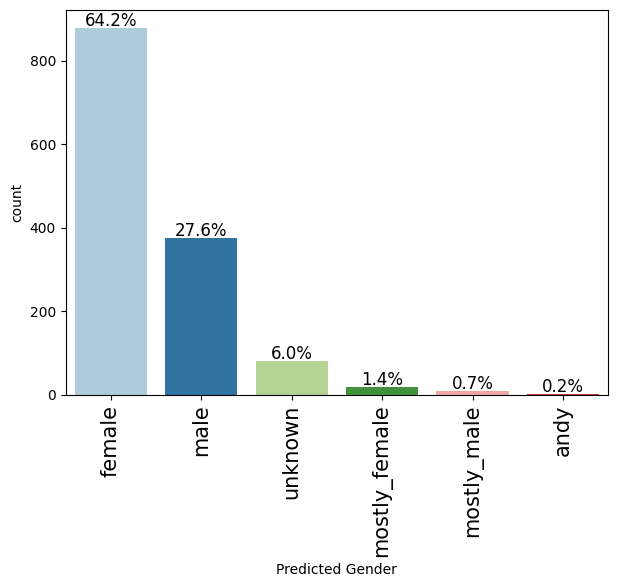

In [ ]:
labeled_barplot(dfo_grouped, 'Predicted Gender', perc=True)

**Observations:**
70.5% of past orders were done by females and 29.2% were done by males.

**Inisght for target audience: mostly female**

#### Date & Time of Orders

##### Df_grouped

In [ ]:
dfo_grouped['Paid at'].dtype

dtype('O')

**Observation:** The column 'Paid at' is currently an object, in order for future analysis, this needs to be converted to a date-time data type.


In [ ]:
# Convert 'Paid at' to datetime with UTC
dfo_grouped['Paid at'] = pd.to_datetime(dfo_grouped['Paid at'], utc=True)

# Check the data type again to confirm
print(dfo_grouped['Paid at'].dtype)



datetime64[ns, UTC]


**Observation:** The 'Paid at' column is now in a datetime format

In [ ]:
# Extract year and month from the 'Paid at' column
dfo_grouped['Year'] = dfo_grouped['Paid at'].dt.year
dfo_grouped['Month'] = dfo_grouped['Paid at'].dt.month


In [ ]:
orders_by_year = dfo_grouped.groupby('Year').size().reset_index(name='Order Count')
orders_by_year

,Year,Order Count
0,2022,387
1,2023,654
2,2024,327


**Observations:**
- Most orders were placed in 2023 with 654 orders
- In 2022 there were 387 orders
- In 2024 there were 330 orders

In [ ]:
# Group by 'Year' and 'Month' and count the number of orders
orders_by_month_year = dfo_grouped.groupby(['Year', 'Month']).size().reset_index(name='Order Count')

# Display the grouped data
orders_by_month_year


,Year,Month,Order Count
0,2022,5,36
1,2022,6,59
2,2022,7,51
3,2022,8,53
4,2022,9,26
5,2022,10,21
6,2022,11,89
7,2022,12,52
8,2023,1,60
9,2023,2,96


**Observations:**

Taking a closer look at the month and the year, it is now evident why in 2022 there were much less orders. The orders started to be recorded in the 5th month of the year, indicating that there was no data for the first 4 month of the year, leading to less overall orders.

In 2024, the orders analysed are up the the 8th month of the year (August), also indicating that due to 4 month missing in the year, this data is not yet recorded.

To better understand this kind of data, we can display the months corresponding to the years next to each other:

In [ ]:
# Using pivot to reshape the above dataframe for easier comprehension:

# Pivot the DataFrame
pivoted_orders = orders_by_month_year.pivot(index='Month', columns='Year', values='Order Count')

# Display the pivoted DataFrame
pivoted_orders


Year,2022,2023,2024
Month,,,
1,NaN,60.0,43.0
2,NaN,96.0,15.0
3,NaN,54.0,46.0
4,NaN,38.0,21.0
5,36.0,75.0,66.0
6,59.0,90.0,79.0
7,51.0,57.0,40.0
8,53.0,31.0,17.0
9,26.0,19.0,NaN


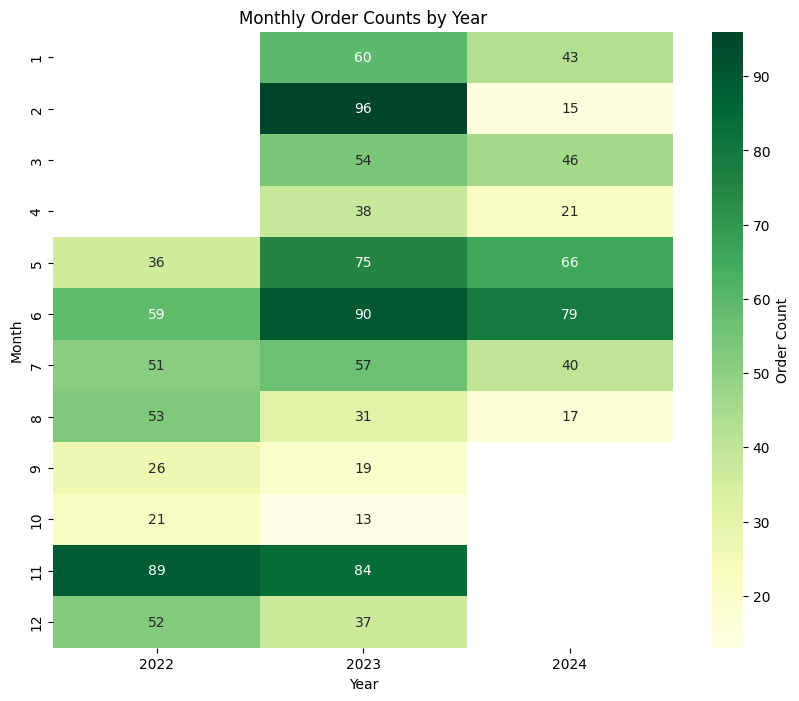

In [ ]:
#Visualizing the data

plt.figure(figsize=(10, 8))
sns.heatmap(pivoted_orders, annot=True, fmt=".0f", cmap="YlGn", cbar_kws={'label': 'Order Count'})
plt.title('Monthly Order Counts by Year')
plt.xlabel('Year')
plt.ylabel('Month')
plt.show()


**Observations:** Visualizing the data, there is a clear pattern:

- 2022 was the year with least orders
- November (11) has been consecutively one of the highest order months in 2022 and 2023
- May (5), June (6) have been cosnecutively the highest order months in 2023 and 2024
- February (2) 2023 was the highest order month for that year with a wide gap for 2024. The client attributes this to a natural catastrophe happening to a favorite vacation spot of their traget audience. The drop form 96 orders in 2023 and 15 in 2024 supports this.
- January (1), March (3) and July (7) have been the second highest order months for both 2023 and 2024.

##### Doing the same on original dataframe

In [ ]:
# Convert 'Paid at' to datetime with UTC
dfo2['Paid at'] = pd.to_datetime(dfo2['Paid at'], utc=True)

# Check the data type again to confirm
print(dfo2['Paid at'].dtype)

datetime64[ns, UTC]


In [ ]:
# Extract year and month from the 'Paid at' column
dfo2['Year'] = dfo2['Paid at'].dt.year
dfo2['Month'] = dfo2['Paid at'].dt.month

In [ ]:
orders_by_year_org = dfo2.groupby('Year').size().reset_index(name='Order Count')
orders_by_year_org

,Year,Order Count
0,2022.0,387
1,2023.0,654
2,2024.0,327


In [ ]:
# Checking if columns were added
dfo2.head(1)

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month
0,#2372SP,gvelazquezu@gmail.com,2024-08-09 20:55:37+00:00,2024-08-09 17:52:38 -0600,yes,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,Mercado Pago Tarjetas,0.0,0.0,NaN,web,714.5,Ciudad de México,Ciudad de México,2024.0,8.0


#### Shipping methods of orders

In [ ]:
dfo_grouped.value_counts('Shipping Method')

,count
Shipping Method,
Estándar (2 a 5 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería,382
Envío gratis. *Estándar,258
Express (1 a 2 días hábiles) * Los tiempos de entrega son responsabilidad de las empresas de paquetería,146
Estándar (2 a 3 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería,127
Estándar (3 - 5 Días Hábiles) - Septiembre Gratis,106
Estándar Gratis (3 - 5 Días Hábiles),87
Express Gratis (2 a 3 Días hábiles),82
Express (2 a 3 Días hábiles),44
Estándar (3 - 5 Días Hábiles),42


**Observations:**

There are many different shipping methods. These may have been adjusted over time on the Shopify admin page, thus creating many different versions of Standard and Express Shipping. Currently Tintarella has the following shipping methos:

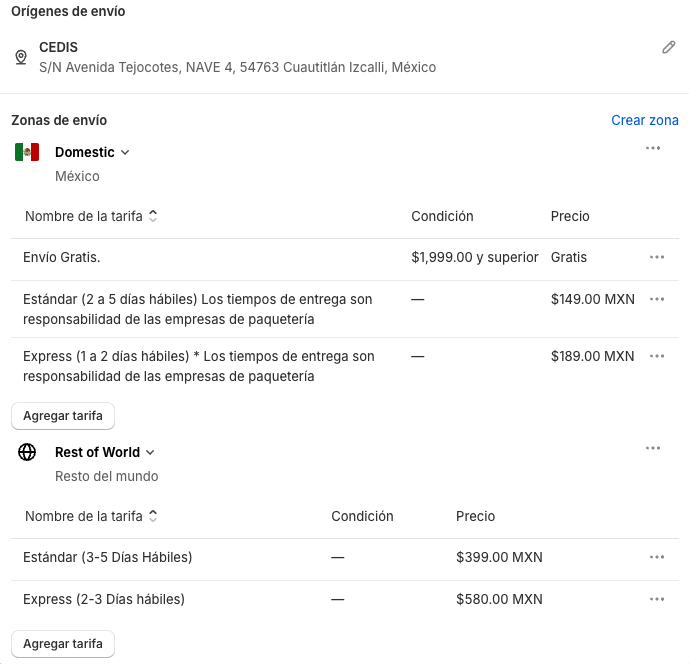

Notable is as well that the Free shipping, given to clients who purchase more than 1999 MXN is the second most common type of shipping, indicating that:

1. This is a good threshold for free shipping
2. Many orders are above 1999MXN

For easier comprehension, we can divide shipping methods into 3 categories: Estandard, Express and Gratis to get an overall sense of which shipping methods have been used more:

In [ ]:
# Mapping dictionary to categorize shipping methods
shipping_mapping = {
    'Estándar (2 a 5 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Estandard',
    'Estándar (2 a 3 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Estandard',
    'Estándar (3 - 5 Días Hábiles)': 'Estandard',
    'Estándar (3-5 Días Hábiles)': 'Estandard',
    'Estándar (2 a 3 Días hábiles) *Solo interior de la república': 'Estandard',
    'Envío Tintarella (Sólo aplica en Área Metropolitana)': 'Estandard',
    # Add other similar 'Estándar' methods as needed

    'Express (1 a 2 días hábiles) * Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Express',
    'Express (2 a 3 Días hábiles)': 'Express',
    'Express (1 a 2 dias) * Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Express',
    'Envío TINTARELLA - ENTREGA GARANTIZADA viernes 23 Diciembre. (Sólo aplica en Área Metropolitana)': 'Express',
    'Express (2-3 Días hábiles)': 'Express',
    # Add other similar 'Express' methods as needed

    'Envío gratis. *Estándar': 'Gratis',
    'Express (1-2 Días Hábiles) *Sujeto a tiempos de empresas de paquetería - GRATIS': 'Gratis',
    'Express Gratis (2 a 3 Días hábiles)': 'Gratis',
    'Estándar (3 - 5 Días Hábiles) - Septiembre Gratis': 'Gratis',
    'Estándar Gratis (3 - 5 Días Hábiles)': 'Gratis',
    'Envío Gratis.': 'Gratis',
    'Envío gratis. *Express': 'Gratis',
    'Envío Express Gratis.': 'Gratis',
    # Add other similar 'Gratis' methods as needed
}

# Default to 'Other' if the shipping method is not in the mapping
shipping_mapping = {**{key: 'Estandard' for key in shipping_mapping if 'Estándar' in key},
                    **{key: 'Express' for key in shipping_mapping if 'Express' in key},
                    **{key: 'Gratis' for key in shipping_mapping if 'Gratis' in key}}


In [ ]:
# Map the 'Shipping Method' column to the new categories
dfo_grouped['Shipping Category'] = dfo_grouped['Shipping Method'].replace(shipping_mapping)

# Verify the mapping
dfo_grouped[['Shipping Method', 'Shipping Category']].head(10)


,Shipping Method,Shipping Category
0,Express (2 a 3 Días hábiles),Express
1,Estándar (3 - 5 Días Hábiles),Estandard
2,Express (2 a 3 Días hábiles),Express
3,Estándar (3 - 5 Días Hábiles),Estandard
4,Express (2 a 3 Días hábiles),Express
5,Express (2 a 3 Días hábiles),Express
6,Estándar Gratis (3 - 5 Días Hábiles),Gratis
7,Express (2 a 3 Días hábiles),Express
8,Express Gratis (2 a 3 Días hábiles),Gratis
9,Estándar (3 - 5 Días Hábiles),Estandard


In [ ]:
# Get the value counts for each shipping category
shipping_counts = dfo_grouped['Shipping Category'].value_counts()

# Display the results
shipping_counts


,count
Shipping Category,
Estandard,820
Gratis,305
Express,208
Envío TINTARELLA - ENTREGA GARANTIZADA viernes 23 Diciembre. (Sólo aplica en Área Metropolitana),4
Envío Tintarella (Sólo aplica en Área Metropolitana),1


**Observations:**

- Most used shipping method is Estandard with 822 counts
- Express shipping is the least used shipping method is 209 counts - HIGH VALUE CUSTOMERS
- Free Shipping (Gratis) has been granetd 305 times

In [ ]:
#Overview of Shipping amount paid by buyers
dfo_grouped.value_counts('Shipping')

,count
Shipping,
0.0,608
99.0,443
149.0,175
134.0,44
189.0,43
122.0,39
399.0,13
580.0,3


<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




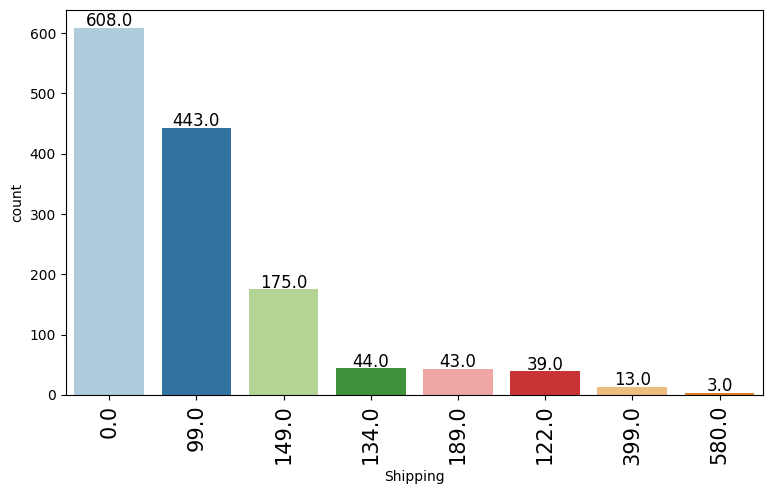

In [ ]:
#Visualizing Data
labeled_barplot(dfo_grouped, 'Shipping')

FREAKS: HOW CAN WE HAVE 611 ORDERS WITH 0 SHIPPING YET ONLY 305 WITH ENVIO GRATIS?

In [ ]:
# Exploring how many different values there are in Lineitem requires shipping
dfo.value_counts('Lineitem requires shipping')

,count
Lineitem requires shipping,
True,3548
False,141


##### Doing the same on dfo2 Dataframe


In [ ]:
# Mapping dictionary to categorize shipping methods
shipping_mapping = {
    'Estándar (2 a 5 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Estandard',
    'Estándar (2 a 3 días hábiles) Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Estandard',
    'Estándar (3 - 5 Días Hábiles)': 'Estandard',
    'Estándar (3-5 Días Hábiles)': 'Estandard',
    'Estándar (2 a 3 Días hábiles) *Solo interior de la república': 'Estandard',
    'Envío Tintarella (Sólo aplica en Área Metropolitana)': 'Estandard',
    # Add other similar 'Estándar' methods as needed

    'Express (1 a 2 días hábiles) * Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Express',
    'Express (2 a 3 Días hábiles)': 'Express',
    'Express (1 a 2 dias) * Los tiempos de entrega son responsabilidad de las empresas de paquetería': 'Express',
    'Envío TINTARELLA - ENTREGA GARANTIZADA viernes 23 Diciembre. (Sólo aplica en Área Metropolitana)': 'Express',
    'Express (2-3 Días hábiles)': 'Express',
    # Add other similar 'Express' methods as needed

    'Envío gratis. *Estándar': 'Gratis',
    'Express (1-2 Días Hábiles) *Sujeto a tiempos de empresas de paquetería - GRATIS': 'Gratis',
    'Express Gratis (2 a 3 Días hábiles)': 'Gratis',
    'Estándar (3 - 5 Días Hábiles) - Septiembre Gratis': 'Gratis',
    'Estándar Gratis (3 - 5 Días Hábiles)': 'Gratis',
    'Envío Gratis.': 'Gratis',
    'Envío gratis. *Express': 'Gratis',
    'Envío Express Gratis.': 'Gratis',
    # Add other similar 'Gratis' methods as needed
}

# Default to 'Other' if the shipping method is not in the mapping
shipping_mapping = {**{key: 'Estandard' for key in shipping_mapping if 'Estándar' in key},
                    **{key: 'Express' for key in shipping_mapping if 'Express' in key},
                    **{key: 'Gratis' for key in shipping_mapping if 'Gratis' in key}}


In [ ]:
# Map the 'Shipping Method' column to the new categories
dfo2['Shipping Category'] = dfo2['Shipping Method'].replace(shipping_mapping)

# Verify the mapping
dfo2[['Shipping Method', 'Shipping Category']].head(10)


,Shipping Method,Shipping Category
0,Envío Gratis.,Gratis
1,NaN,NaN
2,NaN,NaN
3,Estándar (2 a 5 días hábiles) Los tiempos de e...,Estandard
4,NaN,NaN
5,NaN,NaN
6,NaN,NaN
7,Estándar (3-5 Días Hábiles),Estandard
8,NaN,NaN
9,NaN,NaN


In [ ]:
# Get the value counts for each shipping category
shipping_counts = dfo_grouped['Shipping Category'].value_counts()

# Display the results
shipping_counts


,count
Shipping Category,
Estandard,820
Gratis,305
Express,208
Envío TINTARELLA - ENTREGA GARANTIZADA viernes 23 Diciembre. (Sólo aplica en Área Metropolitana),4
Envío Tintarella (Sólo aplica en Área Metropolitana),1


In [ ]:
# Verify the shipping column was added
dfo2.head(1)

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Shipping Category
0,#2372SP,gvelazquezu@gmail.com,2024-08-09 20:55:37+00:00,2024-08-09 17:52:38 -0600,yes,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,Mercado Pago Tarjetas,0.0,0.0,NaN,web,714.5,Ciudad de México,Ciudad de México,2024.0,8.0,Gratis


**Observations:** There are 141 that are marked as lineitem does not require shipping

#### EMail Marketing

<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




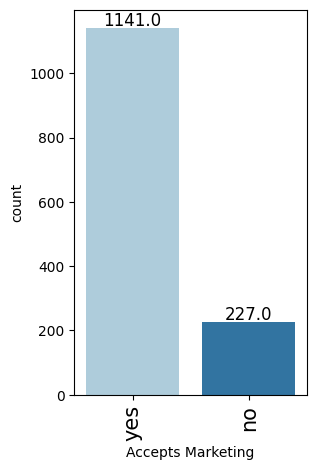

In [ ]:
labeled_barplot(dfo_grouped, 'Accepts Marketing')

<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




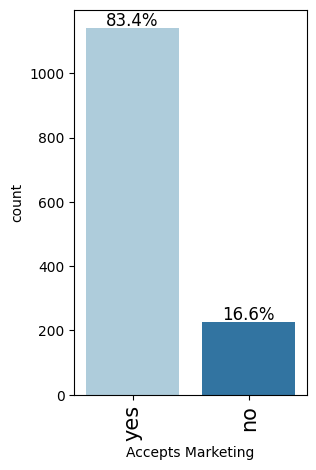

In [ ]:
labeled_barplot(dfo_grouped, 'Accepts Marketing', perc=True)

**Observations:**
83.3% of buyers accept eMail marketing

#### Taxes

In [ ]:
dfo_grouped.value_counts('Taxes')

,count
Taxes,
0.0,1368


**Observation:**
No taxes are deglossed in this column. It can be considered to be dropped as it does not contain any relevant information

In [ ]:
#Dropping the Taxes column
dfo_grouped = dfo_grouped.drop('Taxes', axis=1)

#### Source

In [ ]:
# Exploring how many different values there are in Source
dfo.value_counts('Source')

,count
Source,
web,1337
580111,31


<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




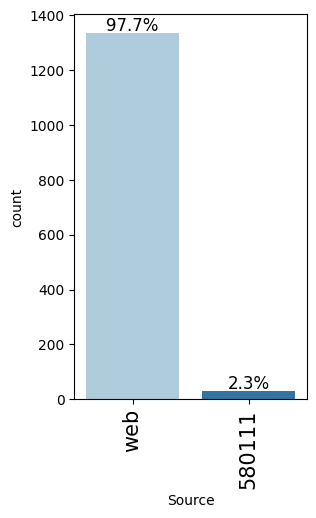

In [ ]:
labeled_barplot(dfo_grouped, 'Source', perc=True)

**Observations:** 97.7% of orders are identified as sourced from the web while 2.3% are attributed to 580111 (unknown source)


#### Tags

In [ ]:
# Exploring how many different values there are in Tags
dfo.value_counts('Tags')

,count
Tags,
ENTREGADO,192
Loox - Referral Friend Discount,12
Loox - Upsell,4
Loox - Photo/Video Review Discount,2


**Observations:**
- Entregado is an iternal tag with no insight to target audience
- Loox Referral Friend discount is the most commonly used (12 times), followed by Loox-Upsell (4) and Loox - Photo/Video Review Discount (2). - this is important for target audience insight as it speaks to a personal connection to the brand and enhanced trust through a friend recommendation.

In [ ]:
# Filter the DataFrame for rows where the 'Tags' column is 'Loox - Referral Friend Discount'
friend_referral = dfo_grouped[dfo_grouped['Tags'] == 'Loox - Referral Friend Discount']

# Display the filtered DataFrame for further insights
friend_referral


,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Predicted Gender,Year,Month,Shipping Category
178,#1179SP,vickyzairick@gmail.com,2022-08-13 17:24:54+00:00,2022-08-15 08:34:52 -0500,yes,122.0,NaN,Estándar (3 - 5 Días Hábiles),2022-08-13 12:24:52 -0500,799.0,True,fulfilled,VICTORIA ZAIRICK ZORRILLA DE SAN MARTIN,"MAGNOLIAS #12, CLUSTER 222, LOMAS DE ANGELOPOL...","MAGNOLIAS #12, CLUSTER 222",LOMAS DE ANGELOPOLIS SECCION I,NaN,SAN ANDRES CHOLULA,'72830,PUE,MX,222 258 1898,VICTORIA ZAIRICK ZORRILLA DE SAN MARTIN,"MAGNOLIAS #12, CLUSTER 222, LOMAS DE ANGELOPOL...","MAGNOLIAS #12, CLUSTER 222",LOMAS DE ANGELOPOLIS SECCION I,NaN,SAN ANDRES CHOLULA,'72830,PUE,MX,222 258 1898,NaN,PayPal Express Checkout,0.0,0.0,Loox - Referral Friend Discount,web,0.0,Puebla,Puebla,559.30,681.30,0.00,1,['TOADS NIÑO - 8'],[559.3],[7506382405233.0],female,2022,8,Estandard
234,#1235SP,miyp77@hotmail.com,2022-10-13 17:20:26+00:00,2022-10-13 13:07:21 -0500,yes,0.0,NaN,Estándar (3 - 5 Días Hábiles) - Septiembre Gratis,2022-10-13 12:20:25 -0500,NaN,True,fulfilled,Isabel Yañez,"Parque de cadiz, 30",Parque de cadiz,30,NaN,Estado de mexico,'52786,MEX,MX,55 9193 2703,Isabel Yañez,"Parque de cadiz, 30",Parque de cadiz,30,NaN,Estado de mexico,'52786,MEX,MX,55 9193 2703,NaN,PayPal Express Checkout,0.0,0.0,Loox - Referral Friend Discount,web,"849.0, 899.0, 0.0",Estado de México,Estado de México,1798.00,1798.00,1748.00,4,['TRAJE DE BAÑO NIÑO MODELO RUBY OCTOPUS - 5-6...,"[849.0, 899.0]","[7506382417663.0, 7506382418912.0, 75063824189...",female,2022,10,Gratis
483,#1484SP,mayunakatani@yahoo.com.mx,2023-02-10 14:01:01+00:00,2023-02-10 14:46:06 -0600,yes,99.0,LXZ-LFJBJPD,Estándar (2 a 3 días hábiles) Los tiempos de e...,2023-02-10 08:01:00 -0600,1429.0,True,fulfilled,Mayumi Nakatani,"Emilio Carranza,184-8, La Magdalena","Emilio Carranza,184-8",La Magdalena,NaN,Df(La Magdalena),'10910,DF,MX,55 5409 6757,Mayumi Nakatani,"Emilio Carranza,184-8, La Magdalena","Emilio Carranza,184-8",La Magdalena,NaN,Df(La Magdalena),'10910,DF,MX,55 5409 6757,NaN,PayPal Express Checkout,0.0,0.0,Loox - Referral Friend Discount,web,0.0,Ciudad de México,Ciudad de México,1028.88,1127.88,114.32,2,"['TRAJE DE BAÑO HOMBRE FROGY LINE - L', 'TRAJE...",[571.6],"[7506382412125.0, 7506382412064.0]",female,2023,2,Estandard
498,#1499SP,mdiazherna5@gmail.com,2023-02-13 01:13:13+00:00,2023-02-13 10:42:52 -0600,yes,0.0,LXZ-KK1GBFH,Envío gratis. *Estándar,2023-02-12 19:13:12 -0600,1429.0,True,fulfilled,María Guadalupe Teresa Díaz Hernandez,"Fuente de Cantaritos 8, Lomas de Tecamachalco",Fuente de Cantaritos 8,Lomas de Tecamachalco,NaN,Mexico,'53950,MEX,MX,55 8534 7478,María Guadalupe Teresa Díaz Hernandez,"Fuente de Cantaritos 8, Lomas de Tecamachalco",Fuente de Cantaritos 8,Lomas de Tecamachalco,NaN,Mexico,'53950,MEX,MX,55 8534 7478,NaN,PayPal Express Checkout,0.0,0.0,Loox - Referral Friend Discount,web,0.0,Estado de México,Estado de México,1543.32,1543.32,171.48,3,"['TRAJE DE BAÑO HOMBRE LEMONROPE - M', 'TRAJE ...",[571.6],"[7506382411456.0, 7506382412118.0, 75063824115...",mostly_female,2023,2,Estandard
596,#1597SP,yare_04_22@hotmail.com,2023-03-31 23:40:48+00:00,2023-03-31 18:18:59 -0600,yes,0.0,LXZ-929FQZM,Envío gratis. *Estándar,2023-03-31 17:40:47 -0600,849.0,True,fulfilled,Yareli Guzman Gonzalez,"Padre Quintana #69, Centro",Padre Quintana 

#### Discount Code

In [ ]:
# Exploring how many different values there are in Tags
dfo.value_counts('Discount Code')

,count
Discount Code,
ENVÍO GRATIS,141
HOLA10,40
Bienvenido,5
KIDSANIVERSARIO,4
TEQUESMAYO22,3
5tolove,2
cg10,2
LXZ-KK1GBFH,1
Y157DKQP3TKW,1


**Observations:** The most commonly used Discount Code is 'Envio Gratis' which indicates that customers are **highly succeptible to free shipping promotions**

#### Location

In [ ]:
#
dfo_grouped.value_counts('Billing Country')

,count
Billing Country,
MX,1345
US,21
EC,1
ES,1


<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




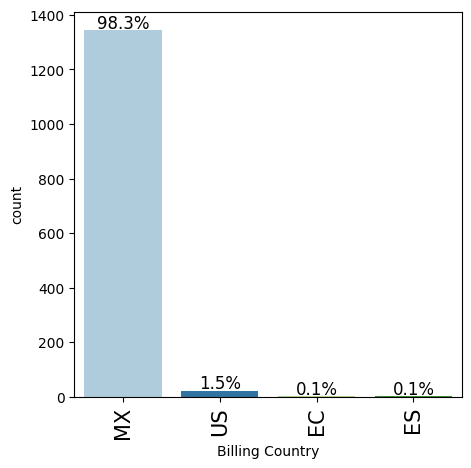

In [ ]:
labeled_barplot(dfo_grouped, 'Billing Country', perc=True)

**Observations:** The mayority of orders are in Mexico with 98.3% (1348 orders) followed by the United States with 1.5% (21 orders)

In [ ]:
# Checking Provinces with the most orders
dfo_grouped.value_counts('Billing Province')

,count
Billing Province,
DF,697
MEX,225
JAL,73
QRO,37
NL,36
GTO,28
PUE,28
COAH,26
YUC,22


<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




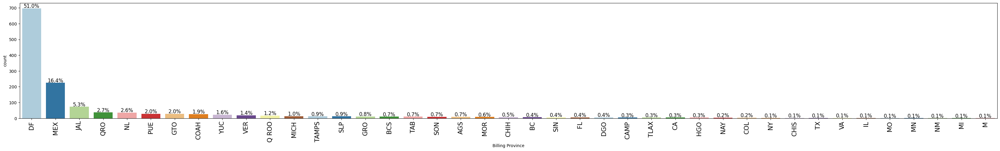

In [ ]:
#Visualizing Data
labeled_barplot(dfo_grouped, 'Billing Province', perc=True)

**Observations:**

- 50.8% of orders are made in Distrito Federal (697 orders)
- 16.6% are made in the state of Mexico (228 orders)
- Jalisco is the third strongest market with 5.3% (73)

- 2.6-2.7% of orders are made to Queretaro (QRO) with 37 orders and Nuevo Leon (NL) with 36 orders

- 2% of orders are made to Guanajato (GTO) and Puebla (PUE) with 28 orders and Coahuila (COAH) with 26 orders

- Yucatan (YUC), Veracruz (VER) and Quintant Roo (Q Roo) still show orders over a total of 1% with 22, 19 and 17 orders respectively.

It would be of interest to check if billing and shipping provinces match

In [ ]:
# Get value counts for Billing Province
billing_counts = dfo_grouped['Billing Province'].value_counts()

# Get value counts for Shipping Province
shipping_counts = dfo_grouped['Shipping Province'].value_counts()


In [ ]:
# Combine the value counts into a single DataFrame
billing_shipping_comparison = pd.DataFrame({
    'Billing Province Count': billing_counts,
    'Shipping Province Count': shipping_counts
})

# Fill NaN values with 0 to indicate no occurrences
billing_shipping_comparison = billing_shipping_comparison.fillna(0).astype(int)

# Sort the DataFrame by 'Billing Province Count' in descending order
billing_shipping_comparison = billing_shipping_comparison.sort_values(by='Billing Province Count', ascending=False)

# Display the sorted DataFrame
billing_shipping_comparison


,Billing Province Count,Shipping Province Count
DF,697,694
MEX,225,225
JAL,73,69
QRO,37,35
NL,36,31
GTO,28,26
PUE,28,28
COAH,26,26
YUC,22,24
VER,19,16


In [ ]:
# Filter the DataFrame where the Billing Province and Shipping Province counts don't match
mismatched_provinces = billing_shipping_comparison[billing_shipping_comparison['Billing Province Count'] != billing_shipping_comparison['Shipping Province Count']]

# Display the mismatched rows
mismatched_provinces


,Billing Province Count,Shipping Province Count
DF,697,694
JAL,73,69
QRO,37,35
NL,36,31
GTO,28,26
YUC,22,24
VER,19,16
Q ROO,17,18
SLP,12,13
TAMPS,12,10


**Observations:** There are some orders that have a different billing province than shipping province. Notabely the most for NL 5 orders. Looking at these orders for further analysis

In [ ]:
# Filter the DataFrame where Billing Province and Shipping Province don't match
mismatched_rows = dfo_grouped[dfo_grouped['Billing Province'] != dfo_grouped['Shipping Province']]

# View shape of how many rows don't match the Billing and Shipping Province
mismatched_rows.shape


(61, 52)

**Observations:** There are 62 orders where the billing and Shipping information don't match

<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




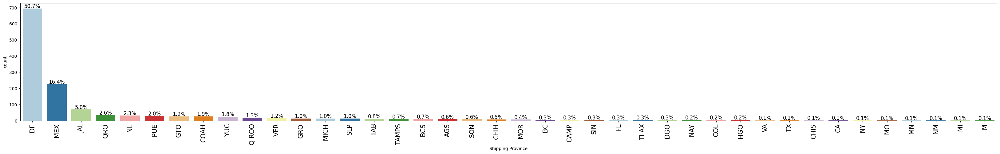

In [ ]:
# Viewving distribution of shipping provinces
labeled_barplot(dfo_grouped, 'Shipping Province', perc=True)

<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




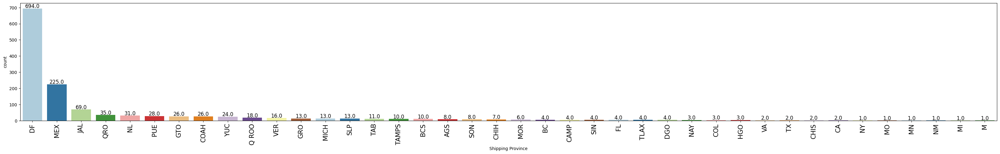

In [ ]:
# Viewving distribution of shipping provinces
labeled_barplot(dfo_grouped, 'Shipping Province')

**Observations:** The main distribution pattern of the Shipping Provinces is the same as the Billing Provinces, with the main differnces being:

- Distrito Federal (DF) is reduced from 50.6% for Billing Province to 50.8% for Shipping Province

- Jalisco (JAL) is aumented from 5.0% for Billing Province to 5.3% for Shipping Province

- Nuevo Leon (NL) is aumented from 2.30% for Billing Province to 2.6% for Shipping Province

Most orders are SHIPPED (there are 63 orders where biling and shipping province don't match) to (Provinces with less than 1 % are not icluded):
1. Distrito Federal 50.6% - 694 orders
2. Mexico 16.6% - 227 orders
3. Jalisco 5% - 69 orders
4. Queretaro 2.6% - 35 orders
5. Nuevo Leon 2.3% - 31 orders
6. Puebla 2% - 28 orders
7. Guanajuato 1.9% - 26 orders
8. Coahuila 1.9% - 26 orders
9. Yucatan 1.8% - 24 orders
10. Quintana Roo 1.4% - 19 orders
11. Veracruz 1.2% - 16 orders


For easier comprehension this data should be visualized on a Map

**CARO HAS DONE THIS **

In [ ]:
# Number of unique values in the 'Shipping City' column
unique_shipping_cities = dfo_grouped['Shipping City'].nunique()

# Display the result
unique_shipping_cities


344

In [ ]:
# Understan how many different cities are in the orders
dfo_grouped.value_counts('Shipping City')

,count
Shipping City,
Mexico,120
CDMX,98
Ciudad de México,93
Cdmx,73
Ciudad de Mexico,54
Huixquilucan,46
Zapopan,28
Ciudad De MÉxico,26
México,26


**Observations:** There are 329 differnt city names. Due to differnces in typing of the cities there are multiple entries for the same cities, shown as different ones. These need to be standardised. THIS WILL TAKE FOREVER TO PUT INTO A DICTIONARY

In [ ]:
# Number of unique values in the 'Shipping Zip' column
unique_shipping_zip = dfo_grouped['Shipping Zip'].nunique()

# Display the result
unique_shipping_zip

454

In [ ]:
# Count the number of NaN values in the 'Shipping Zip' column
nan_shipping_zip = dfo_grouped['Shipping Zip'].isna().sum()

# Display the result
print(nan_shipping_zip)


30


In [ ]:
# Filter the rows where 'Shipping Zip' is NaN
nan_shipping_zip_rows = dfo_grouped[dfo_grouped['Shipping Zip'].isna()]

# Display the filtered DataFrame
nan_shipping_zip_rows


,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Predicted Gender,Year,Month,Shipping Category
814,#1815SP,jime_colunga@hotmail.com,2023-07-07 14:56:05+00:00,2023-07-07 12:52:11 -0600,yes,0.0,NaN,NaN,2023-07-07 08:56:05 -0600,NaN,False,fulfilled,Jimena Colunga,"Pontevedra 166, Lomas De Chapultepec (privadas...",Pontevedra 166,Lomas De Chapultepec (privadas Pedregal),NaN,San Luis Potosí,'78295,SLP,MX,444 828 4765,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,San Luis Potosí,NaN,2827.0,2827.0,0.0,3,['TRAJE DE BAÑO HOMBRE MODELO ORIGANIMAL YELLO...,"[1429.0, 549.0, 849.0]","[7506382420601.0, 7506382421110.0, 75063824211...",female,2023,7,NaN
830,#1831SP,marianne.zapfe@gmail.com,2023-07-18 04:00:30+00:00,2023-07-18 09:18:09 -0600,yes,0.0,HOLA10,NaN,2023-07-17 22:00:29 -0600,NaN,False,fulfilled,Marianne Zapfe Guillen,"Arauja 28, Bosque real",Arauja 28,Bosque real,NaN,Huixquilucan,'52774,MEX,MX,55 1474 0992,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,0.0,Estado de México,NaN,1529.1,1529.1,169.9,1,['TRAJE DE BAÑO MUJER MODELO ORIGANIMAL YELLOW...,[1699.0],[7506382422704.0],female,2023,7,NaN
832,#1833SP,fran_dezfe@hotmail.com,2023-07-18 21:47:07+00:00,2023-07-18 16:26:48 -0600,yes,0.0,NaN,NaN,2023-07-18 15:47:07 -0600,NaN,False,fulfilled,Francisco Rafael Fernandez Ladron de Guevara,"48, Zona centro",48,Zona centro,NaN,Silao,'36100,GTO,MX,'+52 477 581 6120,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,0.0,Guanajuato,NaN,1429.0,1429.0,0.0,1,['TRAJE DE BAÑO HOMBRE MODELO TUNA NET - M'],[1429.0],[7506382420533.0],male,2023,7,NaN
836,#1837SP,livasraquel@hotmail.com,2023-07-20 14:25:42+00:00,2023-07-20 10:41:30 -0600,no,0.0,NaN,NaN,2023-07-20 08:25:42 -0600,NaN,False,fulfilled,Raquel Livas,"Mirador San Agustín 125, Mirador del Campestre",Mirador San Agustín 125,Mirador del Campestre,NaN,SPPG,'66266,NL,MX,81 8020 6690,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,0.0,Nuevo León,NaN,1748.0,1748.0,0.0,2,['TRAJE DE BAÑO NIÑA MODELO ORIGANIMAL YELLOW ...,"[899.0, 849.0]","[7506382421691.0, 7506382421158.0]",female,2023,7,NaN
837,#1838SP,amparoleonq@gmail.com,2023-07-20 15:32:28+00:00,2023-07-20 10:46:55 -0600,no,0.0,NaN,NaN,2023-07-20 09:32:28 -0600,NaN,False,fulfilled,Amparo r Leon Quintero l,"Vereda del halcon 38, Puerta de hierro",Vereda del halcon 38,Puerta de hierro,NaN,Zapopan,'45116,JAL,MX,33 1604 1201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,0.0,Jalisco,NaN,5825.0,5825.0,0.0,5,['TRAJE DE BAÑO MUJER MODELO ORIGANIMAL YELLOW...,"[1699.0, 899.0, 1429.0]","[7506382422698.0, 7506382421707.0, 75063824217...",female,2023,7,NaN
848,#1849SP,livasraquel@hotmail.com,2023-07-24 21:56:19+00:00,2023-07-24 16:28:59 -0600,yes,0.0,NaN,NaN,2023-07-24 15:56:19 -0600,NaN,False,fulfilled,Raquel Livas,"Mirador San Agustin 125, Mirador del Campestre",Mirador San Agustin 125,Mirador del Campestre,NaN,San Pedro Garza Garcia,'66266,NL,MX,81 8020 6690,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Nuevo León,NaN,849.0,849.0,0.0,1,['TRAJE DE BAÑO NIÑO MODELO ORIGANIMAL YELLOW ...,[849.0],[7506382421127.0],female,2023,7,NaN
854,#1855SP,nancymirasol@h

**Observations:** There are 455 different Zip codes in the order dataset with 30 orders missing values. The rows that have the missing values have no information at all for Shipping since probably: No shipping was required


#### Payment Method

In [ ]:
dfo_grouped.value_counts('Payment Method')

,count
Payment Method,
PayPal Express Checkout,777
Credit/Debit card by PayPal,531
Pago con tarjeta de crédito y débito,39
Conekta,8
Mercado Pago Checkout Pro,6
PayPal Express Checkout + Credit/Debit card by PayPal,3
Credit/Debit card by PayPal + PayPal Express Checkout,2
Mercado Pago Tarjetas,1
PayPal Express Checkout + manual,1


<ipython-input-657-2a7c55bb5c92>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




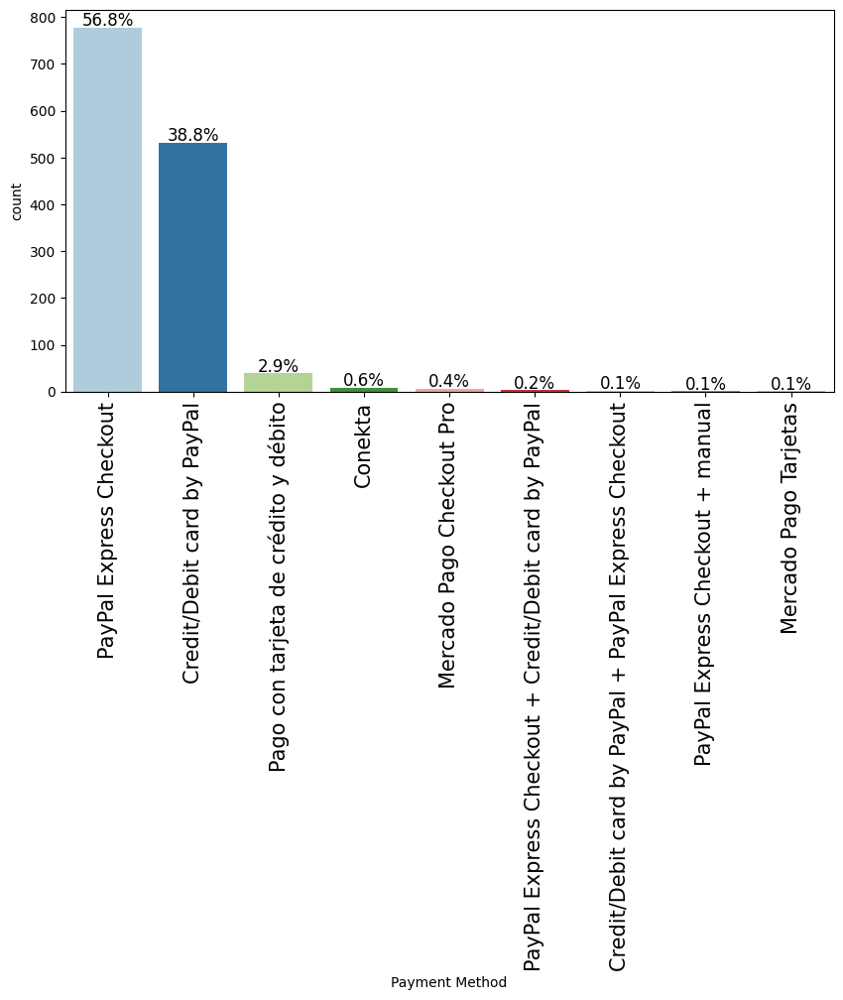

In [ ]:
# Visualizing most used payment methods
labeled_barplot(dfo_grouped, 'Payment Method', perc=True)

**Observations:**

95.6% of orders were paid using PayPal with 56.7% of orders using their Express Checkout and 38.9% using their Credit / Debit Card Checkout.

Only 2.8% of orders were paid using 'Pago con tarjeta de credito y debito', 0.6% with 'Conekta' and 0.4% with Mercado Pago Checkout Pro

In [ ]:
56.7+38.9

95.6

#### Linitem (Products)

For this analysis we will use the previously seperated dataframe products_data.

We want to understand:
- Top 10 sold products (sorted by Lineitem name or sku) - During Bivariate Analysis we want to check this over time
- Most common price paid for lineitem
- Average price for lineitem

##### Products_data

In [ ]:
# Check Dataframe for products
products_data.head(5)

,Name,Paid at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Shipping City,Shipping Zip,Shipping Province,Payment Method
0,#2372SP,2024-08-09 14:55:37 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7506382420359.0,Mex,'01090,DF,Mercado Pago Tarjetas
1,#2372SP,NaN,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7506382411579.0,NaN,NaN,NaN,NaN
2,#2372SP,NaN,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7506382412118.0,NaN,NaN,NaN,NaN
3,#2371SP,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991.0,Coyoacán,'04200,DF,PayPal Express Checkout
4,#2371SP,NaN,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7506382420915.0,NaN,NaN,NaN,NaN


In [ ]:
# Grouping by 'Lineitem sku' and aggregating to get the count and the first occurrence of 'Lineitem name'
top_products = products_data.groupby('Lineitem sku').agg(
    count=('Lineitem sku', 'size'),
    Lineitem_name=('Lineitem name', 'first')
).sort_values(by='count', ascending=False)

# Setting Index
top_products= top_products.reset_index()

# Display the result
top_products


,Lineitem sku,count,Lineitem_name
0,7.506382e+12,29,Traje De Baño Hombre O-Ray-Gami - M
1,7.506382e+12,26,Traje De Baño Hombre Pink Origamix - M
2,7.506382e+12,25,Traje De Baño Hombre Frogy Line - M
3,7.506382e+12,24,Traje De Baño Hombre Lemonrope - M
4,7.506382e+12,22,Traje De Baño Hombre Modelo Tuna Net - M
5,7.506382e+12,21,Traje De Baño Hombre Mahi Mahi - M
6,7.506382e+12,18,Traje De Baño Hombre Mahi Mahi - L
7,7.506382e+12,17,Traje De Baño Hombre Modelo Navy Fugu - L
8,7.506382e+12,17,Traje De Baño Hombre Modelo Fungi - L
9,7.506382e+12,16,Traje De Baño Hombre Modelo Jelly Party - M


**Observations:**


- Top 34 products are purchased for Men & Boys (including size in name)
- Most common product sold for girls is Traje De Baño Niña Modelo Fungi - 3-4A
- Womean top sold is ranked at 79

Since the size of products is contained within the name, it would be good to clean this off in a new column called 'Clean Lineitem name' to better grasp which prints are sold most often.

In [ ]:
# Convert the 'Lineitem name' column to a string
products_data['Lineitem name'] = products_data['Lineitem name'].astype(str)


In [ ]:
# Define a function to clean the lineitem names
def clean_lineitem_name(name):
    return name.split('-')[0].strip()

# Apply the function to clean the 'Lineitem name' column
products_data['Clean Lineitem name'] = products_data['Lineitem name'].apply(clean_lineitem_name)

# Display the cleaned column
products_data[['Lineitem name', 'Clean Lineitem name']].head()


,Lineitem name,Clean Lineitem name
0,Traje De Baño Hombre Modelo Marine Knots - M,Traje De Baño Hombre Modelo Marine Knots
1,Traje De Baño Hombre Pink Origamix - M,Traje De Baño Hombre Pink Origamix
2,Traje De Baño Hombre Frogy Line - M,Traje De Baño Hombre Frogy Line
3,Traje De Baño Niño Modelo Color Frogs - 7-8A,Traje De Baño Niño Modelo Color Frogs
4,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,Traje De Baño Niño Modelo Origanimal Aqua


In [ ]:
# Grouping by 'Clean Lineitem name' and aggregating to get the count and the first occurrence of 'Lineitem name' from the products_data
top_products_cleaned = products_data.value_counts('Clean Lineitem name').reset_index()

# Display the result
top_products_cleaned

#Note that the first row is cut off at O, yet the name of this model is O-Ray-Gami

,Clean Lineitem name,count
0,TRAJE DE BAÑO HOMBRE O,60
1,Traje De Baño Niño Modelo Tuna Net,53
2,TRAJE DE BAÑO HOMBRE MAHI MAHI,51
3,Traje De Baño Hombre Modelo Tuna Net,50
4,TRAJE DE BAÑO HOMBRE MODELO NAVY FUGU,49
5,TRAJE DE BAÑO NIÑO MODELO NAVY FUGU,45
6,Traje De Baño Niño Modelo Color Frogs,43
7,Traje De Baño Hombre Modelo Fungi,41
8,CAMISETA PARA EL SOL COLOR NAVY BLUE,41
9,TRAJE DE BAÑO NIÑO MODELO TOUCANDY,39


**Observations:**

- Most sold products are for men and boys ranking top 11 products sold
- Product top 12 is the first item for girls
- Product top 79 is the first item for women

This indiacted that most women are actually buying for their male children, could be due to:

- Girls want to have an opinion in their clothes
- Fitting sizes over internet are easier to know for boys / men than girls / women
- The female customers that purchase don't have daughters, mostly sons

In [ ]:
#visualizing top 20 products
# Create a new DataFrame with the top 20 products
top_products_50 = top_products_cleaned.head(50)

top_products_50


,Clean Lineitem name,count
0,TRAJE DE BAÑO HOMBRE O,60
1,Traje De Baño Niño Modelo Tuna Net,53
2,TRAJE DE BAÑO HOMBRE MAHI MAHI,51
3,Traje De Baño Hombre Modelo Tuna Net,50
4,TRAJE DE BAÑO HOMBRE MODELO NAVY FUGU,49
5,TRAJE DE BAÑO NIÑO MODELO NAVY FUGU,45
6,Traje De Baño Niño Modelo Color Frogs,43
7,Traje De Baño Hombre Modelo Fungi,41
8,CAMISETA PARA EL SOL COLOR NAVY BLUE,41
9,TRAJE DE BAÑO NIÑO MODELO TOUCANDY,39


In [ ]:
# Define a function to determine the gender category
def determine_gender(name):
    name = name.lower()  # Convert to lowercase to ensure case-insensitive matching
    if 'hombre' in name:
        return 'Men'
    elif 'mujer' in name:
        return 'Women'
    elif 'niño' in name:
        return 'Boy'
    elif 'nino' in name:
        return 'Boy'
    elif 'niña' in name:
        return 'Girl'
    elif 'nina' in name:
        return 'Girl'
    elif 'bebé'in name:
        return 'Baby'
    elif 'bebe' in name:
        return 'Baby'
    elif 'camiseta' in name:
        return 'Camiseta'
    elif 'gorra' in name:
        return 'Gorra'
    elif 'mascota' in name:
        return 'Dogs'
    else:
        return 'Unknown'

# Apply the function to create the 'Lineitem Gender' column
products_data['Lineitem Gender'] = products_data['Clean Lineitem name'].apply(determine_gender)

# Display the updated DataFrame
print(products_data[['Clean Lineitem name', 'Lineitem Gender']].head())


                         Clean Lineitem name Lineitem Gender
0   Traje De Baño Hombre Modelo Marine Knots             Men
1         Traje De Baño Hombre Pink Origamix             Men
2            Traje De Baño Hombre Frogy Line             Men
3      Traje De Baño Niño Modelo Color Frogs             Boy
4  Traje De Baño Niño Modelo Origanimal Aqua             Boy


In [ ]:
products_data.value_counts('Lineitem Gender')

,count
Lineitem Gender,
Men,1350
Boy,1007
Girl,683
Camiseta,231
Unknown,157
Women,144
Baby,82
Dogs,27
Gorra,9


**Observations:**
Products sold by 'Product Gender':
- 1368 for men
- 1031 for boys
- 706 for girls
- 242 Camisetas
- 158 Unknown (due to inconsitent naming)
- 147 for women
- 86 for babys
- 27 for Dogs
- 9 for Hats

##### Doing the same for dfo_grouped Dataframe

For another analysis the above will be done to the dfo_grouped data frame. Additionally we will create the following new columns:
- Lineitem Gender (showing for which gender the item is thought)
- Lineitem Model (showing to which collection the lineitem corresponds)




In [ ]:
# Convert the 'Lineitem name' column to a string
dfo_grouped['Lineitem name'] = dfo_grouped['Lineitem name'].astype(str)


In [ ]:
# Check the datatype of the 'Lineitem name' column
print(dfo_grouped['Lineitem name'].dtype)


object


In [ ]:
# Define a function to clean the lineitem names
def clean_lineitem_name(name):
    return name.split('-')[0].strip()

# Apply the function to clean the 'Lineitem name' column
dfo_grouped['Clean Lineitem name'] = dfo_grouped['Lineitem name'].apply(clean_lineitem_name)

# Display the cleaned column
dfo_grouped[['Lineitem name', 'Clean Lineitem name']].head()


,Lineitem name,Clean Lineitem name
0,['TRAJE DE BAÑO HOMBRE MODELO LIME LINE - L'],['TRAJE DE BAÑO HOMBRE MODELO LIME LINE
1,['TRAJE DE BAÑO HOMBRE DRAGON FLY - S'],['TRAJE DE BAÑO HOMBRE DRAGON FLY
2,['TRAJE DE BAÑO HOMBRE LOBSTERS - XL'],['TRAJE DE BAÑO HOMBRE LOBSTERS
3,['TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS -...,['TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS
4,['TRAJE DE BAÑO HOMBRE O-RAY-GAMI - S'],['TRAJE DE BAÑO HOMBRE O


In [ ]:
# Define a function to determine the gender category
def determine_gender(name):
    name = name.lower()  # Convert to lowercase to ensure case-insensitive matching
    if 'hombre' in name:
        return 'Men'
    elif 'mujer' in name:
        return 'Women'
    elif 'niño' in name:
        return 'Boy'
    elif 'nino' in name:
        return 'Boy'
    elif 'niña' in name:
        return 'Girl'
    elif 'nina' in name:
        return 'Girl'
    elif 'bebé'in name:
        return 'Baby'
    elif 'bebe' in name:
        return 'Baby'
    elif 'camiseta' in name:
        return 'Camiseta'
    elif 'gorra' in name:
        return 'Gorra'
    elif 'mascota' in name:
        return 'Dogs'
    else:
        return 'Unknown'

# Apply the function to create the 'Lineitem Gender' column
dfo_grouped['Lineitem Gender'] = dfo_grouped['Clean Lineitem name'].apply(determine_gender)

# Display the updated DataFrame
print(dfo_grouped[['Clean Lineitem name', 'Lineitem Gender']].head())


                            Clean Lineitem name Lineitem Gender
0       ['TRAJE DE BAÑO HOMBRE MODELO LIME LINE             Men
1             ['TRAJE DE BAÑO HOMBRE DRAGON FLY             Men
2               ['TRAJE DE BAÑO HOMBRE LOBSTERS             Men
3  ['TRAJE DE BAÑO HOMBRE MODELO CANDY PENGUINS             Men
4                      ['TRAJE DE BAÑO HOMBRE O             Men


In [ ]:
dfo_grouped.value_counts('Lineitem Gender')

,count
Lineitem Gender,
Men,602
Boy,294
Girl,216
Camiseta,87
Unknown,64
Women,57
Baby,32
Dogs,12
Gorra,4


**Observation:** Since the grouped data contains multiple entries of items per Lineitem Name, only the first one is taken - as such this dataset does not work for this example.

In [ ]:
dfo_grouped = dfo_grouped.drop('Lineitem Gender', axis=1)

##### Doing the same for dfo2 Dataframe

For another analysis the above will be done to the dfo2 data frame. Additionally we will create the following new columns:
- Lineitem Gender (showing for which gender the item is thought)
- Lineitem Model (showing to which collection the lineitem corresponds)




In [ ]:
# Convert the 'Lineitem name' column to a string
dfo2['Lineitem name'] = dfo2['Lineitem name'].astype(str)


In [ ]:
# Check the datatype of the 'Lineitem name' column
print(dfo2['Lineitem name'].dtype)


object


In [ ]:
# Define a function to clean the lineitem names
def clean_lineitem_name(name):
    return name.split('-')[0].strip()

# Apply the function to clean the 'Lineitem name' column
dfo2['Clean Lineitem name'] = dfo2['Lineitem name'].apply(clean_lineitem_name)

# Display the cleaned column
dfo2[['Lineitem name', 'Clean Lineitem name']].head()


,Lineitem name,Clean Lineitem name
0,Traje De Baño Hombre Modelo Marine Knots - M,Traje De Baño Hombre Modelo Marine Knots
1,Traje De Baño Hombre Pink Origamix - M,Traje De Baño Hombre Pink Origamix
2,Traje De Baño Hombre Frogy Line - M,Traje De Baño Hombre Frogy Line
3,Traje De Baño Niño Modelo Color Frogs - 7-8A,Traje De Baño Niño Modelo Color Frogs
4,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,Traje De Baño Niño Modelo Origanimal Aqua


In [ ]:
# Define a function to determine the gender category
def determine_gender(name):
    name = name.lower()  # Convert to lowercase to ensure case-insensitive matching
    if 'hombre' in name:
        return 'Men'
    elif 'mujer' in name:
        return 'Women'
    elif 'niño' in name:
        return 'Boy'
    elif 'nino' in name:
        return 'Boy'
    elif 'niña' in name:
        return 'Girl'
    elif 'nina' in name:
        return 'Girl'
    elif 'bebé'in name:
        return 'Baby'
    elif 'bebe' in name:
        return 'Baby'
    elif 'camiseta' in name:
        return 'Camiseta'
    elif 'gorra' in name:
        return 'Gorra'
    elif 'mascota' in name:
        return 'Dogs'
    else:
        return 'Unknown'

# Apply the function to create the 'Lineitem Gender' column
dfo2['Lineitem Gender'] = dfo2['Clean Lineitem name'].apply(determine_gender)

# Display the updated DataFrame
print(dfo2[['Clean Lineitem name', 'Lineitem Gender']].head())


                         Clean Lineitem name Lineitem Gender
0   Traje De Baño Hombre Modelo Marine Knots             Men
1         Traje De Baño Hombre Pink Origamix             Men
2            Traje De Baño Hombre Frogy Line             Men
3      Traje De Baño Niño Modelo Color Frogs             Boy
4  Traje De Baño Niño Modelo Origanimal Aqua             Boy


In [ ]:
#Checking count of items sold
dfo2.value_counts('Lineitem Gender')

,count
Lineitem Gender,
Men,1350
Boy,1007
Girl,683
Camiseta,231
Unknown,156
Women,144
Baby,82
Dogs,27
Gorra,9


In [ ]:
unisex_products = dfo2[dfo2['Lineitem Gender'] == 'Unknown']
unisex_products.head()

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Shipping Category,Clean Lineitem name,Lineitem Gender
6,#2371SP,maggie_parra@hotmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:26:47 -0600,1,Tiburones - 7-8A,849.0,NaN,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,424.5,NaN,NaN,NaN,NaN,NaN,Tiburones,Unknown
135,#2334SP,guede_majo@hotmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-07-17 15:13:00 -0600,1,Espirales - 11-12A,509.4,849.0,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,Espirales,Unknown
422,#2223SP,e.martinezdelrio@hotmail.com,2024-05-24 03:17:12+00:00,2024-05-24 12:53:10 -0600,yes,1528.2,149.0,0.0,1677.2,NaN,0.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-05-23 21:17:11 -0600,1,Flamingo Rosa - 7-8A,509.4,849.0,7.506382e+12,True,fulfilled,Eugenia Martinez del rio,"Bosque de Olinala 9, Casa 9",Bosque de Olinala 9,Casa 9,NaN,Ciudad de Mexico,'52784,DF,MX,+525591977007,Eugenia Martinez del rio,"Bosque de Olinala 9, Casa 9",Bosque de Olinala 9,Casa 9,NaN,Ciudad de Mexico,'52784,DF,MX,+525591977007,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,0.0,Ciudad de México,Ciudad de México,2024.0,5.0,Estandard,Flamingo Rosa,Unknown
452,#2211SP,pabloramdi@gmail.com,2024-05-22 00:29:41+00:00,2024-05-22 11:57:38 -0600,yes,1738.8,149.0,0.0,1887.8,NaN,0.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-05-21 18:29:41 -0600,1,Moscas - XL,779.4,1299.0,7.506382e+12,True,fulfilled,Pablo Ramirez,"M Galeana 16B, Tlalpan Centro, Alcaldia Tlalpa...","M Galeana 16B, Tlalpan Centro, Alcaldia Tlalpan","entre Matamoros y Magisterio Nacional, casa mo...",NaN,CDMX,'14000,DF,MX,+525514024099,Pablo Ramirez,"M Galeana 16B, Tlalpan Centro, Alcaldia Tlalpa...","M Galeana 16B, Tlalpan Centro, Alcaldia Tlalpan","entre Matamoros y Magisterio Nacional, casa mo...",NaN,CDMX,'14000,DF,MX,+525514024099,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Ciudad de México,Ciudad de México,2024.0,5.0,Estandard,Moscas,Unknown
453,#2211SP,pabloramdi@gmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-05-21 18:29:41 -0600,1,Aqua Peach - XL,959.4,1599.0,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,Aqua Peach,Unknown


**Observations:** These products do not contain any information into what type of product it is or for whom this is. This should be optimized for furture analysis.

Additionally it would be good information to know when and where these items were purchased, the gender of the buyer and any additional information. As there are many missing values since one order may have multiple products (rows) these need to be filled.

For this, a duplicate of the dfo2 dataframe will be created. The products_data dataframe can be discarted as it does not contain any relevant information prior

In [ ]:
dfo_grouped.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1368 entries, 0 to 1367
Data columns (total 53 columns):
 #   Column                       Non-Null Count  Dtype              
---  ------                       --------------  -----              
 0   Name                         1368 non-null   object             
 1   Email                        1365 non-null   object             
 2   Paid at                      1368 non-null   datetime64[ns, UTC]
 3   Fulfilled at                 1366 non-null   object             
 4   Accepts Marketing            1368 non-null   object             
 5   Shipping                     1368 non-null   float64            
 6   Discount Code                218 non-null    object             
 7   Shipping Method              1338 non-null   object             
 8   Created at                   1368 non-null   object             
 9   Lineitem compare at price    707 non-null    object             
 10  Lineitem requires shipping   1368 non-null   obj

In [ ]:
# Creating a copy of the current dataframe for future analysis of products
# IMPORTANT NOTE! This dataframe shuold ONLY be used to understand individual product patterns, NOT to understand pruchasing behavior
products = dfo2.copy()

In [ ]:
products.head()

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Shipping Category,Clean Lineitem name,Lineitem Gender
0,#2372SP,gvelazquezu@gmail.com,2024-08-09 20:55:37+00:00,2024-08-09 17:52:38 -0600,yes,2143.5,0.0,0.0,2143.5,NaN,2143.5,Envío Gratis.,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Modelo Marine Knots - M,1429.0,NaN,7.506382e+12,True,fulfilled,Gerardo Velazquez Urbina,"Dallas 85, 301",Dallas 85,301,NaN,Mex,'03810,DF,MX,5544846138,Gerardo Velazquez,"Canoa 235, 1-2004",Canoa 235,1-2004,NaN,Mex,'01090,DF,MX,5544846138,NaN,Mercado Pago Tarjetas,0.0,0.0,NaN,web,714.5,Ciudad de México,Ciudad de México,2024.0,8.0,Gratis,Traje De Baño Hombre Modelo Marine Knots,Men
1,#2372SP,gvelazquezu@gmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Pink Origamix - M,1429.0,NaN,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN,NaN,Traje De Baño Hombre Pink Origamix,Men
2,#2372SP,gvelazquezu@gmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 14:55:36 -0600,1,Traje De Baño Hombre Frogy Line - M,1429.0,NaN,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,714.5,NaN,NaN,NaN,NaN,NaN,Traje De Baño Hombre Frogy Line,Men
3,#2371SP,maggie_parra@hotmail.com,2024-08-09 19:26:47+00:00,2024-08-09 17:50:23 -0600,yes,1698.0,149.0,0.0,1847.0,NaN,1698.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7.506382e+12,True,fulfilled,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,Maggie Parra,"Cerro San andres 29, Campestre churubusco",Cerro San andres 29,Campestre churubusco,NaN,Coyoacán,'04200,DF,MX,+525528883710,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,424.5,Ciudad de México,Ciudad de México,2024.0,8.0,Estandard,Traje De Baño Niño Modelo Color Frogs,Boy
4,#2371SP,maggie_parra@hotmail.com,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:26:47 -0600,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7.506382e+12,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,424.5,NaN,NaN,NaN,NaN,NaN,Traje De Baño Niño Modelo Origanimal Aqua,Boy


In [ ]:
products.shape

(3689, 54)

In [ ]:
products.isna().sum()

,0
Name,0
Email,7
Paid at,2321
Fulfilled at,2323
Accepts Marketing,2321
Subtotal,2321
Shipping,2321
Taxes,2321
Total,2321
Discount Code,3471


**Observations**:

- There are 3773 individual produts that have been ordered. Of those, 2420 have missing values because these rows belong to the same 'Name' (Order ID).

- Filling the missing values in rows that share the same 'Name' for the following columns: 'Paid at', 'Fulfilled at', 'Shipping Name', 'Shipping City', 'Shipping Zip, 'Shipping Province', 'Shipping Country', 'Shipping Province Name', 'Year', 'Month'. There is at least one row for each value of 'Name' that contains this information. If no row sharing the same 'Name' has a value for these columns, leave as NaN. This is especially important for Bivariate analysis

- There is no column of Predicted Gender in this Dataset, it will have to me merged from the dfo_grouped DataFrame

In [ ]:
# Merge the products_data DataFrame with the Predicted Gender from dfo_grouped
products = products.merge(
    dfo_grouped[['Name', 'Predicted Gender']],
    on='Name',
    how='left'
)

# Display the result to verify
products.value_counts('Predicted Gender')


,count
Predicted Gender,
female,2458
male,936
unknown,220
mostly_female,44
mostly_male,22
andy,9


In [ ]:
# Check for any missing values in the Predicted Gender column
products['Predicted Gender'].isna().sum()


0

In [ ]:
# Specifying which columns are to be filled
columns_to_fill = ['Paid at', 'Fulfilled at', 'Shipping Name', 'Shipping City', 'Shipping Zip',
                   'Shipping Province', 'Shipping Country', 'Shipping Province Name', 'Year', 'Month']


In [ ]:
# Apply forward fill to the specified columns within each 'Name' group
products[columns_to_fill] = products.groupby('Name')[columns_to_fill].ffill()

# Display the result to verify
products.isna().sum()


,0
Name,0
Email,7
Paid at,0
Fulfilled at,4
Accepts Marketing,2321
Subtotal,2321
Shipping,2321
Taxes,2321
Total,2321
Discount Code,3471


**Observation:**
- Predicted Gender column successfully added

- After inserting missing values, Year, Month and Paid at have 0 missing values.

- Fullfilled at has 4 missing values. Shipping Name, Shipping City, Shipping Zip, Shipping Province, Shipping Country, Shipping Province Name all have 72 rows with missing values. This may come from the 30 orders that did not require shipping and as such don't contain this information

### Bivariate Analysis

- Gender & Lineitem sku = most purchased items by gender
- Gender & Location = is there a pattern to more males / females per region or is this equivalent throughout?
- eMail makreting and gender
- Total orders per year / month (paid at) dataframe pivoted_orders with gender = is there a pattern when more males / females purchase? Can this be attributed to marketing ?
- Total orders per year / month (paid at) dataframe pivoted_orders with lineitem sku = during what time are what products more popular?
- Total orders per year / month (paid at) dataframe pivoted_orders with location = has there been a shift in location purchases over the timeline?
- Shipping methods & Location & year / month (STACKED BARPLOT)
-  referral loox & order value
- Shipping Province
- Payment method over time
- Lineitem gender vs. Gender of customers
- Lineitem pruchased over years / months
- Lineitem purchased by location


### Orders & Gender

In [ ]:
dfo_grouped.value_counts('Predicted Gender')

,count
Predicted Gender,
female,878
male,377
unknown,82
mostly_female,19
mostly_male,9
andy,3


**Observations:** 966 orders by females, 400 by males

# **5. Products & Gender**

Here we have 4 dataframes deriving form 2 main dataframes:

1. final_data = all content collapsed per eMail & Lineitem Gender individually as columns (9)

2. products = all products purchased individually (not pero order) and Lineitem Gender is one column

Out of which we derive:


- male_purchases = This Dataframe has the Lineitem Gender Exploded

- male_purchases_final = This Dataframe has the Lineitem Gender Collapsed

- female_purchases = This Dataframe has the Lineitem Gender Exploded

- female_purchases_final = This Dataframe has the Lineitem Gender Collapsed

#### Preparing Data


In [ ]:
#Creating a security copy
products_final = products.copy()

In [ ]:
# Create a pivot table to count the number of items purchased for each Lineitem Gender
gender_counts = products_final.pivot_table(
    index='Email',
    columns='Lineitem Gender',
    values='Lineitem quantity',
    aggfunc='sum',
    fill_value=0
).reset_index()

# Display the result
gender_counts.head()


Lineitem Gender,Email,Baby,Boy,Camiseta,Dogs,Girl,Gorra,Men,Unknown,Women
0,52475134@prodigy.net.mx,0,2,0,0,1,0,0,0,0
1,ANALUCIAGZA@GMAIL.COM,0,0,0,0,0,0,2,0,0
2,ARMANDOGONZALEZ10@HOTMAIL.COM,0,0,0,0,0,0,1,0,0
3,Ander_8@hotmail.com,0,0,0,0,0,0,3,0,0
4,C.j.graham@me.com,0,0,0,0,0,0,1,0,0


In [ ]:
# Sample aggregation functions based on the column types
aggregation_functions = {
    'Subtotal': 'sum',
    'Total': 'sum',
    'Discount Amount': 'sum',
    'Lineitem quantity': 'sum',
    'Lineitem name': lambda x: list(x.dropna().unique()),
    'Lineitem price': lambda x: list(x.dropna().unique()),
    'Lineitem sku': lambda x: list(x.dropna().unique())
}

# Define a function to concatenate non-null unique values in a column
def concat_unique(series):
    return ', '.join(map(str, series.dropna().unique()))

# Default aggregation for all other columns: concatenate unique values
default_agg = {col: concat_unique for col in products_final.columns if col not in aggregation_functions}

# Combine the specific aggregation rules with the default
agg_funcs = {**default_agg, **aggregation_functions}

# Group by the "Email" column and apply the appropriate aggregation function
products_grouped = products_final.groupby('Email', as_index=False).agg(agg_funcs)


In [ ]:
# Merge the grouped DataFrame with the gender counts DataFrame
final_data = pd.merge(products_grouped, gender_counts, on='Email', how='left')

# Display the final DataFrame
final_data.head(1)


,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Shipping Category,Clean Lineitem name,Lineitem Gender,Predicted Gender,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Baby,Boy,Camiseta,Dogs,Girl,Gorra,Men,Unknown,Women
0,"#2017SP, #2005SP",52475134@prodigy.net.mx,"2023-12-08 23:32:20+00:00, 2023-11-29 22:27:38...","2023-12-11 10:13:30 -0600, 2023-11-30 09:58:05...","yes, no",99.0,0.0,,Estándar (2 a 5 días hábiles) Los tiempos de e...,"2023-12-08 17:32:20 -0600, 2023-11-29 16:27:38...",,True,fulfilled,"Alejandra Arellano, Alejandra Muriel","Hacienda de la Luz 35 Hacienda de las Palmas,...","Hacienda de la Luz 35 Hacienda de las Palmas,...",Casa 3,,Huixquilucan,'52763,MEX,MX,55 2653 2490,"Alejandra Arellano, Alejandra Muriel","Hacienda de la Luz 35 Hacienda de las Palmas,...","Hacienda de la Luz 35 Hacienda de las Palmas,...",Casa 3,,Huixquilucan,'52763,MEX,MX,55 2653 2490,,PayPal Express Checkout,0.0,0.0,,web,0.0,Estado de México,Estado de México,2023.0,"12.0, 11.0",Estandard,"Traje De Baño Niño Modelo Color Frogs, Traje D...","Boy, Girl",female,2332.2,2530.2,164.8,3,"[Traje De Baño Niño Modelo Color Frogs - 3-4A,...","[849.0, 799.0]","[7506382420977.0, 7506382420960.0, 75063824215...",0,2,0,0,1,0,0,0,0


#### Males

In [ ]:
# Filter the DataFrame where 'Predicted Gender' is 'male'


male_purchases = products[products['Predicted Gender'] == 'male'] # This Dataframe has the Lineitem Gender Exploded

male_purchases_final = final_data[final_data['Predicted Gender'] == 'male'] #This Dataframe has the Lineitem Gender Collapsed


In [ ]:
# Checking how many products were purchased by males
male_purchase_count = male_purchases.shape[0]
male_purchase_count

936

In [ ]:
# Check for which audience the male purchases were made

male_pruchase_audience = male_purchases.value_counts('Lineitem Gender')
male_pruchase_audience

,count
Lineitem Gender,
Men,503
Boy,179
Girl,89
Unknown,75
Camiseta,37
Women,29
Baby,11
Gorra,7
Dogs,6


In [ ]:
# Obtaining percentage for better comparison:
# Calculate the percentage of each 'Lineitem Gender' in the male_purchases DataFrame
male_pruchase_audience_perc = male_purchases['Lineitem Gender'].value_counts(normalize=True) * 100

# Display the result
male_pruchase_audience_perc

,proportion
Lineitem Gender,
Men,53.739316
Boy,19.123932
Girl,9.508547
Unknown,8.012821
Camiseta,3.952991
Women,3.098291
Baby,1.175214
Gorra,0.747863
Dogs,0.641026


**Observations:**

Insights to Male Purchasing behavior (per product, not per order)

- Male 53.2% - 532 products
- Boy 19.7% - 197 products
- Girl 9.1% - 91 products
- Unknown 7.8% - 78 products
- Camisetas 3.9% - 39 products
- Women 3.5% - 35 products
- Baby 1.2% - 12 products
- Dogs 0.9% - 9 products
- Hats 0.7% - 7 products

  - Men buy most products for themselves

**Observations:**

Each year the most dominant category men pruchase is for men, followed by boys. In 2022 and 2023, girls came in as third most repeated category, yet in 2024, Camisetas were purchased more by men than Girl products. No products for women were bought in 2022, yet there is a clear trend of increased purchases from 2022 to 2023/2024.

##### Visualizing trends over time

In [ ]:
# Group by 'Year', 'Month', and 'Lineitem Gender' and count the occurrences
male_purchase_trends = male_purchases.groupby(['Year', 'Month', 'Lineitem Gender']).size().reset_index(name='Count')

# Display the grouped data
male_purchase_trends.head()


,Year,Month,Lineitem Gender,Count
0,2022.0,5.0,Boy,3
1,2022.0,5.0,Girl,2
2,2022.0,5.0,Men,19
3,2022.0,5.0,Unknown,10
4,2022.0,6.0,Boy,5


In [ ]:
# Group the data by 'Year' and 'Lineitem Gender' and count occurrences
male_purchase_audience = male_purchases[male_purchases['Year'].isin([2022, 2023, 2024])]
male_purchase_audience_grouped = male_purchase_audience.groupby(['Year', 'Lineitem Gender']).size().reset_index(name='Count')

# Pivot the grouped data
male_purchase_audience_pivot = male_purchase_audience_grouped.pivot(index='Year', columns='Lineitem Gender', values='Count')

# Display the pivoted DataFrame
male_purchase_audience_pivot



Lineitem Gender,Baby,Boy,Camiseta,Dogs,Girl,Gorra,Men,Unknown,Women
Year,,,,,,,,,
2022.0,NaN,51.0,7.0,2.0,39.0,NaN,137.0,40.0,1.0
2023.0,8.0,84.0,14.0,3.0,42.0,5.0,280.0,33.0,17.0
2024.0,3.0,44.0,16.0,1.0,8.0,2.0,86.0,2.0,11.0


Lineitem Gender  Baby   Boy  Camiseta  Dogs  Girl  Gorra    Men  Unknown  \
Year                                                                       
2022.0            NaN  51.0       7.0   2.0  39.0    NaN  137.0     40.0   
2023.0            8.0  84.0      14.0   3.0  42.0    5.0  280.0     33.0   
2024.0            3.0  44.0      16.0   1.0   8.0    2.0   86.0      2.0   

Lineitem Gender  Women  Baby_Proportion  Boy_Proportion  Camiseta_Proportion  \
Year                                                                           
2022.0             1.0              NaN        0.184116             0.025271   
2023.0            17.0         0.016461        0.172840             0.028807   
2024.0            11.0         0.017341        0.254335             0.092486   

Lineitem Gender  Dogs_Proportion  Girl_Proportion  Gorra_Proportion  \
Year                                                                  
2022.0                  0.007220         0.140794               NaN   
2023.

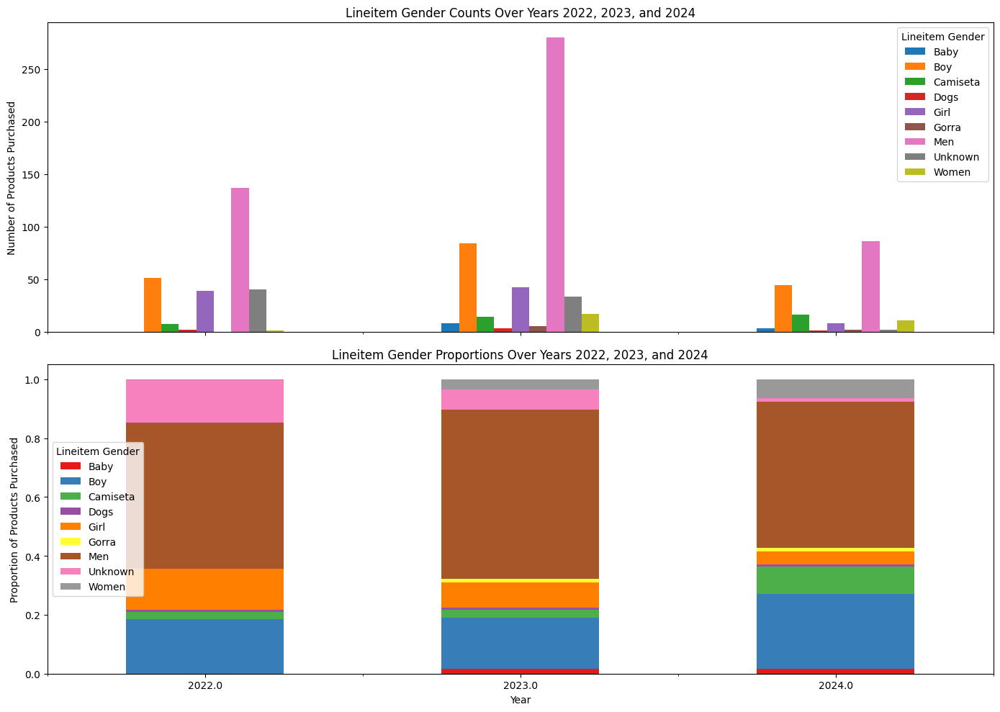

In [ ]:

# Step 1: Group the data by 'Year' and 'Lineitem Gender' and count occurrences
male_purchase_audience = male_purchases[male_purchases['Year'].isin([2022, 2023, 2024])]
male_purchase_audience_grouped = male_purchase_audience.groupby(['Year', 'Lineitem Gender']).size().reset_index(name='Count')

# Step 2: Pivot the grouped data
male_purchase_audience_pivot = male_purchase_audience_grouped.pivot(index='Year', columns='Lineitem Gender', values='Count')

# Step 3: Calculate the proportion for each Lineitem Gender within each year
male_purchase_audience_proportion = male_purchase_audience_pivot.div(male_purchase_audience_pivot.sum(axis=1), axis=0)

# Combine the count and proportion data into a single DataFrame
male_purchase_audience_combined = male_purchase_audience_pivot.copy()
for col in male_purchase_audience_proportion.columns:
    male_purchase_audience_combined[col + '_Proportion'] = male_purchase_audience_proportion[col]

# Display the combined DataFrame
print(male_purchase_audience_combined)

# Step 4: Plot the combined data
fig, ax = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

# Plot the counts
male_purchase_audience_pivot.plot(kind='bar', ax=ax[0])
ax[0].set_title('Lineitem Gender Counts Over Years 2022, 2023, and 2024')
ax[0].set_ylabel('Number of Products Purchased')
ax[0].legend(title='Lineitem Gender')

# Plot the proportions
male_purchase_audience_proportion.plot(kind='bar', stacked=True, ax=ax[1], colormap='Set1')
ax[1].set_title('Lineitem Gender Proportions Over Years 2022, 2023, and 2024')
ax[1].set_ylabel('Proportion of Products Purchased')
ax[1].legend(title='Lineitem Gender')

plt.xlabel('Year')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [ ]:
# Pivot the data to have 'Year' and 'Month' as the index and 'Lineitem Gender' as columns
male_purchase_trends_pivot = male_purchase_trends.pivot_table(index=['Year', 'Month'], columns='Lineitem Gender', values='Count', fill_value=0)

# Display the pivoted data
male_purchase_trends_pivot


Lineitem Gender  Baby   Boy  Camiseta  Dogs  Girl  Gorra   Men  Unknown  Women
Year   Month                                                                  
2022.0 5.0        0.0   3.0       0.0   0.0   2.0    0.0  19.0     10.0    0.0
       6.0        0.0   5.0       0.0   0.0   2.0    0.0   8.0      8.0    0.0
       7.0        0.0  12.0       4.0   1.0   6.0    0.0  13.0      7.0    0.0
       8.0        0.0  14.0       1.0   0.0  12.0    0.0  35.0      3.0    0.0
       9.0        0.0   2.0       1.0   0.0   1.0    0.0  14.0      1.0    0.0
       10.0       0.0   2.0       0.0   0.0   3.0    0.0   4.0      3.0    0.0
       11.0       0.0   8.0       1.0   1.0   7.0    0.0  26.0      6.0    0.0
       12.0       0.0   5.0       0.0   0.0   6.0    0.0  18.0      2.0    1.0
2023.0 1.0        0.0  10.0       0.0   2.0   7.0    1.0  37.0     12.0    0.0
       2.0        0.0  26.0       0.0   0.0  11.0    0.0  29.0     13.0    0.0
       3.0        0.0   8.0       7.0   0.0   3.0    1.0  27.0      2.0    1.0
       4.0        0.0   3.0       1.0   0.0   2.0    0.0  13.0      1.0    2.0
       5.0        1.0   5.0       1.0   0.0   6.0    0.0  45.0      1.0    3.0
       6.0        0.0   4.0       0.0   0.0   0.0    0.0  41.0      3.0    0.0
       7.0        0.0   3.0       0.0   0.0   0.0    0.0  34.0      1.0    0.0
       8.0        0.0   0.0       1.0   0.0   3.0    0.0  14.0      0.0    0.0
       9.0        0.0   0.0       2.0   1.0   0.0    1.0  12.0      0.0    2.0
       10.0       1.0   0.0       0.0   0.0   0.0    2.0   1.0      0.0    0.0
       11.0       1.0  22.0       2.0   0.0  10.0    0.0  19.0      0.0    7.0
       12.0       5.0   3.0       0.0   0.0   0.0    0.0   8.0      0.0    2.0
2024.0 1.0        0.0   6.0       2.0   0.0   0.0    0.0   9.0      0.0    3.0
       2.0        0.0   6.0       0.0   0.0   3.0    0.0   7.0      0.0    0.0
       3.0        1.0  12.0      11.0   0.0   3.0    1.0  14.0      0.0    5.0
       4.0        0.0   1.0       0.0   0.0   0.0    0.0   5.0      0.0    0.0
       5.0        0.0   2.0       0.0   0.0   0.0    0.0  15.0      2.0    0.0
       6.0        2.0   2.0       0.0   0.0   0.0    0.0   7.0      0.0    1.0
       7.0        0.0   9.0       0.0   1.0   2.0    1.0  23.0      0.0    2.0
       8.0        0.0   6.0       3.0   0.0   0.0    0.0   6.0      0.0    0.0

##### 2022


In [ ]:
# Filter the data for the year 2023
data_2022 = male_purchases[male_purchases['Year'] == 2022]


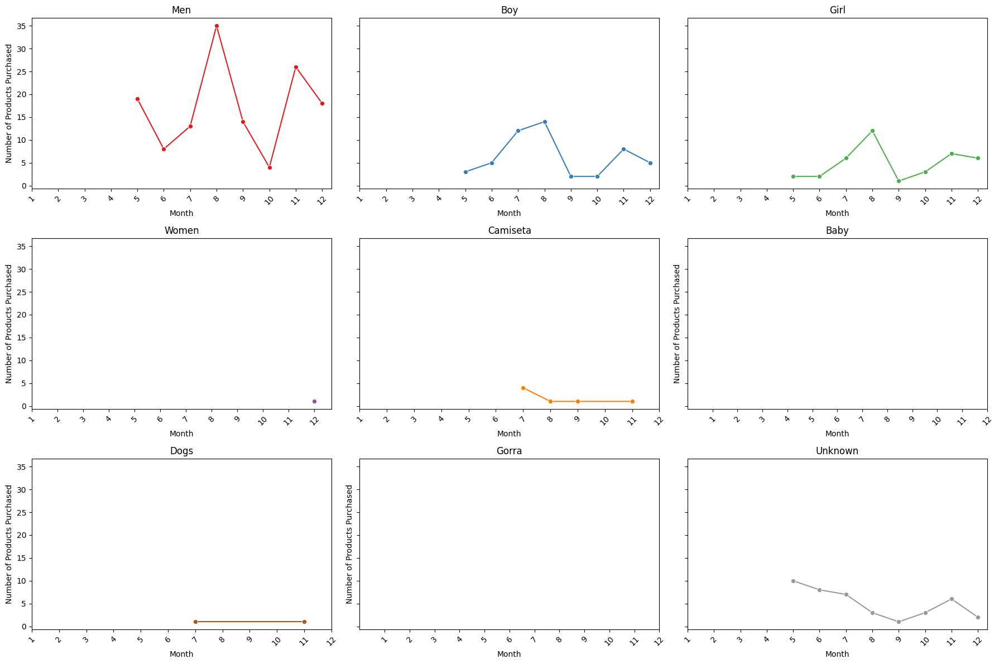

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = data_2022[data_2022['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



##### 2023


In [ ]:
# Filter the data for the year 2023
data_2023 = male_purchases[male_purchases['Year'] == 2023]


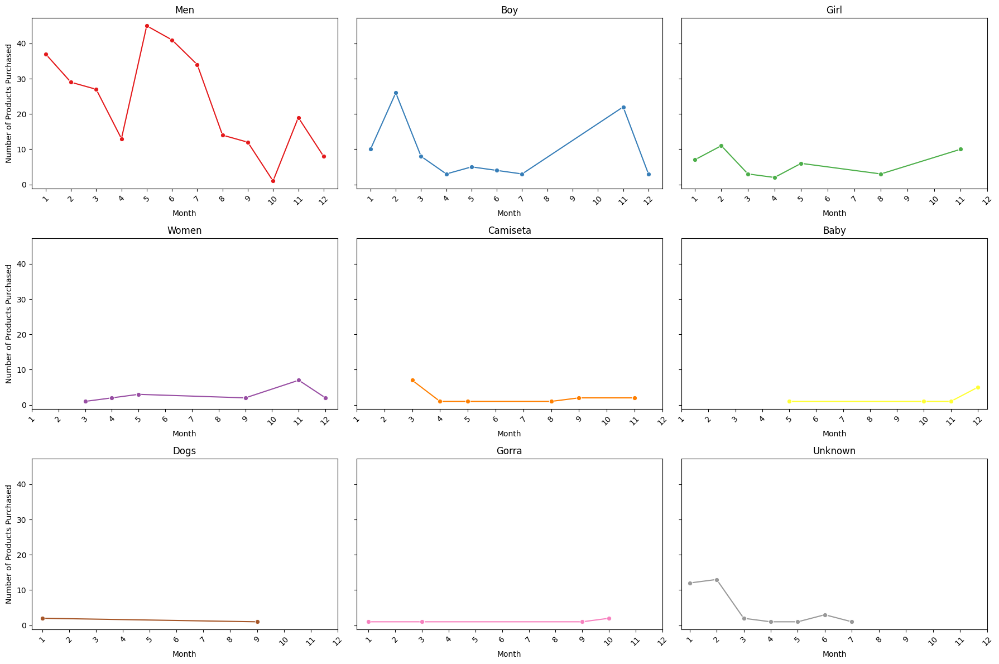

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = data_2023[data_2023['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



##### 2024


In [ ]:
# Filter the data for the year 2023
data_2024 = male_purchases[male_purchases['Year'] == 2024]


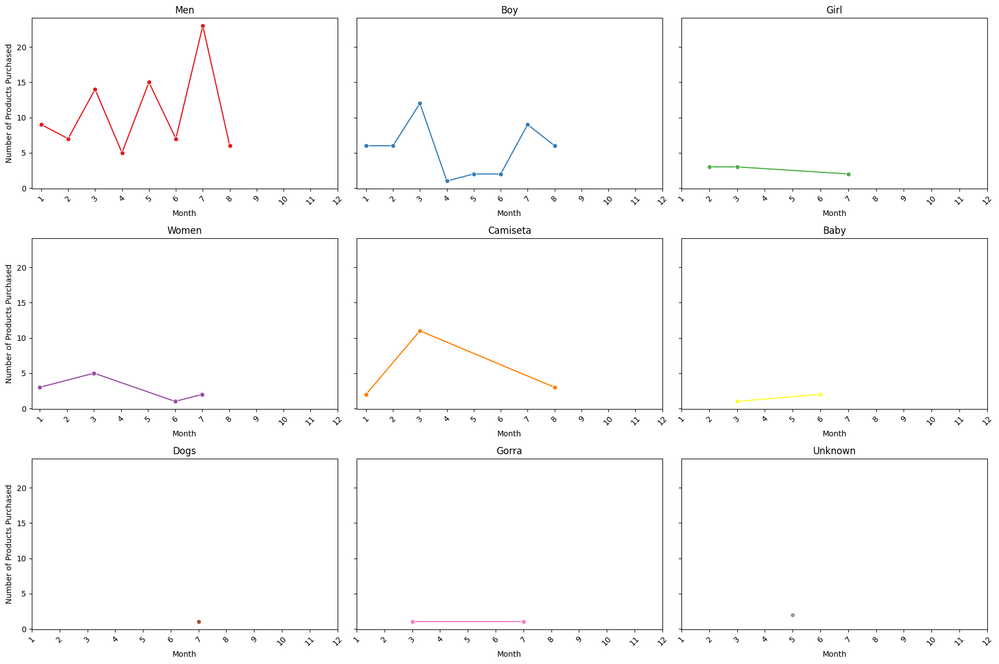

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = data_2024[data_2024['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



###### Installing gsheets to work with colab for saving files

In [ ]:
!pip install gspread gspread_dataframe


In [ ]:
from google.colab import auth
auth.authenticate_user()

import gspread
from google.auth import default

creds, _ = default()
gc = gspread.authorize(creds)


In [ ]:
# Create a new Google Sheet
sh = gc.create('Target Audience Men Only')

# Open the first sheet (you can select others by index or name)
worksheet = sh.get_worksheet(0)


###### Men buying for Men

In [ ]:
# Filter for customers who only have values in the 'Men' column and 0 in other Lineitem Gender columns
target_audience_men_only = male_purchases_final[
    (male_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (male_purchases_final[['Boy', 'Girl', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
target_audience_men_only.shape


(161, 64)

In [ ]:

# Convert the DataFrame to Google Sheet
gd.set_with_dataframe(worksheet, target_audience_men_only)

# Optional: print a confirmation message
print("Data saved to Google Sheets")


Data saved to Google Sheets


**Observations:** Most commonly men order at least two products for themselves with 62 eMails as such. Followed closely by 61 eMails who have purchased only one item. 3+ items could be considered high value male customers purchasing for men.

In [ ]:
# Filter for rows where the 'Men' column has 3 or more items
target_audience_men_only_top = target_audience_men_only[target_audience_men_only['Men'] >= 3]

# Display the result
target_audience_men_only_top.shape



(42, 64)

In [ ]:
# Create a new Google Sheet
sh_top = gc.create('Target Audience Men Only Top')

# Open the first sheet in the newly created Google Sheet
worksheet_top = sh_top.get_worksheet(0)

# Write the DataFrame to the Google Sheet
gd.set_with_dataframe(worksheet_top, target_audience_men_only_top)

# Optional: print a confirmation message
print("Data saved to Google Sheets: Target Audience Men Only Top")

Data saved to Google Sheets: Target Audience Men Only Top


In [ ]:
# Filter for rows where the 'Men' column has 1 or 2
target_audience_men_only_middle = target_audience_men_only[target_audience_men_only['Men'] <= 2]

# Display the result
target_audience_men_only_middle.shape

(119, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('Target Audience Men Only 2 or less items').get_worksheet(0), target_audience_men_only_middle)

# Optional: print a confirmation message
print("Data saved to Google Sheets: Target Audience Men Only 2 or less items")


Data saved to Google Sheets: Target Audience Men Only 2 or less items


###### Men buying for Men & Kids

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Boy' columns and 0 in other Lineitem Gender columns
target_audience_men_boy = male_purchases_final[
    (male_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (male_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (male_purchases_final[['Girl', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
target_audience_men_boy.shape



(28, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Men & Boys').get_worksheet(0), target_audience_men_boy)

# Optional: print a confirmation message
print("Data saved to Google Sheets: TA Men buying for Men & Boys")

Data saved to Google Sheets: TA Men buying for Men & Boys


In [ ]:
# Filter for customers who have values in both the 'Men' and 'Girl' columns and 0 in other Lineitem Gender columns
target_audience_men_girl = male_purchases_final[
    (male_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (male_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (male_purchases_final[['Boy', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
target_audience_men_girl.shape

(9, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Men & Girls').get_worksheet(0), target_audience_men_girl)

# Optional: print a confirmation message
print("Data saved to Google Sheets: TA Men buying for Men & Girls")

Data saved to Google Sheets: TA Men buying for Men & Girls


In [ ]:
# Filter for customers who have values in both the 'Men' and 'Girl' columns and 0 in other Lineitem Gender columns
target_audience_men_kids = male_purchases_final[
    (male_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (male_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (male_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category #
    (male_purchases_final['Camiseta'] >= 0) & #They have also purchased items in the 'Camiseta' category
    (male_purchases_final[['Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
target_audience_men_kids.shape

(16, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Men, Boys & Girls').get_worksheet(0), target_audience_men_kids)

# Optional: print a confirmation message
print("Data saved to Google Sheets: TA Men buying for Men, Boys & Girls")

Data saved to Google Sheets: TA Men buying for Men, Boys & Girls


##### Men buying for Kids ONLY



In [ ]:
# Filter for customers who have values in both the 'Men' and 'Girl' columns and 0 in other Lineitem Gender columns
TA_men_for_girl = male_purchases_final[
    (male_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (male_purchases_final[['Boy', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra', 'Men']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_men_for_girl.shape


(1, 64)

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Girl' columns and 0 in other Lineitem Gender columns
TA_men_for_boy = male_purchases_final[
    (male_purchases_final['Boy'] > 0 ) & # They have also purchased items in the 'Girl' category
    (male_purchases_final[['Girl', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra', 'Men']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_men_for_boy.shape

(10, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Boys').get_worksheet(0), TA_men_for_boy)

In [ ]:

TA_men_for_kids_camisetas_too = male_purchases_final[
    (male_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (male_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (male_purchases_final['Camiseta'] >= 0) &
    (male_purchases_final[['Unknown', 'Women', 'Baby', 'Dogs', 'Gorra','Men']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_men_for_kids_camisetas_too.shape

(12, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Girls & Boys (camisetas included)').get_worksheet(0), TA_men_for_kids_camisetas_too)

##### minority: the whole family

In [ ]:
# Filter for customers who have values in 'Men', 'Boy', 'Girl', and 'Women' columns, and 0 in other Lineitem Gender columns
TA_men_for_all = male_purchases_final[
    (male_purchases_final['Men'] > 0) &  # Must have purchased items in the 'Men' category
    (male_purchases_final['Boy'] > 0) &  # Must have purchased items in the 'Boy' category
    (male_purchases_final['Girl'] > 0) & # Must have purchased items in the 'Girl' category
    (male_purchases_final['Women'] > 0) &  # Must have purchased items in the 'Women' category
    (male_purchases_final[['Unknown', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0) &  # All other categories should sum to 0
    (male_purchases_final['Camiseta'] >= 0) &
    (male_purchases_final['Baby'] >= 0)# Can optionally include 'Camiseta'
]

# Display the shape of the filtered DataFrame
TA_men_for_all.shape


(4, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Men buying for Men, Boys, Girls, Women').get_worksheet(0), TA_men_for_all)

### Females

In [ ]:
# Filter the DataFrame where 'Predicted Gender' is 'female'

female_purchases = products[products['Predicted Gender'] == 'female'] # This Dataframe has the Lineitem Gender Exploded

female_purchases_final = final_data[final_data['Predicted Gender'] == 'female'] #This Dataframe has the Lineitem Gender Collapsed

In [ ]:
# Checking how many products were purchased by females
female_purchase_count = female_purchases.shape[0]
female_purchase_count

2458

In [ ]:
# Check for which audience the male purchases were made

female_pruchase_audience = female_purchases.value_counts('Lineitem Gender')
female_pruchase_audience

,count
Lineitem Gender,
Boy,749
Men,739
Girl,550
Camiseta,171
Women,97
Unknown,67
Baby,66
Dogs,17
Gorra,2


In [ ]:
# Obtaining percentage for better comparison:
# Calculate the percentage of each 'Lineitem Gender' in the male_purchases DataFrame
female_pruchase_audience_perc = female_purchases['Lineitem Gender'].value_counts(normalize=True) * 100

# Display the result
female_pruchase_audience_perc

,proportion
Lineitem Gender,
Boy,30.471928
Men,30.065094
Girl,22.375915
Camiseta,6.956876
Women,3.946298
Unknown,2.725793
Baby,2.685110
Dogs,0.691619
Gorra,0.081367


Insights to Female Purchasing behavior (per product, not per order)

- Boy 30.1% - 831 products
- Male 30% - 828 products
- Girl 22.2% - 613 products
- Camisetas 7.3% - 201 products
- Women 4% - 111 products
- Unknown 2.9% - 79 products
- Baby 2.7% - 74 products
- Dogs 0.7% - 18 products
- Hats 0.07% - 2 products

  - Woman buy equally for boys and men
  - Hats are not purchased by women

In [ ]:
# Group the data by 'Year' and 'Lineitem Gender' and count occurrences
female_purchase_audience = female_purchases[female_purchases['Year'].isin([2022, 2023, 2024])]
female_purchase_audience_grouped = female_purchase_audience.groupby(['Year', 'Lineitem Gender']).size().reset_index(name='Count')

# Pivot the grouped data
female_purchase_audience_pivot = female_purchase_audience_grouped.pivot(index='Year', columns='Lineitem Gender', values='Count')

# Display the pivoted DataFrame
female_purchase_audience_pivot



Lineitem Gender,Baby,Boy,Camiseta,Dogs,Girl,Gorra,Men,Unknown,Women
Year,,,,,,,,,
2022.0,3.0,203.0,54.0,NaN,154.0,NaN,192.0,21.0,2.0
2023.0,24.0,379.0,70.0,5.0,244.0,2.0,351.0,40.0,42.0
2024.0,39.0,167.0,47.0,12.0,152.0,NaN,196.0,6.0,53.0


Lineitem Gender  Baby    Boy  Camiseta  Dogs   Girl  Gorra    Men  Unknown  \
Year                                                                         
2022.0            3.0  203.0      54.0   NaN  154.0    NaN  192.0     21.0   
2023.0           24.0  379.0      70.0   5.0  244.0    2.0  351.0     40.0   
2024.0           39.0  167.0      47.0  12.0  152.0    NaN  196.0      6.0   

Lineitem Gender  Women  Baby_Proportion  Boy_Proportion  Camiseta_Proportion  \
Year                                                                           
2022.0             2.0         0.004769        0.322734             0.085851   
2023.0            42.0         0.020743        0.327571             0.060501   
2024.0            53.0         0.058036        0.248512             0.069940   

Lineitem Gender  Dogs_Proportion  Girl_Proportion  Gorra_Proportion  \
Year                                                                  
2022.0                       NaN         0.244833               Na

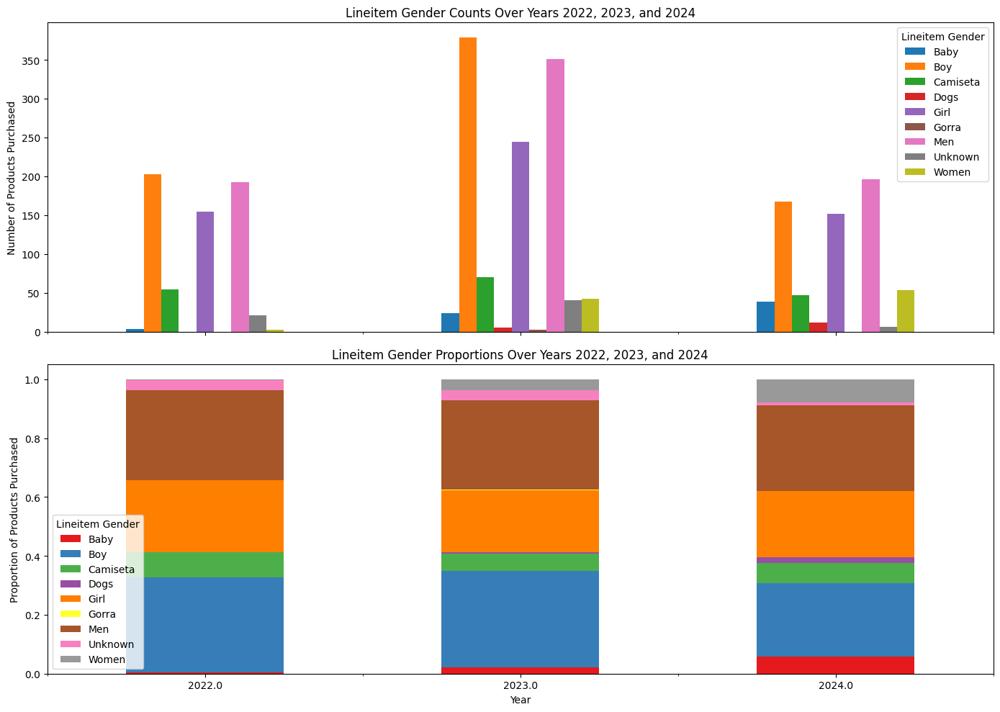

In [ ]:
# Step 1: Group the data by 'Year' and 'Lineitem Gender' and count occurrences
female_purchase_audience = female_purchases[female_purchases['Year'].isin([2022, 2023, 2024])]
female_purchase_audience_grouped = female_purchase_audience.groupby(['Year', 'Lineitem Gender']).size().reset_index(name='Count')

# Step 2: Pivot the grouped data
female_purchase_audience_pivot = female_purchase_audience_grouped.pivot(index='Year', columns='Lineitem Gender', values='Count')

# Step 3: Calculate the proportion for each Lineitem Gender within each year
female_purchase_audience_proportion = female_purchase_audience_pivot.div(female_purchase_audience_pivot.sum(axis=1), axis=0)

# Combine the count and proportion data into a single DataFrame
female_purchase_audience_combined = female_purchase_audience_pivot.copy()
for col in female_purchase_audience_proportion.columns:
    female_purchase_audience_combined[col + '_Proportion'] = female_purchase_audience_proportion[col]

# Display the combined DataFrame
print(female_purchase_audience_combined)

# Step 4: Plot the combined data
fig, ax = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

# Plot the counts
female_purchase_audience_pivot.plot(kind='bar', ax=ax[0])
ax[0].set_title('Lineitem Gender Counts Over Years 2022, 2023, and 2024')
ax[0].set_ylabel('Number of Products Purchased')
ax[0].legend(title='Lineitem Gender')

# Plot the proportions
female_purchase_audience_proportion.plot(kind='bar', stacked=True, ax=ax[1], colormap='Set1')
ax[1].set_title('Lineitem Gender Proportions Over Years 2022, 2023, and 2024')
ax[1].set_ylabel('Proportion of Products Purchased')
ax[1].legend(title='Lineitem Gender')

plt.xlabel('Year')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [ ]:
# Group by 'Year', 'Month', and 'Lineitem Gender' and count the occurrences
female_purchase_trends = female_purchases.groupby(['Year', 'Month', 'Lineitem Gender']).size().reset_index(name='Count')

# Display the grouped data
female_purchase_trends.head()


,Year,Month,Lineitem Gender,Count
0,2022.0,5.0,Boy,7
1,2022.0,5.0,Girl,2
2,2022.0,5.0,Men,16
3,2022.0,5.0,Unknown,1
4,2022.0,6.0,Boy,31


In [ ]:
# Pivot the data to have 'Year' and 'Month' as the index and 'Lineitem Gender' as columns
female_purchase_trends_pivot = female_purchase_trends.pivot_table(index=['Year', 'Month'], columns='Lineitem Gender', values='Count', fill_value=0)

# Display the pivoted data
female_purchase_trends_pivot


Lineitem Gender  Baby   Boy  Camiseta  Dogs  Girl  Gorra   Men  Unknown  Women
Year   Month                                                                  
2022.0 5.0        0.0   7.0       0.0   0.0   2.0    0.0  16.0      1.0    0.0
       6.0        0.0  31.0       1.0   0.0  28.0    0.0  47.0      0.0    0.0
       7.0        0.0  34.0       7.0   0.0  19.0    0.0  21.0      4.0    0.0
       8.0        0.0  24.0      16.0   0.0  25.0    0.0  23.0      2.0    0.0
       9.0        0.0  12.0       9.0   0.0   9.0    0.0   9.0      1.0    1.0
       10.0       0.0  18.0       2.0   0.0  14.0    0.0   3.0      0.0    0.0
       11.0       1.0  63.0      12.0   0.0  39.0    0.0  46.0      9.0    0.0
       12.0       2.0  14.0       7.0   0.0  18.0    0.0  27.0      4.0    1.0
2023.0 1.0        0.0  26.0       5.0   0.0  15.0    0.0  18.0      6.0    1.0
       2.0        0.0  82.0       6.0   0.0  51.0    0.0  41.0     14.0    0.0
       3.0        8.0  36.0      20.0   0.0  21.0    0.0  20.0      2.0    5.0
       4.0        1.0  22.0       5.0   2.0  11.0    1.0  17.0      0.0    4.0
       5.0        5.0  29.0       6.0   0.0  19.0    0.0  46.0      0.0    6.0
       6.0        0.0  40.0      11.0   1.0  30.0    0.0  78.0      3.0    3.0
       7.0        2.0  26.0       4.0   0.0  13.0    0.0  26.0      6.0    6.0
       8.0        1.0  26.0       3.0   1.0  13.0    0.0  16.0      8.0    2.0
       9.0        1.0   8.0       3.0   0.0   2.0    0.0   9.0      1.0    2.0
       10.0       1.0   9.0       1.0   0.0   5.0    0.0  13.0      0.0    1.0
       11.0       2.0  54.0       4.0   1.0  54.0    0.0  44.0      0.0    9.0
       12.0       3.0  21.0       2.0   0.0  10.0    1.0  23.0      0.0    3.0
2024.0 1.0        1.0  26.0       0.0   0.0  32.0    0.0  17.0      0.0   10.0
       2.0        2.0  12.0       1.0   0.0   7.0    0.0   8.0      0.0    0.0
       3.0        4.0  19.0       0.0   3.0  24.0    0.0  25.0      0.0    8.0
       4.0        2.0   9.0       8.0   3.0  10.0    0.0  14.0      0.0    4.0
       5.0       12.0  27.0       8.0   2.0  27.0    0.0  43.0      4.0   18.0
       6.0       13.0  42.0       3.0   4.0  38.0    0.0  66.0      0.0    7.0
       7.0        4.0  15.0      20.0   0.0   8.0    0.0  14.0      1.0    4.0
       8.0        1.0  17.0       7.0   0.0   6.0    0.0   9.0      1.0    2.0

##### Visualizing trends over time with all years

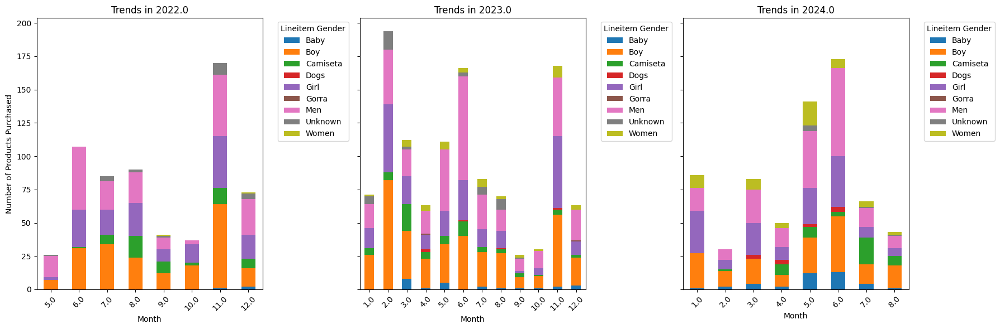

In [ ]:
# Get the unique years from the data
years = female_purchase_trends_pivot.index.get_level_values('Year').unique()

# Create subplots: one for each year
fig, axes = plt.subplots(nrows=1, ncols=len(years), figsize=(18, 6), sharey=True)

# Iterate over each year and create a bar plot for each
for i, year in enumerate(years):
    # Select the data for the specific year
    data_for_year = female_purchase_trends_pivot.loc[year]

    # Plot the data
    data_for_year.plot(kind='bar', ax=axes[i], stacked=True)

    # Set title and labels
    axes[i].set_title(f'Trends in {year}')
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticklabels(data_for_year.index, rotation=45)

    # Move the legend outside the plot
    axes[i].legend(title='Lineitem Gender', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()




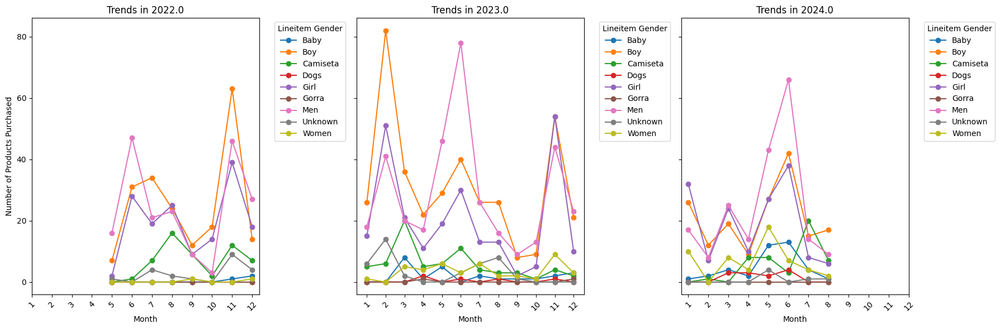

In [ ]:
# Get the unique years from the data
years = female_purchase_trends_pivot.index.get_level_values('Year').unique()

# Create subplots: one for each year
fig, axes = plt.subplots(nrows=1, ncols=len(years), figsize=(18, 6), sharey=True)

# Iterate over each year and create a line plot for each
for i, year in enumerate(years):
    # Select the data for the specific year
    data_for_year = female_purchase_trends_pivot.loc[year]

    # Plot the data as a line plot
    data_for_year.plot(kind='line', ax=axes[i], marker='o')

    # Set title and labels
    axes[i].set_title(f'Trends in {year}')
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

    # Move the legend outside the plot
    axes[i].legend(title='Lineitem Gender', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
# Filter the data for the years 2022, 2023, and 2024
fe_data_filtered = female_purchases[female_purchases['Year'].isin([2022, 2023, 2024])]


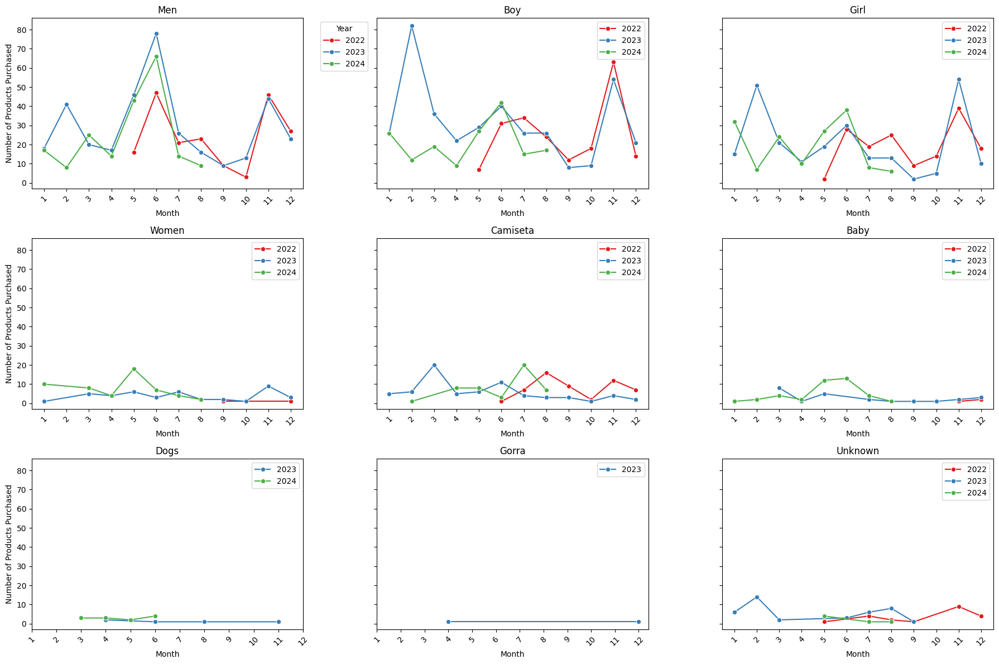

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Define the years to plot
years = [2022, 2023, 2024]

# Create a color palette for the years
year_colors = sns.color_palette('Set1', n_colors=len(years))  # Different color for each year

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each
for i, category in enumerate(categories):
    # Iterate over each year to plot them in the same subplot
    for j, year in enumerate(years):
        # Filter data for the specific category and year
        category_data = fe_data_filtered[(fe_data_filtered['Lineitem Gender'] == category) & (fe_data_filtered['Year'] == year)]
        category_data_grouped = category_data.groupby('Month')['Name'].count()

        # Plot the data for the specific category and year with a unique color
        sns.lineplot(x=category_data_grouped.index, y=category_data_grouped.values, marker='o', ax=axes[i], color=year_colors[j], label=str(year))

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Move the legend to a position that does not overlap with the plots
axes[0].legend(title='Year', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()


##### 2022


In [ ]:
# Filter the data for the year 2023
fe_data_2022 = female_purchases[female_purchases['Year'] == 2022]


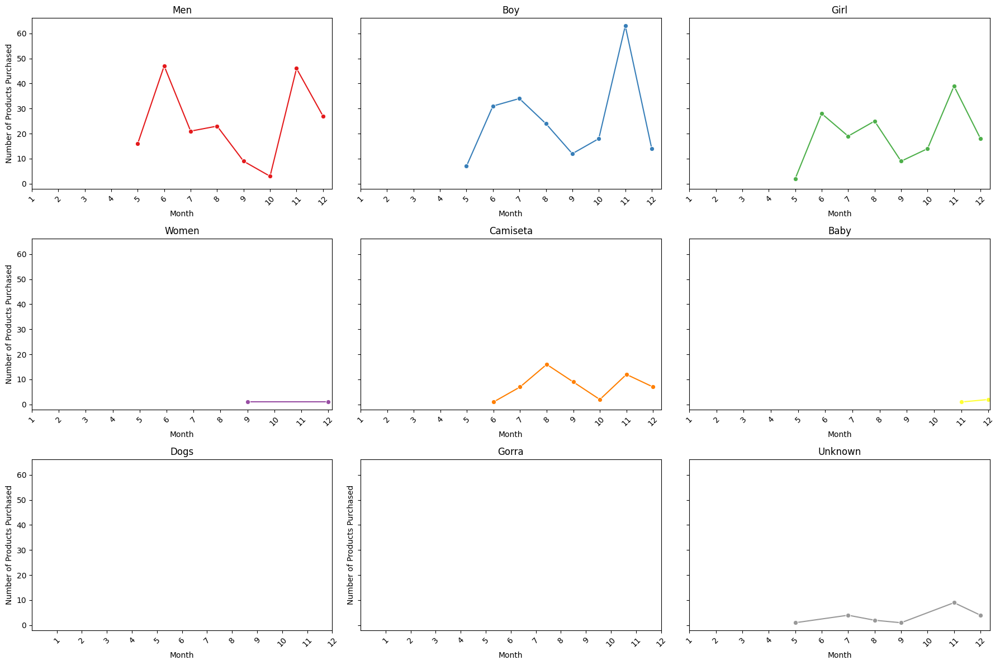

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = fe_data_2022[fe_data_2022['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



##### 2023


In [ ]:
# Filter the data for the year 2023
fe_data_2023 = female_purchases[female_purchases['Year'] == 2023]


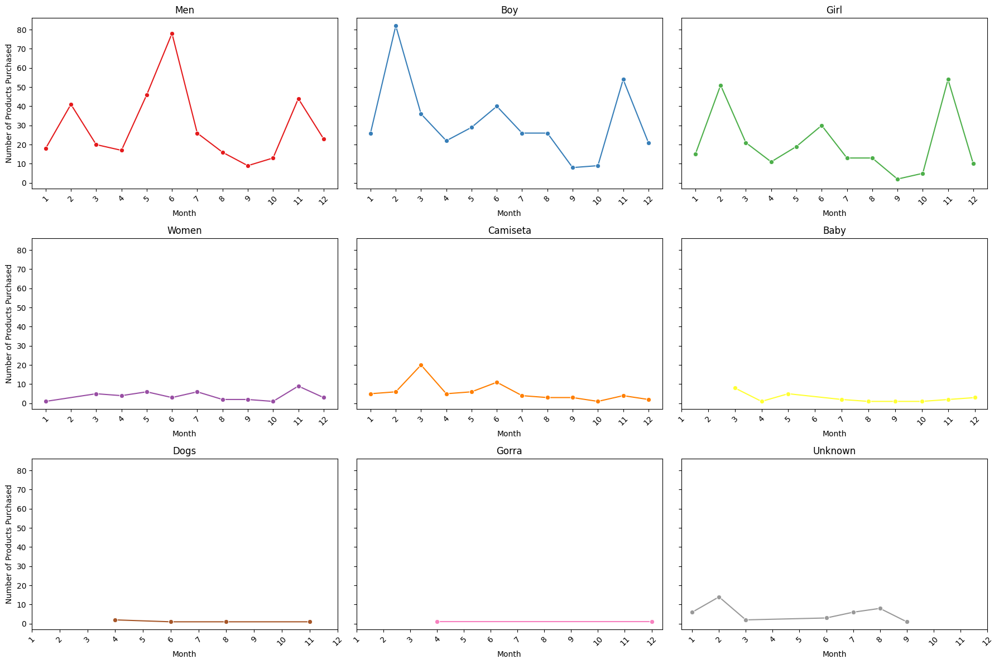

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = fe_data_2023[fe_data_2023['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



##### 2024


In [ ]:
# Filter the data for the year 2023
fe_data_2024 = female_purchases[female_purchases['Year'] == 2024]


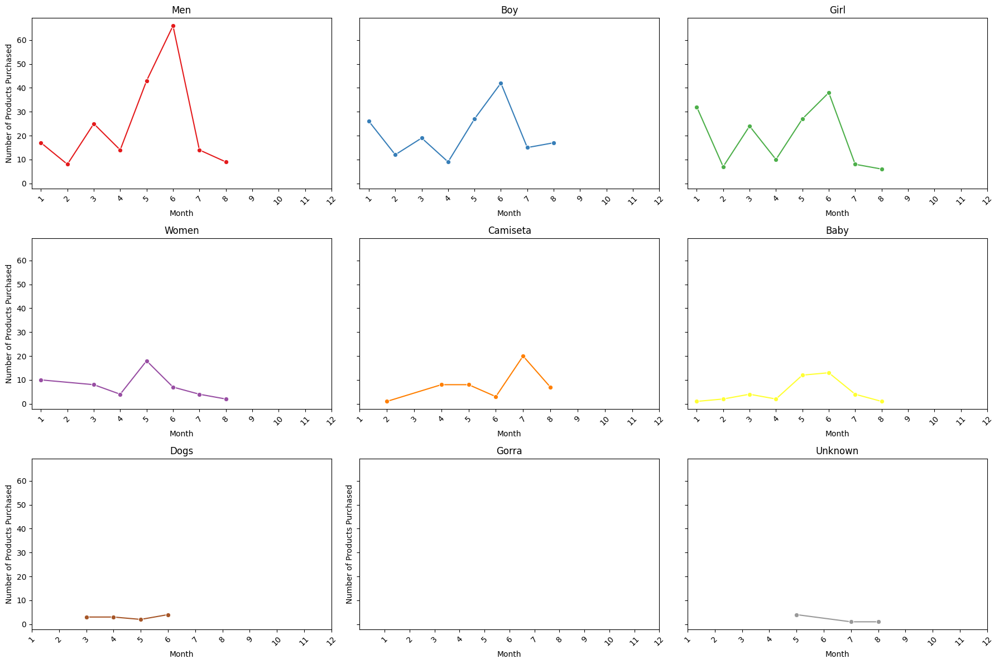

In [ ]:
# Define the 9 categories
categories = ['Men', 'Boy', 'Girl', 'Women', 'Camiseta', 'Baby', 'Dogs', 'Gorra', 'Unknown']

# Create a list of colors
colors = sns.color_palette('Set1', n_colors=len(categories))  # Using a Seaborn color palette

# Create subplots: 3x3 grid for the 9 categories
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharey=True)

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over each category and create a line plot for each with different colors
for i, category in enumerate(categories):
    # Filter data for the specific category
    category_data = fe_data_2024[fe_data_2024['Lineitem Gender'] == category].groupby('Month')['Name'].count()

    # Plot the data for the specific category with a unique color
    sns.lineplot(x=category_data.index, y=category_data.values, marker='o', ax=axes[i], color=colors[i])

    # Set title and labels
    axes[i].set_title(category)
    axes[i].set_xlabel('Month')
    axes[i].set_ylabel('Number of Products Purchased')
    axes[i].set_xticks(range(1, 13))  # Ensure all months are displayed
    axes[i].set_xticklabels([str(month) for month in range(1, 13)], rotation=45)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()



##### Women buying for Men

In [ ]:
# Filter for customers who only have values in the 'Men' column and 0 in other Lineitem Gender columns
target_audience__women_for_men_only = female_purchases_final[
    (female_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (female_purchases_final[['Boy', 'Girl', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
target_audience__women_for_men_only.shape


(123, 64)

**Observations:** There are 139 female eMails only purchasing products for men

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women purchase for Men Only').get_worksheet(0), target_audience__women_for_men_only)


In [ ]:
# Filter for rows where the 'Men' column has 3 or more items
target_audience_women_for_men_only_top = target_audience__women_for_men_only[target_audience__women_for_men_only['Men'] >= 3]

# Display the result
target_audience_women_for_men_only_top.shape


(16, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women purchase for Men Only Top (3 or more items)').get_worksheet(0), target_audience_women_for_men_only_top)

In [ ]:
# Filter for rows where the 'Men' column has 1 or 2
target_audience__women_for_men_only_middle = target_audience__women_for_men_only[target_audience__women_for_men_only['Men'] <= 2]

# Display the result
target_audience__women_for_men_only_middle.shape

(107, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women purchase for Men Only Top (2 or less items)').get_worksheet(0), target_audience__women_for_men_only_middle)

##### Women buying for Men & Kids

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Boy' columns and 0 in other Lineitem Gender columns
TA_women_for_men_boy = female_purchases_final[
    (female_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (female_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (female_purchases_final[['Girl', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_men_boy.shape



(108, 64)

**Observations:** There are 116 female eMails only purchasing products for men & boy

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Men & Boys').get_worksheet(0), TA_women_for_men_boy)


In [ ]:
# Filter for customers who have values in both the 'Men' and 'Girl' columns and 0 in other Lineitem Gender columns
TA_women_for_men_girl = female_purchases_final[
    (female_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (female_purchases_final['Girl'] > 0) & # They have also purchased items in the 'Girl' category
    (female_purchases_final[['Boy', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_men_girl.shape

(85, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Men & Girls').get_worksheet(0), TA_women_for_men_girl)

In [ ]:

TA_women_for_men_kids = female_purchases_final[
    (female_purchases_final['Men'] > 0) &  # They have purchased items in the 'Men' category
    (female_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (female_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (female_purchases_final['Camiseta'] >= 0) & # Or the purchased camiseta as well
    (female_purchases_final[['Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_men_kids.shape

(48, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Men, Boys & Girls').get_worksheet(0), TA_women_for_men_kids)

##### Only for kids

In [ ]:

TA_women_for_kids_camisetas_too = female_purchases_final[
    (female_purchases_final['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (female_purchases_final['Boy'] > 0) | # They have also purchased items in the 'Boy' category
    (female_purchases_final['Camiseta'] >= 0) &
    (female_purchases_final[['Unknown', 'Women', 'Baby', 'Dogs', 'Gorra','Men']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_kids_camisetas_too.shape

(253, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Kids (Boy & Girl) including camisetas').get_worksheet(0), TA_women_for_kids_camisetas_too)

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Boy' columns and 0 in other Lineitem Gender columns
TA_women_for_boy = female_purchases_final[
    (female_purchases_final['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (female_purchases_final[['Girl', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra','Men', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_boy.shape

(48, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Boys').get_worksheet(0), TA_women_for_boy)

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Boy' columns and 0 in other Lineitem Gender columns
TA_women_for_girl = female_purchases_final[
    (female_purchases_final['Girl'] > 0) & # They have also purchased items in the 'Boy' category
    (female_purchases_final[['Boy', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra','Men', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_girl.shape

(35, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying for Girls').get_worksheet(0), TA_women_for_girl)

##### minority: women for women and whole family

In [ ]:
# Filter for customers who have values in both the 'Men' and 'Boy' columns and 0 in other Lineitem Gender columns
TA_women_for_women = female_purchases_final[
    (female_purchases_final['Women'] > 0) & # They have also purchased items in the 'Boy' category
    (female_purchases_final[['Boy', 'Camiseta', 'Girl', 'Baby', 'Dogs', 'Gorra','Men','Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
TA_women_for_women.shape

(8, 64)

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying ONLY for Women').get_worksheet(0), TA_women_for_women)

In [ ]:
# Filter for customers who have values in 'Men', 'Boy', 'Girl', and 'Women' columns, and 0 in other Lineitem Gender columns
TA_women_for_all = female_purchases_final[
    (female_purchases_final['Men'] > 0) &  # Must have purchased items in the 'Men' category
    (female_purchases_final['Boy'] > 0) &  # Must have purchased items in the 'Boy' category
    (female_purchases_final['Girl'] > 0) & # Must have purchased items in the 'Girl' category
    (female_purchases_final['Women'] > 0) &  # Must have purchased items in the 'Women' category
    (female_purchases_final[['Unknown', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0) &  # All other categories should sum to 0
    (female_purchases_final['Camiseta'] >= 0) &
    (female_purchases_final['Baby'] >= 0)# Can optionally include 'Camiseta'
]

# Display the shape of the filtered DataFrame
print(TA_women_for_all.shape)


(14, 64)


In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('TA Women buying Men, Boy, Girl & Women').get_worksheet(0), TA_women_for_all)

#### General eMail segmentation into Lineitem Gender without Gender of customer

###### ONLY (singular)

In [ ]:
# Men only
purchases_for_men_only = final_data[
    (final_data['Men'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Boy', 'Girl', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_men_only.shape

(313, 64)

In [ ]:
# Boy only
purchases_for_boy_only = final_data[
    (final_data['Boy'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Men', 'Girl', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_boy_only.shape

(65, 64)

In [ ]:
# Girl only
purchases_for_girl_only = final_data[
    (final_data['Girl'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Men', 'Boy', 'Camiseta', 'Unknown', 'Women', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_girl_only.shape

(37, 64)

In [ ]:
# Women only
purchases_for_women_only = final_data[
    (final_data['Women'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Men', 'Boy', 'Camiseta', 'Unknown', 'Girl', 'Baby', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_women_only.shape #Same as the 10 customers (female) who purchased for women only

(9, 64)

In [ ]:
# Baby only
purchases_for_baby_only = final_data[
    (final_data['Baby'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Men', 'Boy', 'Camiseta', 'Unknown', 'Women', 'Women', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_baby_only.shape

(2, 64)

In [ ]:
# Camisas only
purchases_for_camisas_only = final_data[
    (final_data['Camiseta'] > 0) &  # They have purchased items in the 'Men' category
    (final_data[['Men', 'Boy', 'Baby', 'Unknown', 'Women', 'Women', 'Dogs', 'Gorra']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_camisas_only.shape

(19, 64)

###### Parents & Kids

In [ ]:
# Men & Boy
purchases_for_men_boy = final_data[
    (final_data['Men'] > 0) &  # They have purchased items in the 'Men' category
    (final_data['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (final_data[['Girl', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_men_boy.shape

(148, 64)

In [ ]:
# Men & Girl
purchases_for_men_girl = final_data[
    (final_data['Men'] > 0) &  # They have purchased items in the 'Men' category
    (final_data['Girl'] > 0) & # They have also purchased items in the 'Boy' category
    (final_data[['Boy', 'Camiseta', 'Women', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_men_girl.shape

(101, 64)

In [ ]:
# Women & Boy
purchases_for_women_boy = final_data[
    (final_data['Women'] > 0) &  # They have purchased items in the 'Men' category
    (final_data['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (final_data[['Girl', 'Camiseta', 'Men', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_women_boy.shape

(1, 64)

In [ ]:
# Women & Girl
purchases_for_women_girl = final_data[
    (final_data['Women'] > 0) &  # They have purchased items in the 'Men' category
    (final_data['Girl'] > 0) & # They have also purchased items in the 'Boy' category
    (final_data[['Boy', 'Camiseta', 'Men', 'Baby', 'Dogs', 'Gorra', 'Unknown']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_women_girl.shape

(9, 64)

##### Boys & Girls

In [ ]:
# Boys & Girls (can include camisetas or Baby)
purchases_for_boys_girls = final_data[
    (final_data['Girl'] > 0 ) & # They have also purchased items in the 'Girl' category
    (final_data['Boy'] > 0) & # They have also purchased items in the 'Boy' category
    (final_data['Camiseta'] >= 0) &
    (final_data['Baby'] >= 0) &
    (final_data[['Unknown', 'Women', 'Dogs', 'Gorra','Men']].sum(axis=1) == 0)  # All other categories should sum to 0
]

# Display the result
purchases_for_boys_girls.shape

(92, 64)

# **6. Customer segmentation and classification**

##### Taking a look

In [ ]:
# Finding repeat customers by eMail
repeat_customer_org = dfo.value_counts('Email').reset_index()
repeat_customer_org

,Email,count
0,mf_delamora@yahoo.com,25
1,sofiaambrosi@hotmail.com,23
2,teresa22ap@gmail.com,19
3,fernandar12@hotmail.com,18
4,vvg_13@hotmail.com,18
5,reginaymike@gmail.com,17
6,adrideantunano@hotmail.com,16
7,vmakarov@mba2010.hbs.edu,14
8,gaby.mgp@hotmail.com,14
9,fannyamanteo@gmail.com,14


In [ ]:
#Understanding top purchasing customer better
patricio = dfo[dfo['Email'] == 'patricio.kegel@gmail.com']
patricio.head(3)

#Reseller

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References


In [ ]:
#Understanding top purchasing customer better
ruiz = dfo[dfo['Email'] == 'magaliruizmarch@hotmail.com']
ruiz.head(3)


,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References


In [ ]:
#Understanding top purchasing customer better
mf = dfo[dfo['Email'] == 'mf_delamora@yahoo.com']
mf.head(3)


,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
13,#2367SP,mf_delamora@yahoo.com,paid,2024-08-07 14:38:38 -0600,fulfilled,2024-08-08 09:46:04 -0600,yes,MXN,719.2,189.0,0.0,908.2,NaN,179.8,Express (1 a 2 días hábiles) * Los tiempos de ...,2024-08-07 14:38:37 -0600,1,Traje De Baño Niña Modelo Candy Penguins - 11-12A,899.0,NaN,7.506382e+12,True,True,fulfilled,Maria Fernanda de la Mora,"Caletilla 55, C",Caletilla 55,C,NaN,Acapulco,'39390,GRO,MX,5538997303,Maria Fernanda de la Mora,"Caletilla 55, C",Caletilla 55,C,NaN,Acapulco,'39390,GRO,MX,5538997303,NaN,NaN,NaN,PayPal Express Checkout,rOMRAWcjoDebvlz8HKEEByPZ2,0.0,TINTARELLA SWIMWEAR & CO,0.0,5.791550e+12,NaN,Low,web,179.8,Estado de Guerrero,Estado de Guerrero,rOMRAWcjoDebvlz8HKEEByPZ2,rOMRAWcjoDebvlz8HKEEByPZ2
1508,#1865SP,mf_delamora@yahoo.com,paid,2023-08-04 10:53:11 -0600,fulfilled,2023-08-04 11:16:12 -0600,yes,MXN,9660.2,149.0,0.0,9809.2,NaN,0.0,Express (1 a 2 días hábiles) * Los tiempos de ...,2023-08-04 10:53:11 -0600,1,TRAJE DE BAÑO HOMBRE MODELO SKELETONS - XL,1143.2,1429.0,7.506382e+12,True,True,fulfilled,Fernanda de la Mora,"Gutierrez zamora 252, Las aguilas",Gutierrez zamora 252,Las aguilas,NaN,Cdmx,'01710,DF,MX,55 3899 7303,Fernanda de la Mora,"Gutierrez zamora 252, Las aguilas",Gutierrez zamora 252,Las aguilas,NaN,Cdmx,'01710,DF,MX,55 3899 7303,NaN,NaN,NaN,PayPal Express Checkout,rp2h9nz3cT9mAxSOAGWLOzkZ0,0.0,TINTARELLA SWIMWEAR & CO,0.0,5.361587e+12,NaN,Low,web,0.0,Ciudad de México,Ciudad de México,rp2h9nz3cT9mAxSOAGWLOzkZ0,rp2h9nz3cT9mAxSOAGWLOzkZ0
1509,#1865SP,mf_delamora@yahoo.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-08-04 10:53:11 -0600,1,TRAJE DE BAÑO HOMBRE MODELO LIME LINE - XL,1000.3,1429.0,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN


In [ ]:
# Finding repeat customers by eMail
repeat_customer = dfo_grouped.value_counts('Email').reset_index()
repeat_customer

,Email,count
0,reginaymike@gmail.com,5
1,juancarlos_fc@hotmail.com,5
2,mf_delamora@yahoo.com,4
3,vaizpuru1@gmail.com,4
4,crisrecke@hotmail.com,4
5,emilianicolau@gmail.com,4
6,lscheepstra@gmail.com,3
7,vvg_13@hotmail.com,3
8,rrm_csi@prodigy.net.mx,3
9,fannyamanteo@gmail.com,3


In [ ]:
#Understanding top purchasing customer better
juancarlos = dfo_grouped[dfo_grouped['Email'] == 'juancarlos_fc@hotmail.com']
juancarlos

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Predicted Gender,Year,Month,Shipping Category,Clean Lineitem name
19,#1020SP,juancarlos_fc@hotmail.com,2022-05-25 01:03:30+00:00,2022-05-25 09:36:33 -0500,yes,122.0,NaN,Estándar (3 - 5 Días Hábiles),2022-05-24 20:03:29 -0500,999.0,True,fulfilled,juan carlos cerdeira,"Pontevedra, 212, 212","Pontevedra, 212",212,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,juan carlos cerdeira,"Pontevedra, 212, 212","Pontevedra, 212",212,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,NaN,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Nuevo León,Nuevo León,399.6,521.6,0.0,1,['GREEN - XL'],[399.6],[7506382402584.0],male,2022,5,Estandard,['GREEN
28,#1029SP,juancarlos_fc@hotmail.com,2022-05-28 00:07:49+00:00,2022-05-30 00:05:17 -0500,yes,122.0,NaN,Estándar (3 - 5 Días Hábiles),2022-05-27 19:07:49 -0500,"1299.0, 1599.0",True,fulfilled,juan carlos figueiredo cerdeira,"Pontevedra, 212, 212","Pontevedra, 212",212,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,juan carlos figueiredo cerdeira,"Pontevedra, 212, 212","Pontevedra, 212",212,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,NaN,Pago con tarjeta de crédito y débito,0.0,0.0,ENTREGADO,web,0.0,Nuevo León,Nuevo León,1159.2,1281.2,0.0,2,"['TRAJE DE BAÑO HOMBRE JALAPENOS - XL', 'AQUA ...","[519.6, 639.6]","[7506382406810.0, 7506382405592.0]",male,2022,5,Estandard,['TRAJE DE BAÑO HOMBRE JALAPENOS
667,#1668SP,juancarlos_fc@hotmail.com,2023-05-23 01:35:02+00:00,2023-05-23 08:55:54 -0600,yes,0.0,ENVÍO GRATIS,Envío gratis. *Estándar,2023-05-22 19:35:01 -0600,1429.0,True,fulfilled,juan carlos Figueiredo Cerdeira,"PONTEVEDRA 212, FRACIONAMIENTO LAS SENDAS GALICIA",PONTEVEDRA 212,FRACIONAMIENTO LAS SENDAS GALICIA,NaN,San Pedro Garza García,'66233,NL,MX,81 8396 0363,juan carlos Figueiredo Cerdeira,"PONTEVEDRA 212, FRACIONAMIENTO LAS SENDAS GALICIA",PONTEVEDRA 212,FRACIONAMIENTO LAS SENDAS GALICIA,NaN,San Pedro Garza García,'66233,NL,MX,81 8396 0363,created_at: 1684797629\nmc_cid: 5bf5aa2550,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Nuevo León,Nuevo León,2000.6,2000.6,0.0,3,"['TRAJE DE BAÑO HOMBRE MAHI MAHI - M', 'TRAJE ...","[857.4, 571.6]","[7506382408951.0, 7506382415959.0, 75063824161...",male,2023,5,Estandard,['TRAJE DE BAÑO HOMBRE MAHI MAHI
685,#1686SP,juancarlos_fc@hotmail.com,2023-05-27 00:51:18+00:00,2023-05-29 09:14:37 -0600,yes,0.0,NaN,Envío gratis. *Estándar,2023-05-26 18:51:18 -0600,1429.0,True,fulfilled,juan carlos figueiredo cerdeira,"Pontevedra 212, LAS SENDAS GALICIAS",Pontevedra 212,LAS SENDAS GALICIAS,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,juan carlos figueiredo cerdeira,"Pontevedra 212, LAS SENDAS GALICIAS",Pontevedra 212,LAS SENDAS GALICIAS,NaN,San Pedro Garza Garcia,'66233,NL,MX,81 8396 0363,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Nuevo León,Nuevo León,1857.7,1857.7,0.0,3,"['TRAJE DE BAÑO HOMBRE OPEN WATERS - L', 'TRAJ...","[571.6, 714.5]","[7506382412361.0, 7506382416864.0, 75063824159...",male,2023,5,Estandard,['TRAJE DE BAÑO HOMBRE OPEN WATERS
1346,#2351SP,juancarlos_fc@hotmail.com,2024-07-30 02:17:19+00:00,2024-07-30 10:34:36 -0600,yes,0.0,NaN,Envío Gratis.,2024-07-29 20:17:18 -0600,NaN,True,fulfilled,juan cerdeira,"pontevedra 212 las sendas galicia, casa",pontevedra 212 las sendas galicia,casa,NaN,san pedro gar

In [ ]:
#Understanding top purchasing customer better
regina = dfo_grouped[dfo_grouped['Email'] == 'reginaymike@gmail.com']
regina

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Predicted Gender,Year,Month,Shipping Category,Clean Lineitem name
231,#1232SP,reginaymike@gmail.com,2022-10-13 03:31:54+00:00,2022-10-13 12:46:33 -0500,yes,0.0,NaN,Estándar Gratis (3 - 5 Días Hábiles),2022-10-12 22:31:53 -0500,NaN,True,fulfilled,regina jackson,"portal de las flores 75, lomas de las palmas",portal de las flores 75,lomas de las palmas,NaN,mexico,'52788,DF,MX,55 9185 6639,regina jackson,"portal de las flores 75, lomas de las palmas",portal de las flores 75,lomas de las palmas,NaN,mexico,'52788,DF,MX,55 9185 6639,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,"0.0, 849.0, 749.0",Ciudad de México,Ciudad de México,1798.0,1798.0,1598.0,4,"['TRAJE DE BAÑO NIÑA MODELO NAVY FUGU - 5-6', ...","[899.0, 849.0, 749.0]","[7506382418363.0, 7506382416932.0, 75063824169...",female,2022,10,Gratis,['TRAJE DE BAÑO NIÑA MODELO NAVY FUGU
233,#1234SP,reginaymike@gmail.com,2022-10-13 15:21:44+00:00,2022-10-13 13:02:31 -0500,yes,0.0,NaN,Estándar (3 - 5 Días Hábiles) - Septiembre Gratis,2022-10-13 10:21:43 -0500,NaN,True,fulfilled,Regina Jackson,"Portal de las flores 75, Lomas de las palmas",Portal de las flores 75,Lomas de las palmas,NaN,Mexico,'52788,MEX,MX,55 9185 6639,Regina Jackson,"Portal de las flores 75, Lomas de las palmas",Portal de las flores 75,Lomas de las palmas,NaN,Mexico,'52788,MEX,MX,55 9185 6639,NaN,Credit/Debit card by PayPal,0.0,0.0,NaN,web,"0.0, 749.0",Estado de México,Estado de México,849.0,849.0,749.0,2,"['TRAJE DE BAÑO NIÑO MODELO TOUCANDY - 3-4', '...","[849.0, 749.0]","[7506382417830.0, 7506382417816.0]",female,2022,10,Gratis,['TRAJE DE BAÑO NIÑO MODELO TOUCANDY
842,#1843SP,reginaymike@gmail.com,2023-07-22 13:22:47+00:00,2023-07-24 08:54:11 -0600,yes,149.0,NaN,Express (1 a 2 días hábiles) * Los tiempos de ...,2023-07-22 07:22:46 -0600,"1299.0, 1429.0","True, False",fulfilled,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,55 9185 6639,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,55 9185 6639,created_at: 1689801139\nmc_cid: f431483f8d,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Estado de México,Estado de México,2789.2,2938.2,0.0,4,"['TRAJE DE BAÑO HOMBRE NAVY FLY - XL', 'TRAJE ...","[519.6, 571.6, 899.0, 799.0]","[7506382406278.0, 7506382412071.0, 75063824216...",female,2023,7,Express,['TRAJE DE BAÑO HOMBRE NAVY FLY
889,#1890SP,reginaymike@gmail.com,2023-09-01 16:03:50+00:00,2023-09-01 10:59:10 -0600,yes,99.0,NaN,Estándar (2 a 5 días hábiles) Los tiempos de e...,2023-09-01 10:03:50 -0600,849.0,True,fulfilled,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,'+52 5591856639,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,'+52 5591856639,NaN,PayPal Express Checkout,0.0,0.0,NaN,web,0.0,Estado de México,Estado de México,1596.0,1695.0,0.0,4,['TRAJE DE BAÑO NIÑO MODELO CANDY PENGUINS - 1...,[399.0],"[7506382417106.0, 7506382417113.0, 75063824170...",female,2023,9,Estandard,['TRAJE DE BAÑO NIÑO MODELO CANDY PENGUI

In [ ]:
#Understanding top purchasing customer better
regina = dfo[dfo['Email'] == 'reginaymike@gmail.com']
regina

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Outstanding Balance,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Payment ID,Payment References
954,#2064SP,reginaymike@gmail.com,paid,2024-01-17 20:13:33 -0600,fulfilled,2024-01-18 09:53:19 -0600,yes,MXN,1798.0,99.0,0.0,1897.0,NaN,1698.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-01-17 20:13:32 -0600,1,Traje De Baño Niña Modelo Sour Lemon - 9-10A,899.0,NaN,7.506382e+12,True,True,fulfilled,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,+525591856639,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,+525591856639,NaN,NaN,NaN,PayPal Express Checkout,rQ8D5UrNPnrDxHotZPFFYz8rE,0.0,TINTARELLA SWIMWEAR & CO,0.0,5.543997e+12,NaN,Low,web,0.0,Estado de México,Estado de México,rQ8D5UrNPnrDxHotZPFFYz8rE,rQ8D5UrNPnrDxHotZPFFYz8rE
955,#2064SP,reginaymike@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-01-17 20:13:32 -0600,1,Traje De Baño Niño Modelo Candy Penguins - 3-4A,849.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,849.0,NaN,NaN,NaN,NaN
956,#2064SP,reginaymike@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-01-17 20:13:32 -0600,1,Traje De Baño Niño Modelo Candy Penguins - 0-12M,849.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,849.0,NaN,NaN,NaN,NaN
957,#2064SP,reginaymike@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-01-17 20:13:32 -0600,1,Traje De Baño Niña Modelo Candy Penguins - 5-6A,899.0,NaN,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN
1434,#1890SP,reginaymike@gmail.com,paid,2023-09-01 10:03:50 -0600,fulfilled,2023-09-01 10:59:10 -0600,yes,MXN,1596.0,99.0,0.0,1695.0,NaN,0.0,Estándar (2 a 5 días hábiles) Los tiempos de e...,2023-09-01 10:03:50 -0600,1,TRAJE DE BAÑO NIÑO MODELO CANDY PENGUINS - 13-24M,399.0,849.0,7.506382e+12,True,True,fulfilled,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,'+52 5591856639,Regina jackson,"fuente portal de las flores 75, Lomas de las p...",fuente portal de las flores 75,Lomas de las palmas,NaN,huixquilucan,'52788,MEX,MX,'+52 5591856639,NaN,NaN,NaN,PayPal Express Checkout,rTn8XUlWPUN0d2Ai3jhBDCLhb,0.0,TINTARELLA SWIMWEAR & CO,0.0,5.388282e+12,NaN,Low,web,0.0,Estado de México,Estado de México,rTn8XUlWPUN0d2Ai3jhBDCLhb,rTn8XUlWPUN0d2Ai3jhBDCLhb
1435,#1890SP,reginaymike@gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2023-09-01 10:03:50 -0600,1,TRAJE DE BAÑO NIÑO MODELO CANDY PENGUINS - 3-4A,399.0,849.0,7.506382e+12,True,True,fulfilled,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

##### Further customer segmentation:
Segment the buyers of orders into 3 different categories,
1. High Recency, High Frequency, High Monetary = Top Customer; These might me bost loyal customers with high chance of purchase ,
2. Low Recency, High Frequency: Customer who were once frequent buyser but haven’t purchased recently,
3. High Recency, Low Frequency: New customer who have only made one purchase

In [ ]:
final_data.head(3)

,Name,Email,Paid at,Fulfilled at,Accepts Marketing,Shipping,Taxes,Discount Code,Shipping Method,Created at,Lineitem compare at price,Lineitem requires shipping,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Note Attributes,Payment Method,Refunded Amount,Outstanding Balance,Tags,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Shipping Category,Clean Lineitem name,Lineitem Gender,Predicted Gender,Subtotal,Total,Discount Amount,Lineitem quantity,Lineitem name,Lineitem price,Lineitem sku,Baby,Boy,Camiseta,Dogs,Girl,Gorra,Men,Unknown,Women
0,"#2017SP, #2005SP",52475134@prodigy.net.mx,"2023-12-08 23:32:20+00:00, 2023-11-29 22:27:38...","2023-12-11 10:13:30 -0600, 2023-11-30 09:58:05...","yes, no",99.0,0.0,,Estándar (2 a 5 días hábiles) Los tiempos de e...,"2023-12-08 17:32:20 -0600, 2023-11-29 16:27:38...",,True,fulfilled,"Alejandra Arellano, Alejandra Muriel","Hacienda de la Luz 35 Hacienda de las Palmas,...","Hacienda de la Luz 35 Hacienda de las Palmas,...",Casa 3,,Huixquilucan,'52763,MEX,MX,55 2653 2490,"Alejandra Arellano, Alejandra Muriel","Hacienda de la Luz 35 Hacienda de las Palmas,...","Hacienda de la Luz 35 Hacienda de las Palmas,...",Casa 3,,Huixquilucan,'52763,MEX,MX,55 2653 2490,,PayPal Express Checkout,0.0,0.0,,web,0.0,Estado de México,Estado de México,2023.0,"12.0, 11.0",Estandard,"Traje De Baño Niño Modelo Color Frogs, Traje D...","Boy, Girl",female,2332.20,2530.20,164.80,3,"[Traje De Baño Niño Modelo Color Frogs - 3-4A,...","[849.0, 799.0]","[7506382420977.0, 7506382420960.0, 75063824215...",0,2,0,0,1,0,0,0,0
1,#1613SP,ANALUCIAGZA@GMAIL.COM,2023-04-10 18:01:18+00:00,2023-04-10 13:14:52 -0600,yes,0.0,0.0,HOLA10,Envío gratis. *Estándar,2023-04-10 12:01:17 -0600,1429.0,True,fulfilled,analucia garza montemayor,"paseo de los ahuehuetes sur 10, bosques de ref...",paseo de los ahuehuetes sur 10,bosques de reforma / miguel hidalgo,,ciudad de mexico,'11930,DF,MX,81 1244 0469,analucia garza montemayor,"paseo de los ahuehuetes sur 10, bosques de ref...",paseo de los ahuehuetes sur 10,bosques de reforma / miguel hidalgo,,ciudad de mexico,'11930,DF,MX,81 1244 0469,,PayPal Express Checkout,0.0,0.0,,web,0.0,Ciudad de México,Ciudad de México,2023.0,4.0,Estandard,"TRAJE DE BAÑO HOMBRE PINK ORIGAMIX, TRAJE DE B...",Men,unknown,1800.54,1800.54,200.06,2,"[TRAJE DE BAÑO HOMBRE PINK ORIGAMIX - M, TRAJE...",[1000.3],"[7506382411579.0, 7506382408890.0]",0,0,0,0,0,0,2,0,0
2,#2147SP,ARMANDOGONZALEZ10@HOTMAIL.COM,2024-04-01 22:32:11+00:00,2024-04-01 17:08:45 -0600,no,99.0,0.0,,Estándar (2 a 5 días hábiles) Los tiempos de e...,2024-04-01 16:32:11 -0600,,True,fulfilled,ARMANDO GONZALEZ ROMERO,"VIA ESPUELA FRACC. GRAN VILLA, CASA 17",VIA ESPUELA FRACC. GRAN VILLA,CASA 17,,VILLAHERMOSA,'86035,TAB,MX,9932094166,ARMANDO GONZALEZ ROMERO,"VIA ESPUELA FRACC. GRAN VILLA, CASA 17",VIA ESPUELA FRACC. GRAN VILLA,CASA 17,,VILLAHERMOSA,'86035,TAB,MX,9932094166,,PayPal Express Checkout,0.0,0.0,,web,142.9,Tabasco,Tabasco,2024.0,4.0,Estandard,Traje De Baño Hombre Modelo Candy Lane,Men,male,1286.10,1385.10,142.90,1,[Traje De Baño Hombre Modelo Candy Lane - XL],[1429.0],[7506382423565.0],0,0,0,0,0,0,1,0,0


###### High Monetary, High Frequency, High Recency

1. High Monetary = high values in 'Total' column
2. High Recency = contains '2024' in 'Year' column, meaning the customer purchased this year
3. High Frequency = Multiple entries in the 'Name' column (for example: 	#2017SP, #2005SP	) these are always seperated by a comma

In [ ]:
# Calculate the mean and median for 'Total'
mean_total = final_data['Total'].mean()
median_total = final_data['Total'].median()

print(f"Mean of Total: {mean_total}")
print(f"Median of Total: {median_total}")

Mean of Total: 2452.766861063465
Median of Total: 1990.9250000000002


In [ ]:
# Calculate the 50th percentile of the 'Total' column to define the 'Middle Monetary' cutoff
low_monetary_threshold = final_data['Total'].quantile(0.25)

print(f"Low Monetary Cutoff Value: {low_monetary_threshold}")

Low Monetary Cutoff Value: 1429.0


In [ ]:
# Calculate the 50th percentile of the 'Total' column to define the 'Middle Monetary' cutoff
middle_monetary_threshold = final_data['Total'].quantile(0.5)

print(f"Middle Monetary Cutoff Value: {middle_monetary_threshold}")


Middle Monetary Cutoff Value: 1990.9250000000002


In [ ]:
# Calculate the 75th percentile of the 'Total' column to define the 'High Monetary' cutoff
high_monetary_threshold = final_data['Total'].quantile(0.75)

print(f"High Monetary Cutoff Value: {high_monetary_threshold}")


High Monetary Cutoff Value: 2858.0


**Observations:**

- lower quantile 'Total' Spend = 1429
- median 'Total' Spend = 1990.92
- 3rd quantile 'Total' Spend = 2858

The cutoff for 'high monetary' value in finding top customers will thus be **2858MXN**

In [ ]:
# Use the high_monetary_threshold as the cutoff for 'High Monetary'
high_monetary_cutoff = high_monetary_threshold

# Step 1: Calculate High Monetary
# Mark customers as high monetary if 'Total' is greater than or equal to the median
final_data['High Monetary'] = np.where(final_data['Total'] >= high_monetary_cutoff, 1, 0)

# Step 2: Identify High Recency
# Customers who purchased in 2024
final_data['High Recency'] = final_data['Year'].apply(lambda x: 1 if '2024' in str(x) else 0)

# Step 3: Determine High Frequency
# Customers with more than one order
final_data['Order Count'] = final_data['Name'].apply(lambda x: len(str(x).split(',')))
final_data['High Frequency'] = np.where(final_data['Order Count'] > 1, 1, 0)

# Step 4: Filter the DataFrame to Include Only High Value Customers
high_value_customers = final_data[
    (final_data['High Monetary'] == 1) &
    (final_data['High Recency'] == 1) &
    (final_data['High Frequency'] == 1)
]

#  Reset index for better readability
high_value_customers.reset_index(drop=True, inplace=True)

high_value_customers.shape


(49, 68)

**There are 49 customers who have are considered 'Top Customers'**

In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('High Value Customers (RFM Analysis)').get_worksheet(0), high_value_customers)

In [ ]:
# Taking a look at high value customers
high_value_customers[['Email',	'Predicted Gender','Total', 'Year', 'Month', 'Name','Shipping Category', 'Shipping Province','Lineitem Gender', 'High Monetary', 'High Recency', 'High Frequency']]



,Email,Predicted Gender,Total,Year,Month,Name,Shipping Category,Shipping Province,Lineitem Gender,High Monetary,High Recency,High Frequency
0,Helena.Herrera@mx.ey.com,female,3204.10,"2024.0, 2023.0","1.0, 6.0","#2073SP, #1714SP",Estandard,DF,Girl,1,1,1
1,adolfontes88@gmail.com,male,2957.00,"2024.0, 2022.0","5.0, 12.0","#2192SP, #1381SP","Estandard, Express",DF,Men,1,1,1
2,alezubiranrabay@hotmail.com,female,5859.25,"2024.0, 2023.0","6.0, 5.0, 4.0","#2247SP, #2233SP, #1599SP",Estandard,DF,"Men, Girl, Baby",1,1,1
3,anacerleg@hotmail.com,female,5608.20,"2024.0, 2023.0","5.0, 6.0","#2216SP, #1738SP",Estandard,DF,"Men, Boy",1,1,1
4,anamariarobles@hotmail.com,female,8291.30,"2024.0, 2023.0","7.0, 1.0","#2345SP, #2046SP, #1853SP","Gratis, Estandard",JAL,Men,1,1,1
5,anaphova1@gmail.com,female,2999.70,"2024.0, 2023.0","3.0, 8.0","#2101SP, #1878SP",Estandard,DF,Boy,1,1,1
6,anlali@yahoo.com,female,10970.95,"2024.0, 2023.0","2.0, 5.0","#2090SP, #1659SP",Estandard,DF,"Girl, Boy, Men, Camiseta",1,1,1
7,cardenasbgtz@gmail.com,female,3942.80,2024.0,6.0,"#2310SP, #2289SP",Express,COAH,"Men, Girl",1,1,1
8,carofdez07@yahoo.com,female,5050.00,2024.0,"8.0, 7.0","#2361SP, #2341SP","Gratis, Estandard",MEX,"Women, Baby, Boy, Men",1,1,1
9,cesar@cftaller.mx,male,5885.00,"2024.0, 2022.0","4.0, 11.0","#2158SP, #1305SP","Express, Gratis",DF,"Men, Boy",1,1,1


In [ ]:
# Checking which Gender the high value customers have
high_value_customers.value_counts('Predicted Gender')

,count
Predicted Gender,
female,38
male,7
"female, unknown",1
"male, female",1
"unknown, female",1
"unknown, male",1


In [ ]:
# Checking which Province the high value customers are located in
high_value_customers.value_counts('Shipping Province')

,count
Shipping Province,
DF,25
JAL,4
MEX,4
COAH,2
GTO,2
"MEX, DF",2
NL,2
CAMP,1
"DF, MEX",1


In [ ]:
# Count occurrences of each shipping category
express_count = high_value_customers['Shipping Category'].str.contains('Express', case=False).sum()
estandard_count = high_value_customers['Shipping Category'].str.contains('Estandard', case=False).sum()
gratis_count = high_value_customers['Shipping Category'].str.contains('Gratis', case=False).sum()

# Calculate the total number of rows in the DataFrame
total_count = len(high_value_customers)

# Calculate percentages
express_percentage = (express_count / total_count) * 100
estandard_percentage = (estandard_count / total_count) * 100
gratis_percentage = (gratis_count / total_count) * 100

# Display the results
print(f"Express: {express_count} ({express_percentage:.2f}%)")
print(f"Estandard: {estandard_count} ({estandard_percentage:.2f}%)")
print(f"Gratis: {gratis_count} ({gratis_percentage:.2f}%)")


Express: 18 (36.73%)
Estandard: 39 (79.59%)
Gratis: 18 (36.73%)


##### High frequency Low recency

In [ ]:

# Count the number of orders in the 'Name' column (based on commas)
final_data['Order Count'] = final_data['Name'].apply(lambda x: len(str(x).split(',')))

# Mark customers as high frequency if they have more than one order
final_data['High Frequency'] = np.where(final_data['Order Count'] > 1, 1, 0)

# Step 2: Identify Low Recency
# Mark customers as low recency if they did NOT purchase in 2024
final_data['Low Recency'] = final_data['Year'].apply(lambda x: 1 if '2024' not in str(x) else 0)

# Step 3: Filter the DataFrame to Include Only High Frequency, Low Recency Customers
high_frequency_low_recency = final_data[
    (final_data['High Frequency'] == 1) &
    (final_data['Low Recency'] == 1)
]


#Reset index for better readability
high_frequency_low_recency.reset_index(drop=True, inplace=True)

high_frequency_low_recency.shape


(97, 69)

**Observations:** There are 97 customers who have purchased frequently but los recency

In [ ]:
# Display the high frequency, low recency customers
high_frequency_low_recency[['Email',	'Predicted Gender','Total', 'Year', 'Month', 'Name','Shipping Category', 'Shipping Province','Lineitem Gender', 'High Monetary', 'High Recency', 'High Frequency']]



,Email,Predicted Gender,Total,Year,Month,Name,Shipping Category,Shipping Province,Lineitem Gender,High Monetary,High Recency,High Frequency
0,52475134@prodigy.net.mx,female,2530.20,2023.0,"12.0, 11.0","#2017SP, #2005SP",Estandard,MEX,"Boy, Girl",0,0,1
1,aarregui@central.com.pe,female,6042.25,"2023.0, 2022.0","10.0, 11.0","#1920SP, #1328SP","Estandard, Gratis",DF,"Men, Baby, Boy",1,0,1
2,adrideantunano@hotmail.com,unknown,7944.40,2023.0,1.0,"#1398SP, #1397SP",Express,DF,"Girl, Camiseta, Boy",1,0,1
3,agarcia@riosferrer.com.mx,male,1341.20,2023.0,"7.0, 5.0","#1812SP, #1667SP",Estandard,MEX,Men,0,0,1
4,ana_topete@hotmail.com,female,3632.40,2023.0,"6.0, 5.0","#1784SP, #1684SP","Express, Estandard",DF,"Men, Girl, Boy",1,0,1
5,anacelopez@hotmail.com,female,5778.50,"2023.0, 2022.0","7.0, 11.0","#1842SP, #1286SP","Estandard, Gratis",DF,"Boy, Unknown, Men",1,0,1
6,andie_1087@hotmail.com,female,3154.10,2022.0,8.0,"#1193SP, #1188SP","Estandard, Gratis",DF,"Girl, Men, Boy",1,0,1
7,andrea.alvaleon@gmail.com,"female, male",4583.20,"2023.0, 2022.0","4.0, 11.0","#1630SP, #1310SP","Estandard, Gratis",DF,"Men, Girl, Boy",1,0,1
8,andreabonilla85@gmail.com,female,3594.00,"2023.0, 2022.0","6.0, 12.0","#1779SP, #1354SP","Estandard, Gratis",DF,Camiseta,1,0,1
9,andygomezs@icloud.com,female,5660.80,2022.0,"11.0, 10.0","#1314SP, #1244SP",Gratis,DF,"Men, Boy",1,0,1


In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('High Frequency Low Recency (RFM Analysis)').get_worksheet(0), high_frequency_low_recency)

In [ ]:
# Checking which Gender the high value customers have
high_frequency_low_recency.value_counts('Predicted Gender')

,count
Predicted Gender,
female,62
male,21
unknown,4
"female, male",2
"female, unknown",2
"mostly_female, female",2
"male, female",1
"male, female, unknown",1
"male, unknown",1


In [ ]:
# Checking which Province the high value customers are located in
high_frequency_low_recency.value_counts('Shipping Province')

,count
Shipping Province,
DF,44
MEX,19
JAL,5
COAH,4
MICH,3
BCS,2
SLP,2
NL,2
TAMPS,1


In [ ]:
# Count occurrences of each shipping category
express_count = high_frequency_low_recency['Shipping Category'].str.contains('Express', case=False).sum()
estandard_count = high_frequency_low_recency['Shipping Category'].str.contains('Estandard', case=False).sum()
gratis_count = high_frequency_low_recency['Shipping Category'].str.contains('Gratis', case=False).sum()

# Calculate the total number of rows in the DataFrame
total_count = len(high_frequency_low_recency)

# Calculate percentages
express_percentage = (express_count / total_count) * 100
estandard_percentage = (estandard_count / total_count) * 100
gratis_percentage = (gratis_count / total_count) * 100

# Display the results
print(f"Express: {express_count} ({express_percentage:.2f}%)")
print(f"Estandard: {estandard_count} ({estandard_percentage:.2f}%)")
print(f"Gratis: {gratis_count} ({gratis_percentage:.2f}%)")

Express: 15 (15.46%)
Estandard: 70 (72.16%)
Gratis: 45 (46.39%)


##### Low frequency High recency

In [ ]:
# Mark customers as low frequency if they have only one order
final_data['Low Frequency'] = np.where(final_data['Order Count'] == 1, 1, 0)

# Step 2: Identify High Recency
# Mark customers as high recency if they purchased in 2024
final_data['High Recency'] = final_data['Year'].apply(lambda x: 1 if '2024' in str(x) else 0)

# Step 3: Filter the DataFrame to Include Only Low Frequency, High Recency Customers
low_frequency_high_recency = final_data[
    (final_data['Low Frequency'] == 1) &
    (final_data['High Recency'] == 1)
]

# Reset index for better readability
low_frequency_high_recency.reset_index(drop=True, inplace=True)

low_frequency_high_recency.shape

(239, 70)

**Observations:** There are 239 customers who have purchased frequently but los recency

In [ ]:
# Display the low frequency, high recency customers
low_frequency_high_recency[['Email',	'Predicted Gender','Total', 'Year', 'Month', 'Name','Shipping Category', 'Shipping Province','Lineitem Gender', 'High Monetary', 'High Recency', 'High Frequency']]



,Email,Predicted Gender,Total,Year,Month,Name,Shipping Category,Shipping Province,Lineitem Gender,High Monetary,High Recency,High Frequency
0,ARMANDOGONZALEZ10@HOTMAIL.COM,male,1385.10,2024.0,4.0,#2147SP,Estandard,TAB,Men,0,1,0
1,C.j.graham@me.com,male,813.50,2024.0,5.0,#2185SP,Estandard,DF,Men,0,1,0
2,Danielamendezto@gmail.com,female,1731.40,2024.0,5.0,#2229SP,Estandard,DF,"Baby, Men",0,1,0
3,Floriehusni@gmail.com,female,4766.25,2024.0,6.0,#2238SP,Estandard,MEX,"Men, Girl",1,1,0
4,ROSAMARY_RG@HOTMAIL.COM,unknown,1978.90,2024.0,5.0,#2176SP,Estandard,Q ROO,"Baby, Boy, Men",0,1,0
5,Reyes.deRoubaix@gmail.com,female,2532.00,2024.0,6.0,#2315SP,Gratis,DF,"Dogs, Men, Boy, Girl",0,1,0
6,abuela_frick@hotmail.com,female,1862.40,2024.0,6.0,#2269SP,Estandard,MEX,"Girl, Men",0,1,0
7,acardoso@cmmsc.com.mx,female,2189.60,2024.0,5.0,#2210SP,Express,MEX,Men,0,1,0
8,acovalese@gmail.com,female,1891.40,2024.0,6.0,#2242SP,Estandard,MEX,"Boy, Men",0,1,0
9,agusgaribaldi@gmail.com,female,1891.40,2024.0,5.0,#2232SP,Estandard,DF,"Men, Boy",0,1,0


In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('Low Frequency High Recency (RFM Analysis)').get_worksheet(0), low_frequency_high_recency)

In [ ]:
# Checking which Gender the high value customers have
low_frequency_high_recency.value_counts('Predicted Gender')

,count
Predicted Gender,
female,158
male,56
unknown,18
mostly_male,4
andy,2
mostly_female,1


In [ ]:
# Checking which Province the high value customers are located in
low_frequency_high_recency.value_counts('Shipping Province')

,count
Shipping Province,
DF,117
MEX,40
YUC,7
JAL,7
NL,7
QRO,6
GTO,6
TAB,5
COAH,5


In [ ]:
# Count occurrences of each shipping category
express_count = low_frequency_high_recency['Shipping Category'].str.contains('Express', case=False).sum()
estandard_count = low_frequency_high_recency['Shipping Category'].str.contains('Estandard', case=False).sum()
gratis_count = low_frequency_high_recency['Shipping Category'].str.contains('Gratis', case=False).sum()

# Calculate the total number of rows in the DataFrame
total_count = len(low_frequency_high_recency)

# Calculate percentages
express_percentage = (express_count / total_count) * 100
estandard_percentage = (estandard_count / total_count) * 100
gratis_percentage = (gratis_count / total_count) * 100

# Display the results
print(f"Express: {express_count} ({express_percentage:.2f}%)")
print(f"Estandard: {estandard_count} ({estandard_percentage:.2f}%)")
print(f"Gratis: {gratis_count} ({gratis_percentage:.2f}%)")


Express: 46 (19.25%)
Estandard: 170 (71.13%)
Gratis: 23 (9.62%)


##### High Monetary

In [ ]:
# Filter the DataFrame for high monetary value
high_monetary_customers = final_data[final_data['Total'] >= 2858]

# Reset index for better readability
high_monetary_customers.reset_index(drop=True, inplace=True)


high_monetary_customers.shape

(309, 70)

**Observations:** There are 309 customers who have purchased frequently but los recency

In [ ]:
# Display the low frequency, high recency customers
high_monetary_customers[['Email',	'Predicted Gender','Total', 'Year', 'Month', 'Name','Shipping Category', 'Shipping Province','Lineitem Gender', 'High Monetary', 'High Recency', 'High Frequency']]



,Email,Predicted Gender,Total,Year,Month,Name,Shipping Category,Shipping Province,Lineitem Gender,High Monetary,High Recency,High Frequency
0,DANI.ANDRES@gmail.com,male,5287.30,2023.0,1.0,#1411SP,Estandard,DF,Men,1,0,0
1,Floriehusni@gmail.com,female,4766.25,2024.0,6.0,#2238SP,Estandard,MEX,"Men, Girl",1,1,0
2,Helena.Herrera@mx.ey.com,female,3204.10,"2024.0, 2023.0","1.0, 6.0","#2073SP, #1714SP",Estandard,DF,Girl,1,1,1
3,Jc2107@live.com.mx,male,3119.20,2022.0,8.0,#1189SP,Gratis,DF,"Men, Boy",1,0,0
4,aarregui@central.com.pe,female,6042.25,"2023.0, 2022.0","10.0, 11.0","#1920SP, #1328SP","Estandard, Gratis",DF,"Men, Baby, Boy",1,0,1
5,abicj@hormail.com,female,3178.10,2023.0,9.0,#1896SP,Estandard,DF,"Camiseta, Women, Men, Boy",1,0,0
6,adolfontes88@gmail.com,male,2957.00,"2024.0, 2022.0","5.0, 12.0","#2192SP, #1381SP","Estandard, Express",DF,Men,1,1,1
7,adrideantunano@hotmail.com,unknown,7944.40,2023.0,1.0,"#1398SP, #1397SP",Express,DF,"Girl, Camiseta, Boy",1,0,1
8,alezubiranrabay@hotmail.com,female,5859.25,"2024.0, 2023.0","6.0, 5.0, 4.0","#2247SP, #2233SP, #1599SP",Estandard,DF,"Men, Girl, Baby",1,1,1
9,alhizan321@hotmail.com,unknown,4243.30,2023.0,5.0,#1695SP,Estandard,DF,"Boy, Men, Baby, Women",1,0,0


In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('High Monetary (RFM Analysis)').get_worksheet(0), high_monetary_customers)

In [ ]:
# Checking which Gender the high value customers have
high_monetary_customers.value_counts('Predicted Gender')

,count
Predicted Gender,
female,201
male,80
unknown,12
"female, unknown",3
"female, male",2
mostly_female,2
mostly_male,2
andy,1
"male, female",1


In [ ]:
# Checking which Province the high value customers are located in
high_monetary_customers.value_counts('Shipping Province')

,count
Shipping Province,
DF,139
MEX,45
JAL,17
NL,11
COAH,10
YUC,8
PUE,8
MICH,6
QRO,5


In [ ]:
# Count occurrences of each shipping category
express_count = high_monetary_customers['Shipping Category'].str.contains('Express', case=False).sum()
estandard_count = high_monetary_customers['Shipping Category'].str.contains('Estandard', case=False).sum()
gratis_count = high_monetary_customers['Shipping Category'].str.contains('Gratis', case=False).sum()

# Calculate the total number of rows in the DataFrame
total_count = len(high_monetary_customers)

# Calculate percentages
express_percentage = (express_count / total_count) * 100
estandard_percentage = (estandard_count / total_count) * 100
gratis_percentage = (gratis_count / total_count) * 100

# Display the results
print(f"Express: {express_count} ({express_percentage:.2f}%)")
print(f"Estandard: {estandard_count} ({estandard_percentage:.2f}%)")
print(f"Gratis: {gratis_count} ({gratis_percentage:.2f}%)")


Express: 65 (21.04%)
Estandard: 186 (60.19%)
Gratis: 107 (34.63%)


In [ ]:
# Count occurrences of each year
Year_2022 = high_monetary_customers['Year'].str.contains('2022', case=False).sum()
Year_2023 = high_monetary_customers['Year'].str.contains('2023', case=False).sum()
Year_2024 = high_monetary_customers['Year'].str.contains('2024', case=False).sum()

# Calculate the total number of rows in the DataFrame
total_count = len(high_monetary_customers)

# Calculate percentages
year_2022_percentage = (Year_2022 / total_count) * 100
year_2023_percentage = (Year_2023 / total_count) * 100
year_2024_percentage = (Year_2024 / total_count) * 100

# Display the results
print(f"2022: {Year_2022} ({year_2022_percentage:.2f}%)")
print(f"2023: {Year_2023} ({year_2023_percentage:.2f}%)")
print(f"2024: {Year_2024} ({year_2024_percentage:.2f}%)")

2022: 112 (36.25%)
2023: 159 (51.46%)
2024: 103 (33.33%)


In [ ]:
# Step 2: Calculate the number of orders by counting commas in the 'Name' column + 1

#high_monetary_customers.loc[:, 'Order Count'] = high_monetary_customers['Name'].apply(lambda x: len(str(x).split(',')))

# Step 3: Filter for customers who made more than one purchase
#high_monetary_high_frequency = high_monetary_customers[high_monetary_customers['Order Count'] > 1]

# Display the number of customers who bought more than once
#high_monetary_high_frequency = len(customers_more_than_once['Email'].unique())
#print(f"Number of high monetary customers who bought more than once: {high_monetary_high_frequency}")


In [ ]:
# Assuming you want to filter high monetary and high frequency customers
high_monetary_high_frequency = final_data[
    (final_data['Total'] > 2858) &
    (final_data['Order Count'] > 1)
]

# Now display the relevant columns
high_monetary_high_frequency[['Email', 'Predicted Gender','Total', 'Year', 'Month', 'Name','Shipping Category', 'Shipping Province','Lineitem Gender']]


,Email,Predicted Gender,Total,Year,Month,Name,Shipping Category,Shipping Province,Lineitem Gender
12,Helena.Herrera@mx.ey.com,female,3204.10,"2024.0, 2023.0","1.0, 6.0","#2073SP, #1714SP",Estandard,DF,Girl
27,aarregui@central.com.pe,female,6042.25,"2023.0, 2022.0","10.0, 11.0","#1920SP, #1328SP","Estandard, Gratis",DF,"Men, Baby, Boy"
37,adolfontes88@gmail.com,male,2957.00,"2024.0, 2022.0","5.0, 12.0","#2192SP, #1381SP","Estandard, Express",DF,Men
39,adrideantunano@hotmail.com,unknown,7944.40,2023.0,1.0,"#1398SP, #1397SP",Express,DF,"Girl, Camiseta, Boy"
76,alezubiranrabay@hotmail.com,female,5859.25,"2024.0, 2023.0","6.0, 5.0, 4.0","#2247SP, #2233SP, #1599SP",Estandard,DF,"Men, Girl, Baby"
96,ana_topete@hotmail.com,female,3632.40,2023.0,"6.0, 5.0","#1784SP, #1684SP","Express, Estandard",DF,"Men, Girl, Boy"
98,anacelopez@hotmail.com,female,5778.50,"2023.0, 2022.0","7.0, 11.0","#1842SP, #1286SP","Estandard, Gratis",DF,"Boy, Unknown, Men"
99,anacerleg@hotmail.com,female,5608.20,"2024.0, 2023.0","5.0, 6.0","#2216SP, #1738SP",Estandard,DF,"Men, Boy"
111,anamariarobles@hotmail.com,female,8291.30,"2024.0, 2023.0","7.0, 1.0","#2345SP, #2046SP, #1853SP","Gratis, Estandard",JAL,Men
124,anaphova1@gmail.com,female,2999.70,"2024.0, 2023.0","3.0, 8.0","#2101SP, #1878SP",Estandard,DF,Boy


In [ ]:
# Create a new Google Sheet and write the DataFrame to it, without storing the worksheet reference
gd.set_with_dataframe(gc.create('High Monetary High Frequency(RFM Analysis)').get_worksheet(0), high_monetary_high_frequency)

# **7. Maps - Location insights from clients.**

### Cleaning of zipcodes

In [ ]:
#Cleaning of zipcode information, there'
def clean_zipcode(zipcode):
    if isinstance(zipcode, str):
        cleaned_zip = zipcode.strip()
        cleaned_zip = cleaned_zip.replace("'", "")
        cleaned_zip = cleaned_zip.replace(",", "")
        return cleaned_zip
    else:
        return zipcode
df_cx['Default Address Zip'] = df_cx['Default Address Zip'].apply(clean_zipcode)
df_cx.head(30)

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Total Spent,Total Orders,Gender
0,'6237948444924,jimena,ruiz,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910,0.00,0,female
1,'6238253449468,Florencia,Bravo,ventas@tintarella.com.mx,no,Avenida Stim,"79, piso 3",Lomas del Chamizal,DF,MX,05120,0.00,0,female
2,'6241975927036,melissa,aguirre,sm_aguirre@hotmail.com,no,san luis 40,la primavera,culiacan,SIN,MX,80199,1563.00,1,female
3,'6242017050876,Maria,Ballesteros,ballesterosm96@gmail.com,yes,"305 Webster Ave, unit 407",unit 407,Cambridge,MA,US,02141,0.00,0,female
4,'6242280276220,Paula,Puron,paulappt18@gmail.com,no,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,Puebla,PUE,MX,72813,693.60,1,female
5,'6242430648572,Paola,Medrano,paolamedranot@gmail.com,yes,"Bellavista,",bellavista,México,MEX,MX,54710,0.00,0,female
6,'6243215474940,Roger,Jimenez,rogerjimro@hotmail.com,yes,Privada de la Cañada 30,402C,Huixquilucan,MEX,MX,52774,653.60,1,male
7,'6247756857596,Gonzalo,Rodríguez,gonzalorz1985@gmail.com,yes,Damas 110,701,cdmx,DF,MX,03900,1265.20,1,male
8,'6248412905724,Maximo,Budib Hurle,maximo.1996@hotmail.com,yes,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,Puebla,PUE,MX,72130,1563.00,1,unknown
9,'6248970420476,Damian,Benfatto,damianbenfatto@gmail.com,no,Arquimedes 214,802,CDMX,DF,MX,11550,2563.30,1,male


In [ ]:
df_cx['country_zipcode'] = df_cx['Default Address Country Code'] + '-' + df_cx['Default Address Zip']

In [ ]:
df_cx.head(10)

,Customer ID,First Name,Last Name,Email,Accepts Email Marketing,Default Address Address1,Default Address Address2,Default Address City,Default Address Province Code,Default Address Country Code,Default Address Zip,Total Spent,Total Orders,Gender,country_zipcode
0,'6237948444924,jimena,ruiz,jimenaruizallende@gmail.com,yes,colina 84b,l,lomas de bezares,DF,MX,11910,0.0,0,female,MX-11910
1,'6238253449468,Florencia,Bravo,ventas@tintarella.com.mx,no,Avenida Stim,"79, piso 3",Lomas del Chamizal,DF,MX,05120,0.0,0,female,MX-05120
2,'6241975927036,melissa,aguirre,sm_aguirre@hotmail.com,no,san luis 40,la primavera,culiacan,SIN,MX,80199,1563.0,1,female,MX-80199
3,'6242017050876,Maria,Ballesteros,ballesterosm96@gmail.com,yes,"305 Webster Ave, unit 407",unit 407,Cambridge,MA,US,02141,0.0,0,female,US-02141
4,'6242280276220,Paula,Puron,paulappt18@gmail.com,no,camino real a cholula 4814 fraccionamiento la ...,Casa nunero 7,Puebla,PUE,MX,72813,693.6,1,female,MX-72813
5,'6242430648572,Paola,Medrano,paolamedranot@gmail.com,yes,"Bellavista,",bellavista,México,MEX,MX,54710,0.0,0,female,MX-54710
6,'6243215474940,Roger,Jimenez,rogerjimro@hotmail.com,yes,Privada de la Cañada 30,402C,Huixquilucan,MEX,MX,52774,653.6,1,male,MX-52774
7,'6247756857596,Gonzalo,Rodríguez,gonzalorz1985@gmail.com,yes,Damas 110,701,cdmx,DF,MX,03900,1265.2,1,male,MX-03900
8,'6248412905724,Maximo,Budib Hurle,maximo.1996@hotmail.com,yes,Segunda cerrada de cruz de piedra 1 Fraccionam...,1,Puebla,PUE,MX,72130,1563.0,1,unknown,MX-72130
9,'6248970420476,Damian,Benfatto,damianbenfatto@gmail.com,no,Arquimedes 214,802,CDMX,DF,MX,11550,2563.3,1,male,MX-11550


### **Default Adress Province Code**

In [ ]:
df_cx['Default Address Province Code'] = df_cx['Default Address Province Code'].replace('Q ROO', 'ROO')

# Verify the changes
print(df_cx['Default Address Province Code'].unique())

['DF' 'SIN' 'MA' 'PUE' 'MEX' 'DGO' nan 'BC' 'TAMPS' 'JAL' 'YUC' 'NL' 'VER'
 'NAY' 'GTO' 'QRO' 'NY' 'TX' 'COL' 'AGS' 'ROO' 'MOR' 'VA' 'COAH' 'TAB'
 'GRO' 'MICH' 'BCS' 'TLAX' 'FL' 'SLP' 'CHIH' 'SON' 'CAMP' 'CHIS' 'HGO'
 'MO' 'OAX' 'MN' 'IL' 'NM' 'CA' 'MI' 'GI' 'M']


In [ ]:

state_mapping = {
    "AGS": "Aguascalientes",
    "BC": "Baja California",
    "BCS": "Baja California Sur",
    "CAMP": "Campeche",
    "CHIS": "Chiapas",
    "CHIH": "Chihuahua",
    "COAH": "Coahuila",
    "COL": "Colima",
    "DF": "Ciudad de México",
    "DGO": "Durango",
    "GTO": "Guanajuato",
    "GRO": "Guerrero",
    "HGO": "Hidalgo",
    "JAL": "Jalisco",
    "MEX": "México",
    "MICH": "Michoacán",
    "MOR": "Morelos",
    "NAY": "Nayarit",
    "NL": "Nuevo León",
    "OAX": "Oaxaca",
    "PUE": "Puebla",
    "QRO": "Querétaro",
    "ROO": "Quintana Roo",
    "SLP": "San Luis Potosí",
    "SIN": "Sinaloa",
    "SON": "Sonora",
    "TAB": "Tabasco",
    "TAMPS": "Tamaulipas",
    "TLAX": "Tlaxcala",
    "VER": "Veracruz",
    "YUC": "Yucatán",
    "ZAC": "Zacatecas"
}


df_cx['State Full Name'] = df_cx['Default Address Province Code'].map(state_mapping)

print(df_cx[['Default Address Province Code', 'State Full Name']])


     Default Address Province Code      State Full Name
0                               DF     Ciudad de México
1                               DF     Ciudad de México
2                              SIN              Sinaloa
3                               MA                  NaN
4                              PUE               Puebla
5                              MEX               México
6                              MEX               México
7                               DF     Ciudad de México
8                              PUE               Puebla
9                               DF     Ciudad de México
10                             DGO              Durango
11                             NaN                  NaN
12                              DF     Ciudad de México
13                              DF     Ciudad de México
14                              DF     Ciudad de México
15                              DF     Ciudad de México
16                              BC      Baja Cal

In [ ]:
df_cx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6045 entries, 0 to 6044
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Customer ID                    6045 non-null   object 
 1   First Name                     5991 non-null   object 
 2   Last Name                      5875 non-null   object 
 3   Email                          6027 non-null   object 
 4   Accepts Email Marketing        6045 non-null   object 
 5   Default Address Address1       1393 non-null   object 
 6   Default Address Address2       1381 non-null   object 
 7   Default Address City           1392 non-null   object 
 8   Default Address Province Code  1390 non-null   object 
 9   Default Address Country Code   1457 non-null   object 
 10  Default Address Zip            1394 non-null   object 
 11  Total Spent                    6045 non-null   float64
 12  Total Orders                   6045 non-null   i

### Mexico map per zipcodes

In [ ]:

# Filter the dataframe to include only rows with the country code 'MX'
df_cx_mx = df_cx[df_cx['Default Address Country Code'] == 'MX']

# Initialize the Nominatim for Mexico
nomi = pgeocode.Nominatim('mx')

# Query latitude and longitude based on the cleaned zip codes for Mexico only
df_cx_mx['Latitude'] = nomi.query_postal_code(df_cx_mx['Default Address Zip'].tolist()).latitude
df_cx_mx['Longitude'] = nomi.query_postal_code(df_cx_mx['Default Address Zip'].tolist()).longitude

# Filter the dataframe for non-null latitude and longitude values
df_cx_mx = df_cx_mx.dropna(subset=['Latitude', 'Longitude'])

# Now plot using plotly
fig = go.Figure(data=go.Scattergeo(
        lon = df_cx_mx['Longitude'],
        lat = df_cx_mx['Latitude'],
        text = df_cx_mx['Total Spent'],
        mode = 'markers',
        marker=dict(
            size=5,
            color=df_cx_mx['Total Spent'],  # Or any other column you'd like to visualize
            colorscale='Viridis',
            colorbar_title="Total Spent"
        )
    ))

# Use the 'north america' or 'world' scope focused on Mexico
fig.update_layout(
    title_text='Customer Distribution in Mexico',
    geo=dict(
        scope='north america',
        projection_type='mercator',
        showland=True,
        landcolor="lightgray",
        subunitcolor="black",
    ),
    width=800,  # Set the width of the figure
    height=600,  # Set the height of the figure
    margin=dict(l=0, r=0, t=50, b=0),  # Adjust margins to make full use of space
)

fig.show()


<ipython-input-876-5173279ff204>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-876-5173279ff204>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Total sales per State

In [ ]:
df = df_cx
# Aggregate the total spent by state
aggregated_data = df.groupby('State Full Name').agg({'Total Spent': 'sum'}).reset_index()

# URL for the GeoJSON file
repo_url = 'https://raw.githubusercontent.com/angelnmara/geojson/master/mexicoHigh.json'
mx_regions_geo = requests.get(repo_url).json()

# Create the choropleth map
fig = px.choropleth(
    data_frame=aggregated_data,
    geojson=mx_regions_geo,
    locations='State Full Name',  # Ensure this column contains full state names
    featureidkey='properties.name',  # Match GeoJSON field with DataFrame
    color='Total Spent',  # This colors the states based on total spent
    color_continuous_scale="greens",  # Color scale for the choropleth
    hover_name='State Full Name',  # Display state name when hovering
    hover_data={'Total Spent': ':.2f'}  # Show total spent in hover tooltip with 2 decimal places
)

# Update geographical features
fig.update_geos(showcountries=True, showcoastlines=True, showland=True, fitbounds="locations")

# Update layout to add a title and customize the font
fig.update_layout(
    title_text='Ventas totales por Estado',
    font=dict(
        family="Ubuntu",
        size=18,
        color="#7f7f7f"
    ),
)

# Show the figure
fig.show()


In [ ]:
df = df_cx

# Aggregate the total spent by state
aggregated_data = df.groupby('State Full Name').agg({'Total Spent': 'sum'}).reset_index()

# Calculate the total spent across all states
total_spent = aggregated_data['Total Spent'].sum()

# Calculate the percentage contribution for each state
aggregated_data['Contribution (%)'] = (aggregated_data['Total Spent'] / total_spent) * 100

# Sort the data by 'Total Spent' in descending order
aggregated_data_sorted = aggregated_data.sort_values(by='Total Spent', ascending=False)

# Format the 'Total Spent' column to include two decimal places and add $ symbol
aggregated_data_sorted['Total Spent'] = aggregated_data_sorted['Total Spent'].apply(lambda x: f"${x:,.2f}")

# Format the 'Contribution (%)' column to two decimal places
aggregated_data_sorted['Contribution (%)'] = aggregated_data_sorted['Contribution (%)'].apply(lambda x: f"{x:.2f}%")

# Display the sorted table using Pandas
print(aggregated_data_sorted)

aggregated_data_sorted.to_csv('ventas_totales_por_estado.csv', index=False)


        State Full Name    Total Spent Contribution (%)
6      Ciudad de México  $1,419,906.47           50.30%
16               México    $464,383.22           16.45%
13              Jalisco    $164,249.15            5.82%
18           Nuevo León     $79,179.41            2.81%
21            Querétaro     $72,733.00            2.58%
7              Coahuila     $62,437.76            2.21%
30              Yucatán     $57,655.70            2.04%
20               Puebla     $57,446.94            2.04%
10           Guanajuato     $48,553.28            1.72%
29             Veracruz     $41,922.25            1.49%
22         Quintana Roo     $38,169.68            1.35%
11             Guerrero     $37,808.95            1.34%
14            Michoacán     $35,290.70            1.25%
23      San Luis Potosí     $28,405.26            1.01%
27           Tamaulipas     $27,150.75            0.96%
25               Sonora     $25,621.70            0.91%
2   Baja California Sur     $24,282.30          

In [ ]:

df = df_cx
# Aggregate the total spent by state
aggregated_data = df.groupby('State Full Name').agg({'Total Spent': 'sum'}).reset_index()

# Format the "Total Spent" column to include a "$" symbol and two decimal places
aggregated_data['Total Spent'] = aggregated_data['Total Spent'].apply(lambda x: f"${x:,.2f}")

# URL for the GeoJSON file
repo_url = 'https://raw.githubusercontent.com/angelnmara/geojson/master/mexicoHigh.json'
mx_regions_geo = requests.get(repo_url).json()

# Create the choropleth map
fig = px.choropleth(
    data_frame=aggregated_data,
    geojson=mx_regions_geo,
    locations='State Full Name',  # Ensure this column contains full state names
    featureidkey='properties.name',  # Match GeoJSON field with DataFrame
    color='Total Spent',  # This colors the states based on total spent
    color_continuous_scale="greens",  # Color scale for the choropleth
    hover_name='State Full Name',  # Display state name when hovering
    hover_data={'Total Spent': True}  # Show total spent with "$" symbol in hover tooltip
)
# Update geographical features
fig.update_geos(showcountries=True, showcoastlines=True, showland=True, fitbounds="locations")

# Update layout to add a title and customize the font
fig.update_layout(
    title_text='Ventas totales por Estado',
    font=dict(
        family="Ubuntu",
        size=18,
        color="#7f7f7f"
    ),
)
fig.show()

### Total orders per State

In [ ]:
df = df_cx

# Aggregate the total spent by state
aggregated_data = df.groupby('State Full Name').agg({'Total Orders': 'sum'}).reset_index()

# URL for the GeoJSON file
repo_url = 'https://raw.githubusercontent.com/angelnmara/geojson/master/mexicoHigh.json'
mx_regions_geo = requests.get(repo_url).json()

# Create the choropleth map
fig = px.choropleth(
    data_frame=aggregated_data,
    geojson=mx_regions_geo,
    locations='State Full Name',  # Ensure this column contains full state names
    featureidkey='properties.name',  # Match GeoJSON field with DataFrame
    color='Total Orders',  # This colors the states based on total orders
    color_continuous_scale="greens",  # Color scale for the choropleth
    hover_name='State Full Name',  # Display state name when hovering
    hover_data={'Total Orders': ':'}  # Show total orders in hover tooltip with 2 decimal places
)

# Update geographical features
fig.update_geos(showcountries=True, showcoastlines=True, showland=True, fitbounds="locations")

# Update layout to add a title and customize the font
fig.update_layout(
    title_text='órdenes totales por Estado',
    font=dict(
        family="Ubuntu",
        size=18,
        color="#7f7f7f"
    ),
)

# Show the figure
fig.show()


In [ ]:
df = df_cx

# Aggregate the total spent by state
aggregated_data2 = df.groupby('State Full Name').agg({'Total Orders': 'sum'}).reset_index()

# Calculate the total spent across all states
Total_orders = aggregated_data2['Total Orders'].sum()

# Calculate the percentage contribution for each state
aggregated_data2['Contribution (%)'] = (aggregated_data2['Total Orders'] / Total_orders) * 100

# Sort the data by 'Total Spent' in descending order
aggregated_data_sorted2 = aggregated_data2.sort_values(by='Total Orders', ascending=False)

# Format the 'Total Spent' column to include two decimal places and add $ symbol
aggregated_data_sorted2['Total Orders'] = aggregated_data_sorted2['Total Orders'].apply(lambda x: f"${x:,.2f}")

# Format the 'Contribution (%)' column to two decimal places
aggregated_data_sorted2['Contribution (%)'] = aggregated_data_sorted2['Contribution (%)'].apply(lambda x: f"{x:.2f}%")

# Display the sorted table using Pandas
print(aggregated_data_sorted2)



        State Full Name Total Orders Contribution (%)
6      Ciudad de México      $705.00           52.03%
16               México      $229.00           16.90%
13              Jalisco       $72.00            5.31%
21            Querétaro       $35.00            2.58%
18           Nuevo León       $34.00            2.51%
20               Puebla       $28.00            2.07%
10           Guanajuato       $28.00            2.07%
7              Coahuila       $26.00            1.92%
30              Yucatán       $24.00            1.77%
22         Quintana Roo       $20.00            1.48%
29             Veracruz       $17.00            1.25%
11             Guerrero       $15.00            1.11%
23      San Luis Potosí       $14.00            1.03%
14            Michoacán       $13.00            0.96%
26              Tabasco       $11.00            0.81%
27           Tamaulipas       $11.00            0.81%
2   Baja California Sur       $11.00            0.81%
25               Sonora     

### Total spent per State

In [ ]:
df = df_cx

# Example mapping for common city names
city_mapping = {
    "cdmx": "CDMX",
    "ciudad de méxico": "CDMX",
    "ciudad de mexico": "CDMX",
    "méxico": "CDMX",
    "mexico": "CDMX",
    "mexico city": "CDMX",
    "queretaro": "Queretaro",
}

# Normalize the city names
df['Default Address City'] = df['Default Address City'].str.lower().replace(city_mapping)

# Aggregate the total spent by city
city_spent_counts = df.groupby('Default Address City').agg({'Total Spent': 'sum'}).reset_index()

# Calculate the total spent across all cities
total_spent = city_spent_counts['Total Spent'].sum()

# Calculate the percentage contribution for each city
city_spent_counts['Contribution (%)'] = (city_spent_counts['Total Spent'] / total_spent) * 100

# Sort the data by 'Total Spent' in descending order
aggregated_data_sorted3 = city_spent_counts.sort_values(by='Total Spent', ascending=False)

# Format the 'Contribution (%)' column to two decimal places
aggregated_data_sorted3['Contribution (%)'] = aggregated_data_sorted3['Contribution (%)'].apply(lambda x: f"{x:.2f}%")

# Format the 'Total Spent' column to include two decimal places and add $ symbol
aggregated_data_sorted3['Total Spent'] = aggregated_data_sorted3['Total Spent'].apply(lambda x: f"${x:,.2f}")

# Display the sorted table using Pandas
print(aggregated_data_sorted3)

aggregated_data_sorted3.to_csv('ventas_totales_por_ciudad.csv', index=False)


                         Default Address City    Total Spent Contribution (%)
1                                        CDMX  $1,163,635.97           40.52%
121                              huixquilucan    $136,365.33            4.75%
272                                   zapopan     $72,074.45            2.51%
174                            miguel hidalgo     $66,803.30            2.33%
82                                 cuajimalpa     $53,603.65            1.87%
115                               guadalajara     $53,287.60            1.86%
2                                   Queretaro     $51,194.75            1.78%
160                                    merida     $39,969.00            1.39%
185                                 naucalpan     $37,467.77            1.30%
204                                    puebla     $32,911.80            1.15%
3                                    acapulco     $32,892.10            1.15%
216                                  saltillo     $28,117.11    

In [ ]:
df = df_cx

# Aggregate data to get total spent and total orders by state
state_agg = df.groupby('State Full Name').agg({'Total Spent': 'sum', 'Total Orders': 'sum'}).reset_index()

# Calculate the average spent per order by state
state_agg['Average Spent per Order'] = state_agg['Total Spent'] / state_agg['Total Orders']

# Format the 'Average Spent per Order' column to include two decimal places and add $ symbol
state_agg['Average Spent per Order'] = state_agg['Average Spent per Order'].apply(lambda x: f"${x:,.2f}")

# Sort the data by 'Average Spent per Order' in descending order
state_agg_sorted = state_agg.sort_values(by='Average Spent per Order', ascending=False)

# Display the sorted table using Pandas
print(state_agg_sorted)


        State Full Name  Total Spent  Total Orders Average Spent per Order
19               Oaxaca         0.00             0                    $nan
12              Hidalgo     10410.50             3               $3,470.17
5             Chihuahua     16319.70             6               $2,719.95
24              Sinaloa     10864.40             4               $2,716.10
14            Michoacán     35290.70            13               $2,714.67
3              Campeche     10781.00             4               $2,695.25
25               Sonora     25621.70            10               $2,562.17
11             Guerrero     37808.95            15               $2,520.60
27           Tamaulipas     27150.75            11               $2,468.25
29             Veracruz     41922.25            17               $2,466.01
30              Yucatán     57655.70            24               $2,402.32
7              Coahuila     62437.76            26               $2,401.45
1       Baja California  

In [ ]:

df = df_cx

# Drop rows where 'Total Orders' or 'Total Spent' are missing or zero
df_filtered = df.dropna(subset=['Total Spent', 'Total Orders'])
df_filtered = df_filtered[df_filtered['Total Orders'] > 0]

total_spent = df_filtered['Total Spent'].sum()
# Calculate the total number of valid orders
total_orders = df_filtered['Total Orders'].sum()
# Calculate the overall average spent per order
overall_average_spent = total_spent / total_orders

# Format the result to include two decimal places and add $ symbol
formatted_overall_average_spent = f"${overall_average_spent:,.2f}"

# Display the overall average
print(f"Overall Average Spent per Order: {formatted_overall_average_spent}")


Overall Average Spent per Order: $2,092.99


In [ ]:

# Assuming df_cx is your DataFrame
df = df_cx

# Filter out rows where 'Total Orders' or 'Total Spent' are missing or invalid
df_filtered = df.dropna(subset=['Total Spent', 'Total Orders'])
df_filtered = df_filtered[df_filtered['Total Orders'] > 0]

# Aggregate data to get total spent and total orders by state
aggregated_data = df_filtered.groupby('State Full Name').agg({'Total Spent': 'sum', 'Total Orders': 'sum'}).reset_index()

# Calculate the average spent per order by state
aggregated_data['Average Spent per Order'] = aggregated_data['Total Spent'] / aggregated_data['Total Orders']

# URL for the GeoJSON file
repo_url = 'https://raw.githubusercontent.com/angelnmara/geojson/master/mexicoHigh.json'
mx_regions_geo = requests.get(repo_url).json()

# Create the choropleth map for average spent per order by state
fig = px.choropleth(
    data_frame=aggregated_data,
    geojson=mx_regions_geo,
    locations='State Full Name',  # Ensure this column contains full state names
    featureidkey='properties.name',  # Match GeoJSON field with DataFrame
    color='Average Spent per Order',  # Color based on average spent per order
    color_continuous_scale="Blues",  # Choose a color scale
    hover_name='State Full Name',  # Display state name when hovering
    hover_data={
        'Average Spent per Order': ':.2f',  # Format average spent to 2 decimal places
        'Total Orders': True,  # Optionally, include total orders in the hover data
        'Total Spent': True  # Optionally, include total spent in the hover data
    }
)

# Update geographical features
fig.update_geos(showcountries=True, showcoastlines=True, showland=True, fitbounds="locations")

# Update layout to add a title and customize the font
fig.update_layout(
    title_text='Promedio de gasto por orden por Estado',
    font=dict(
        family="Ubuntu",
        size=18,
        color="#7f7f7f"
    ),
)

# Show the figure
fig.show()


In [ ]:
# Assuming df_cx is your DataFrame
df = df_cx

# Example mapping for common city names
city_mapping = {
    "cdmx": "CDMX",
    "ciudad de méxico": "CDMX",
    "ciudad de mexico": "CDMX",
    "méxico": "CDMX",
    "mexico": "CDMX",
    "mexico city": "CDMX",
    "queretaro": "Queretaro",
}

# Normalize and aggregate data by city
df['Default Address City'] = df['Default Address City'].str.lower().replace(city_mapping)

# Aggregate the total orders by city
city_order_counts = df.groupby('Default Address City').agg({'Total Orders': 'sum'}).reset_index()

# Calculate the total number of orders across all cities
total_orders = city_order_counts['Total Orders'].sum()

# Calculate the percentage contribution for each city
city_order_counts['Contribution (%)'] = (city_order_counts['Total Orders'] / total_orders) * 100

# Sort the data by 'Total Orders' in descending order
aggregated_data_sorted2 = city_order_counts.sort_values(by='Total Orders', ascending=False)

# Format the 'Contribution (%)' column to two decimal places
aggregated_data_sorted2['Contribution (%)'] = aggregated_data_sorted2['Contribution (%)'].apply(lambda x: f"{x:.2f}%")

# Display the sorted table using Pandas
aggregated_data_sorted2.head()


,Default Address City,Total Orders,Contribution (%)
1,CDMX,576,41.98%
121,huixquilucan,70,5.10%
272,zapopan,35,2.55%
174,miguel hidalgo,34,2.48%
82,cuajimalpa,25,1.82%


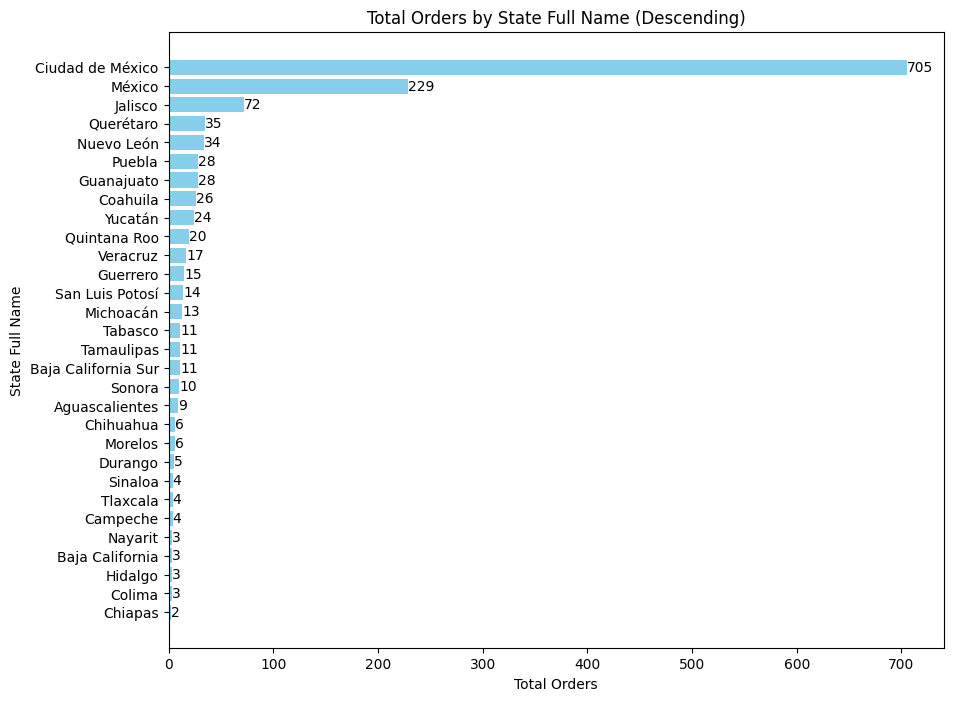

In [ ]:
# Filter the data for orders greater than or equal to 1
ordersGender3_df = df_cx[df_cx['Total Orders'] >= 1]

# Aggregate data by 'Default Address Province Code' and sum the total orders if necessary
province_order_counts = ordersGender3_df.groupby('State Full Name').agg({'Total Orders': 'sum'}).reset_index()

# Sort the data by 'Total Orders' in descending order
province_order_counts = province_order_counts.sort_values(by='Total Orders', ascending=False)

# Plotting function with descending order
def labeled_barplot(data, x_column, y_column):
    plt.figure(figsize=(10, 8))
    bars = plt.barh(data[x_column], data[y_column], color='skyblue')
    plt.xlabel('Total Orders')
    plt.ylabel('State Full Name')
    plt.title(f'Total Orders by State Full Name (Descending)')
    plt.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top

    # Add labels on the bars
    for bar in bars:
        plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{int(bar.get_width())}',
                 va='center', ha='left', color='black')

    plt.show()

# Plot the data with the updated function
labeled_barplot(province_order_counts, 'State Full Name', 'Total Orders')


###**Default Address Country Code**

In [ ]:
def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    Parameters:
    - data: DataFrame
    - feature: DataFrame column
    - perc: Whether to display percentages instead of count (default is False)
    - n: Displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # Total number of occurrences
    count = data[feature].nunique()  # Number of unique categories

    if n is None:
        n = count  # Default to show all categories if n is not specified
    order = data[feature].value_counts(ascending=False).index[:n]  # Top n categories

    fig, ax = plt.subplots(figsize=(max(n*1.5, 10), 8))  # Adjust figure size based on n
    sns.countplot(data=data, x=feature, palette="Paired", order=order, ax=ax)  # Plot

    for p in ax.patches:
        height = p.get_height()
        label = "{:.1f}%".format(100 * height / total) if perc else int(height)
        x = p.get_x() + p.get_width() / 2
        y = height + 0.01  # Slight offset above the bar

        ax.annotate(label, (x, y), ha='center', va='bottom', fontsize=12, color='black')

    plt.xticks(rotation=90, fontsize=15)
    plt.title(f'Distribution of {feature}')  # Optional title
    plt.show()

<ipython-input-888-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




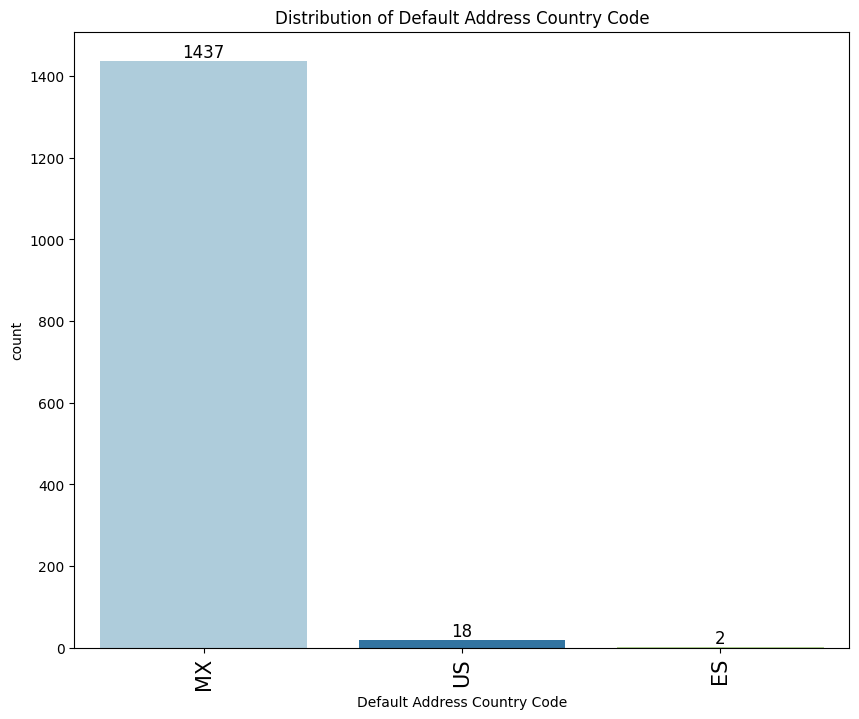

In [ ]:
labeled_barplot(df_cx, 'Default Address Country Code')

### **Default Address City**

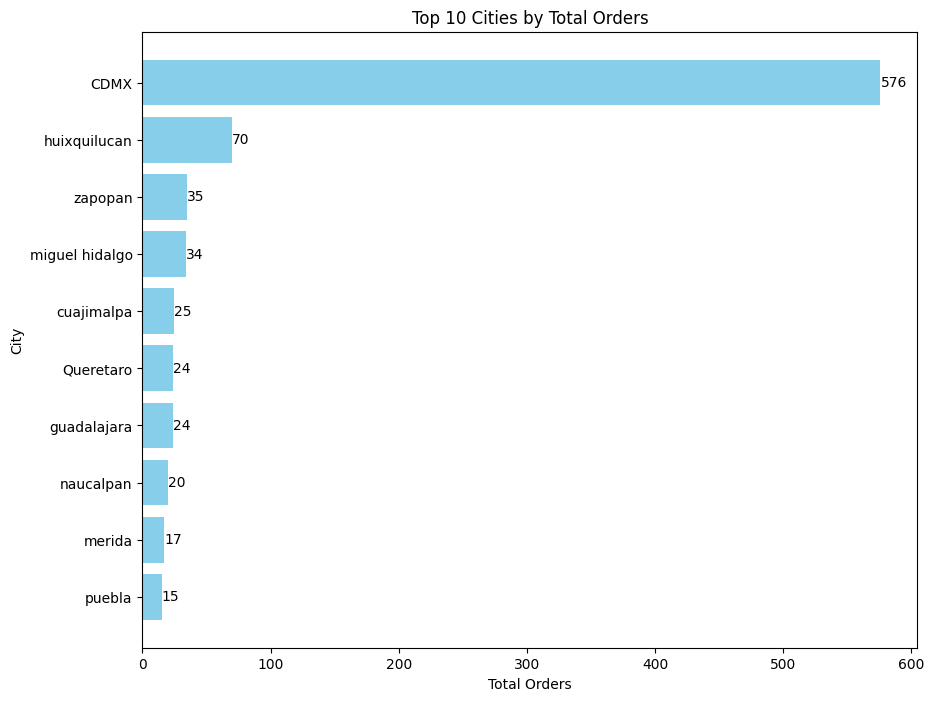

In [ ]:
# Example mapping for common city names
city_mapping = {
    "cdmx": "CDMX",
    "ciudad de méxico": "CDMX",
    "ciudad de mexico": "CDMX",
    "méxico": "CDMX",
    "mexico": "CDMX",
    "mexico city": "CDMX",
    "queretaro": "Queretaro",
}

city_order_counts = df_cx.groupby('Default Address City').agg({'Total Orders': 'sum'}).reset_index()

# Normalize the city names using your mapping
city_order_counts['Default Address City'] = city_order_counts['Default Address City'].str.lower()
city_order_counts['Default Address City'] = city_order_counts['Default Address City'].replace(city_mapping)

# Re-aggregate after normalization
city_order_counts = city_order_counts.groupby('Default Address City').agg({'Total Orders': 'sum'}).reset_index()

# Sort and take the top 10
top_10_cities = city_order_counts.sort_values(by='Total Orders', ascending=False).head(10)

# Plotting function with order labels
def labeled_barplot(data, x_column, y_column):
    plt.figure(figsize=(10, 8))
    bars = plt.barh(data[x_column], data[y_column], color='skyblue')
    plt.xlabel('Total Orders')
    plt.ylabel('City')
    plt.title(f'Top 10 Cities by {y_column}')
    plt.gca().invert_yaxis()  # Invert y-axis to show the highest count at the top

    # Add labels on the bars
    for bar in bars:
        plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{int(bar.get_width())}',
                 va='center', ha='left', color='black')

    plt.show()

# Plot the top 10 cities by total orders
labeled_barplot(top_10_cities, 'Default Address City', 'Total Orders')


# **8. Checkout data**

#### Import and drop useless columns

In [ ]:
df_checkouts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199 entries, 0 to 198
Data columns (total 70 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Name                         199 non-null    object 
 1   Email                        199 non-null    object 
 2   Financial Status             0 non-null      float64
 3   Paid at                      0 non-null      float64
 4   Fulfillment Status           81 non-null     object 
 5   Fulfilled at                 0 non-null      float64
 6   Accepts Marketing            81 non-null     object 
 7   Currency                     81 non-null     object 
 8   Subtotal                     81 non-null     float64
 9   Shipping                     81 non-null     float64
 10  Taxes                        81 non-null     float64
 11  Total                        81 non-null     float64
 12  Discount Code                8 non-null      object 
 13  Discount Amount     

In [ ]:
#Drop useless columns
df_checkouts.drop(columns=['Tax 1 Name'], inplace=True)
df_checkouts.drop(columns=['Tax 1 Value'], inplace=True)
df_checkouts.drop(columns=['Tax 2 Name'], inplace=True)
df_checkouts.drop(columns=['Tax 2 Value'], inplace=True)
df_checkouts.drop(columns=['Tax 3 Name'], inplace=True)
df_checkouts.drop(columns=['Tax 3 Value'], inplace=True)
df_checkouts.drop(columns=['Tax 4 Name'], inplace=True)
df_checkouts.drop(columns=['Tax 4 Value'], inplace=True)
df_checkouts.drop(columns=['Tax 5 Name'], inplace=True)
df_checkouts.drop(columns=['Tax 5 Value'], inplace=True)
df_checkouts.drop(columns=['Phone'], inplace=True)
df_checkouts.drop(columns=['Receipt Number'], inplace=True)

# Now when you call df_orders.head(), it will display all columns
df_checkouts.head(5)

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name
0,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,unfulfilled,NaN,yes,MXN,1273.5,0.0,0.0,1422.5,NaN,1273.5,NaN,2024-08-09 13:11:07 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991,True,True,pending,Maggie Parra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,3.573688e+13,NaN,Low,web,424.5,NaN,NaN
1,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:11:07 -0600,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7506382420915,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN
2,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:11:07 -0600,1,Red Sharks Niño - 7-8A,849.0,NaN,7506382401709,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN
3,#35736860459260,maggie_parra@hotmail.com,NaN,NaN,unfulfilled,NaN,yes,MXN,1698.0,0.0,0.0,1847.0,NaN,1698.0,NaN,2024-08-09 13:05:23 -0600,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991,True,True,pending,Maggie Parra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,3.573686e+13,NaN,Low,web,424.5,NaN,NaN
4,#35736860459260,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 13:05:23 -0600,1,Tiburones - 7-8A,849.0,NaN,7506382403451,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN


#### **Customers with the most dropped from cart actions**


In [ ]:
df_checkouts['Email'].value_counts()

,count
Email,
magaliruizmarch@hotmail.com,13
ttinasb89@gmail.com,11
maggie_parra@hotmail.com,10
anlali@yahoo.com,10
luca_simon@hotmail.com,7
mafer42@yahoo.com,6
paco.moralesmtz18@gmail.com,6
alexis.corella@gmail.com,6
espinosa.mariana@gmail.com,5


In [ ]:
def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    Parameters:
    - data: DataFrame
    - feature: DataFrame column
    - perc: Whether to display percentages instead of count (default is False)
    - n: Displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # Total number of occurrences
    count = data[feature].nunique()  # Number of unique categories

    if n is None:
        n = count  # Default to show all categories if n is not specified
    order = data[feature].value_counts(ascending=False).index[:n]  # Top n categories

    fig, ax = plt.subplots(figsize=(max(n*1.5, 10), 8))  # Adjust figure size based on n
    sns.countplot(data=data, x=feature, palette="Paired", order=order, ax=ax)  # Plot

    for p in ax.patches:
        height = p.get_height()
        label = "{:.1f}%".format(100 * height / total) if perc else int(height)
        x = p.get_x() + p.get_width() / 2
        y = height + 0.01  # Slight offset above the bar

        ax.annotate(label, (x, y), ha='center', va='bottom', fontsize=12, color='black')

    plt.xticks(rotation=90, fontsize=15)
    plt.title(f'Distribution of {feature}')  # Optional title
    plt.show()

#### **Counts of items dropped from shopping cart**

<ipython-input-895-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




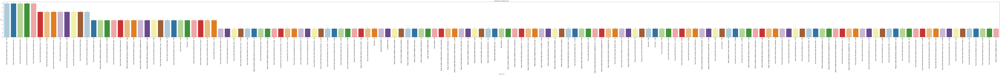

In [ ]:
labeled_barplot(df_checkouts,'Lineitem name')

#### **Top 10 items count dropped from cart**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




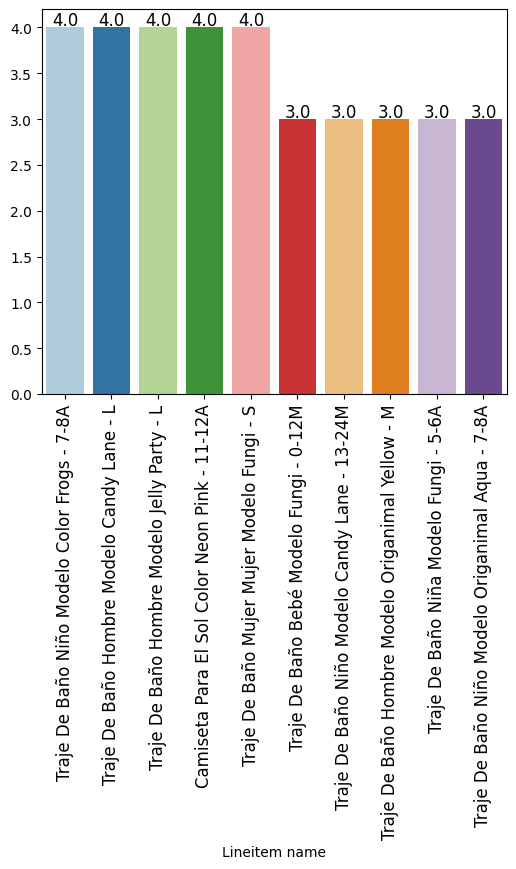

In [ ]:
labeled_barplot_top10(df_checkouts,'Lineitem name')

#### **Top 10 customers with the most dropped orders from cart**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




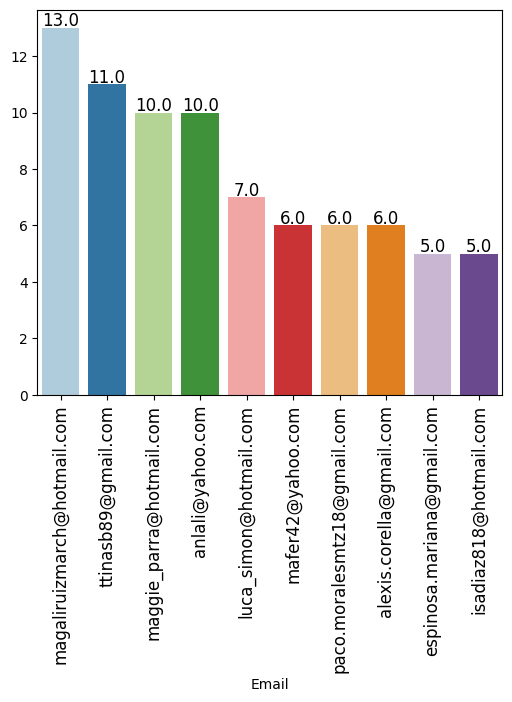

In [ ]:
labeled_barplot_top10(df_checkouts,'Email')

#### Date & Time of Checkout

In [ ]:
# Check the data type of the 'Paid at' column
print(df_checkouts['Created at'].dtype)


object


**Observation:** The column 'Paid at' is currently an object, in order for future analysis, this needs to be converted to a date-time data type.


In [ ]:
# Check the data type of the 'Paid at' column
print(df_checkouts['Created at'].dtype)

# Convert 'Paid at' to datetime with UTC
df_checkouts['Created at'] = pd.to_datetime(df_checkouts['Created at'], utc=True)

# Check the data type again to confirm
print(df_checkouts['Created at'].dtype)



object
datetime64[ns, UTC]


**Observation:** The 'Paid at' column is now in a datetime format

In [ ]:
# Extract year and month from the 'Paid at' column
df_checkouts['Year'] = df_checkouts['Created at'].dt.year
df_checkouts['Month'] = df_checkouts['Created at'].dt.month


In [ ]:
checkouts_by_year = df_checkouts.groupby('Year').size().reset_index(name='Order Count')
checkouts_by_year

,Year,Order Count
0,2022,27
1,2023,6
2,2024,166


####**Top items abandoned from cart without size**

In [ ]:
# List of columns to include in the Product DataFrame
columns_to_include = ['Name', 'Paid at', 'Lineitem quantity', 'Lineitem name', 'Lineitem price', 'Lineitem compare at price', 'Lineitem sku', 'Shipping City', 'Shipping Zip', 'Shipping Province', 'Payment Method','Year']

# Create the new DataFrame with the specified columns
products_data2 = df_checkouts[columns_to_include].copy()

# Convert the 'Lineitem sku' column to object (string) type
products_data2['Lineitem sku'] = products_data['Lineitem sku'].astype('object')


# Display the new DataFrame
products_data2.head()

,Name,Paid at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Shipping City,Shipping Zip,Shipping Province,Payment Method,Year
0,#35736882774268,NaN,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420359.0,NaN,NaN,NaN,NaN,2024
1,#35736882774268,NaN,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7506382411579.0,NaN,NaN,NaN,NaN,2024
2,#35736882774268,NaN,1,Red Sharks Niño - 7-8A,849.0,NaN,7506382412118.0,NaN,NaN,NaN,NaN,2024
3,#35736860459260,NaN,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991.0,NaN,NaN,NaN,NaN,2024
4,#35736860459260,NaN,1,Tiburones - 7-8A,849.0,NaN,7506382420915.0,NaN,NaN,NaN,NaN,2024


In [ ]:
# Define a function to clean the lineitem names
def clean_lineitem_name(name):
    return name.split('-')[0].strip()

# Apply the function to clean the 'Lineitem name' column
products_data2['Clean Lineitem name'] = products_data2['Lineitem name'].apply(clean_lineitem_name)

# Display the cleaned column
products_data2[['Lineitem name', 'Clean Lineitem name']].head()

,Lineitem name,Clean Lineitem name
0,Traje De Baño Niño Modelo Color Frogs - 7-8A,Traje De Baño Niño Modelo Color Frogs
1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,Traje De Baño Niño Modelo Origanimal Aqua
2,Red Sharks Niño - 7-8A,Red Sharks Niño
3,Traje De Baño Niño Modelo Color Frogs - 7-8A,Traje De Baño Niño Modelo Color Frogs
4,Tiburones - 7-8A,Tiburones


####**2022**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




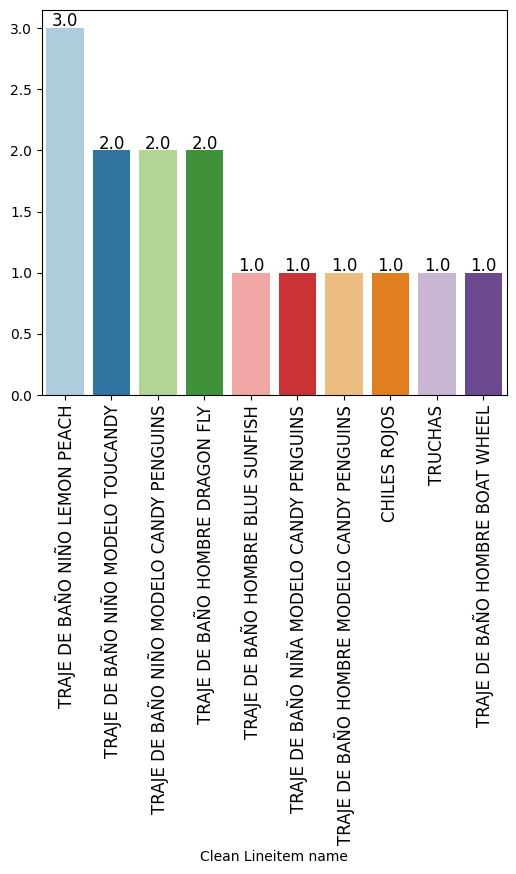

In [ ]:
df_grouped2022 = products_data2[products_data2['Year'] == 2022]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2022.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

#### **2023**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




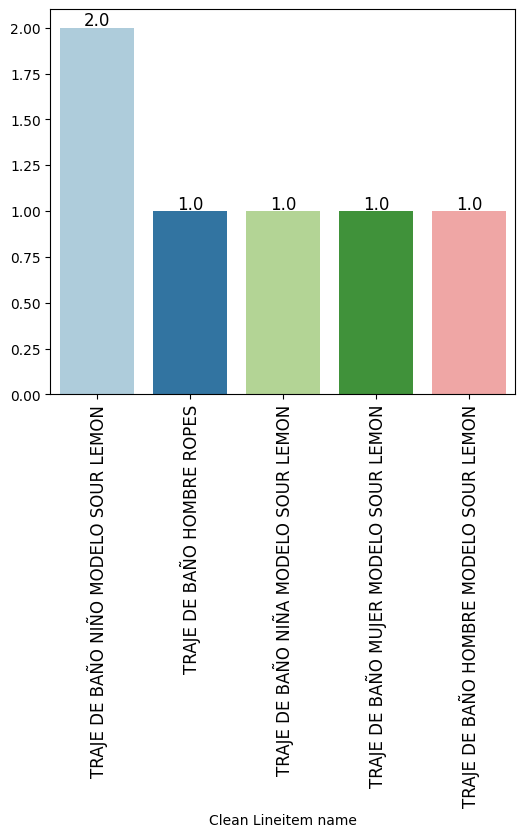

In [ ]:
df_grouped2023 = products_data2[products_data2['Year'] == 2023]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2023.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

#### **2024**

<ipython-input-518-00dd2ec0a429>:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




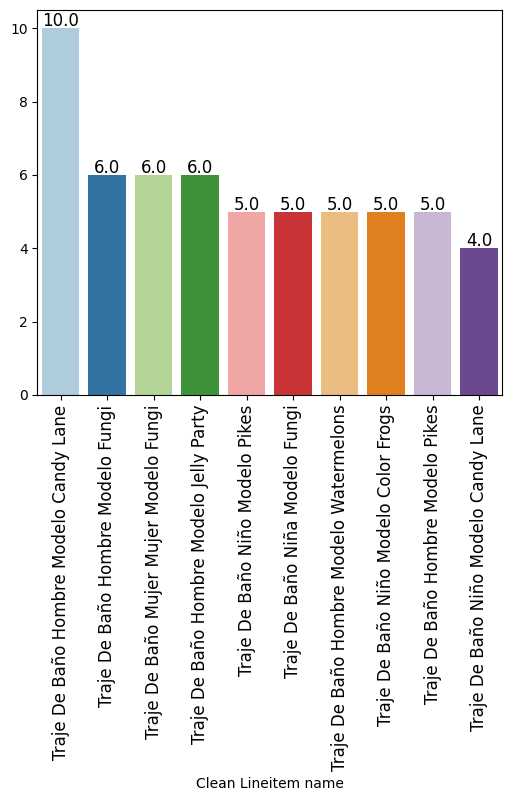

In [ ]:
df_grouped2024 = products_data2[products_data2['Year'] == 2024]

# Explode the list values in the 'lineitem name' column before passing it to the function
products_data_exploded = df_grouped2024.explode('Clean Lineitem name')

labeled_barplot_top10(products_data_exploded, 'Clean Lineitem name')

#### **Abandoned carts by gender**

In [ ]:
# Merge the datasets df_cx and df_checkouts so we can have the gender acording to the email
df_checkouts = df_checkouts.merge(df_cx[['Email', 'Gender']], on='Email', how='left')

In [ ]:
df_checkouts.head()

,Name,Email,Financial Status,Paid at,Fulfillment Status,Fulfilled at,Accepts Marketing,Currency,Subtotal,Shipping,Taxes,Total,Discount Code,Discount Amount,Shipping Method,Created at,Lineitem quantity,Lineitem name,Lineitem price,Lineitem compare at price,Lineitem sku,Lineitem requires shipping,Lineitem taxable,Lineitem fulfillment status,Billing Name,Billing Street,Billing Address1,Billing Address2,Billing Company,Billing City,Billing Zip,Billing Province,Billing Country,Billing Phone,Shipping Name,Shipping Street,Shipping Address1,Shipping Address2,Shipping Company,Shipping City,Shipping Zip,Shipping Province,Shipping Country,Shipping Phone,Notes,Note Attributes,Cancelled at,Payment Method,Payment Reference,Refunded Amount,Vendor,Id,Tags,Risk Level,Source,Lineitem discount,Billing Province Name,Shipping Province Name,Year,Month,Gender
0,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,unfulfilled,NaN,yes,MXN,1273.5,0.0,0.0,1422.5,NaN,1273.5,NaN,2024-08-09 19:11:07+00:00,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991,True,True,pending,Maggie Parra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,3.573688e+13,NaN,Low,web,424.5,NaN,NaN,2024,8,female
1,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 19:11:07+00:00,1,Traje De Baño Niño Modelo Origanimal Aqua - 7-8A,849.0,NaN,7506382420915,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN,2024,8,female
2,#35736882774268,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 19:11:07+00:00,1,Red Sharks Niño - 7-8A,849.0,NaN,7506382401709,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN,2024,8,female
3,#35736860459260,maggie_parra@hotmail.com,NaN,NaN,unfulfilled,NaN,yes,MXN,1698.0,0.0,0.0,1847.0,NaN,1698.0,NaN,2024-08-09 19:05:23+00:00,1,Traje De Baño Niño Modelo Color Frogs - 7-8A,849.0,NaN,7506382420991,True,True,pending,Maggie Parra,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,3.573686e+13,NaN,Low,web,424.5,NaN,NaN,2024,8,female
4,#35736860459260,maggie_parra@hotmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2024-08-09 19:05:23+00:00,1,Tiburones - 7-8A,849.0,NaN,7506382403451,True,True,pending,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TINTARELLA SWIMWEAR & CO,NaN,NaN,NaN,NaN,424.5,NaN,NaN,2024,8,female


<ipython-input-895-655c86677b22>:20: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




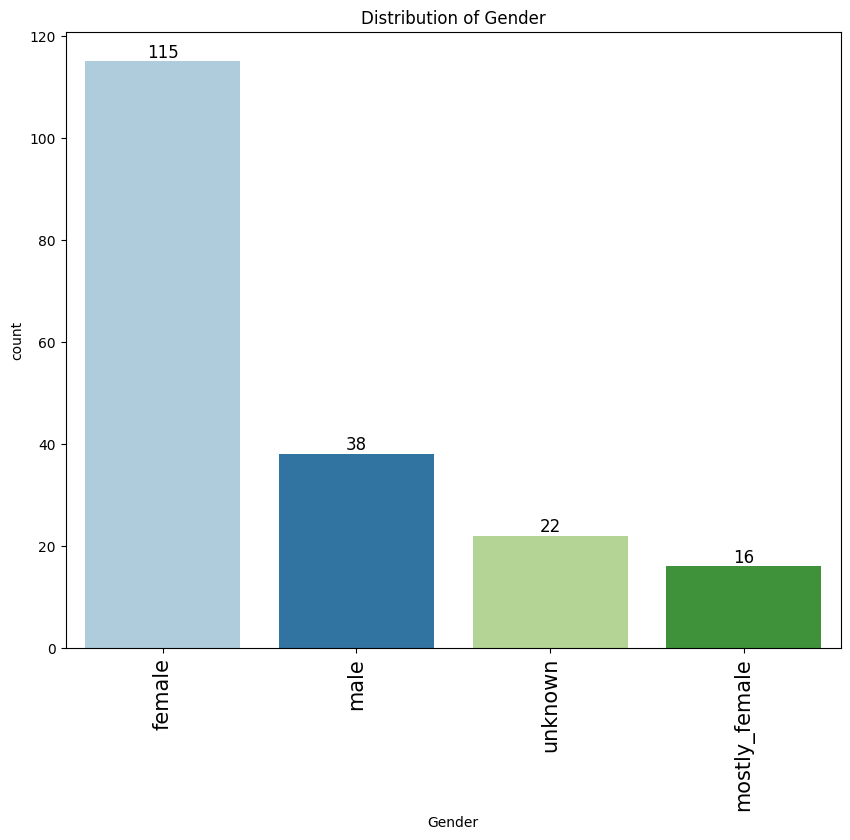

In [ ]:
labeled_barplot(df_checkouts,'Gender')